In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer, make_column_transformer
#from sklearn.preprocessing import OrdinalEncoder, StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
import time


sns.set_theme(style="darkgrid")
plt.rcParams['figure.figsize'] = [12,6]

import warnings
warnings.filterwarnings('ignore')

# **Load data**

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/Customer/churn.csv", index_col=0)

data.head(5)

,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,medium_of_operation,...,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
0,18,F,XW0DQ7H,Village,Platinum Membership,2017-08-17,No,xxxxxxxx,Gift Vouchers/Coupons,?,...,300.63,53005.25,17.0,781.75,Yes,Yes,No,Not Applicable,Products always in Stock,0
1,32,F,5K0N3X1,City,Premium Membership,2017-08-28,?,CID21329,Gift Vouchers/Coupons,Desktop,...,306.34,12838.38,10.0,NaN,Yes,No,Yes,Solved,Quality Customer Care,0
2,44,F,1F2TCL3,Town,No Membership,2016-11-11,Yes,CID12313,Gift Vouchers/Coupons,Desktop,...,516.16,21027.00,22.0,500.69,No,Yes,Yes,Solved in Follow-up,Poor Website,1
3,37,M,VJGJ33N,City,No Membership,2016-10-29,Yes,CID3793,Gift Vouchers/Coupons,Desktop,...,53.27,25239.56,6.0,567.66,No,Yes,Yes,Unsolved,Poor Website,1
4,31,F,SVZXCWB,City,No Membership,2017-09-12,No,xxxxxxxx,Credit/Debit Card Offers,Smartphone,...,113.13,24483.66,16.0,663.06,No,Yes,Yes,Solved,Poor Website,1


In [ ]:
data.iloc[:, :8].head(5)

,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id
0,18,F,XW0DQ7H,Village,Platinum Membership,2017-08-17,No,xxxxxxxx
1,32,F,5K0N3X1,City,Premium Membership,2017-08-28,?,CID21329
2,44,F,1F2TCL3,Town,No Membership,2016-11-11,Yes,CID12313
3,37,M,VJGJ33N,City,No Membership,2016-10-29,Yes,CID3793
4,31,F,SVZXCWB,City,No Membership,2017-09-12,No,xxxxxxxx


In [ ]:
data.iloc[:, 8:16].head(5)

,preferred_offer_types,medium_of_operation,internet_option,last_visit_time,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days
0,Gift Vouchers/Coupons,?,Wi-Fi,16:08:02,17,300.63,53005.25,17.0
1,Gift Vouchers/Coupons,Desktop,Mobile_Data,12:38:13,16,306.34,12838.38,10.0
2,Gift Vouchers/Coupons,Desktop,Wi-Fi,22:53:21,14,516.16,21027.00,22.0
3,Gift Vouchers/Coupons,Desktop,Mobile_Data,15:57:50,11,53.27,25239.56,6.0
4,Credit/Debit Card Offers,Smartphone,Mobile_Data,15:46:44,20,113.13,24483.66,16.0


In [ ]:
data.iloc[:, 16:].head(5)

,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
0,781.75,Yes,Yes,No,Not Applicable,Products always in Stock,0
1,NaN,Yes,No,Yes,Solved,Quality Customer Care,0
2,500.69,No,Yes,Yes,Solved in Follow-up,Poor Website,1
3,567.66,No,Yes,Yes,Unsolved,Poor Website,1
4,663.06,No,Yes,Yes,Solved,Poor Website,1


In [ ]:
print(f'There are {data.shape[0]} data points and {data.shape[1]} features in the dataset')

There are 36992 data points and 23 features in the dataset


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36992 entries, 0 to 36991
Data columns (total 23 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   age                           36992 non-null  int64  
 1   gender                        36992 non-null  object 
 2   security_no                   36992 non-null  object 
 3   region_category               31564 non-null  object 
 4   membership_category           36992 non-null  object 
 5   joining_date                  36992 non-null  object 
 6   joined_through_referral       36992 non-null  object 
 7   referral_id                   36992 non-null  object 
 8   preferred_offer_types         36704 non-null  object 
 9   medium_of_operation           36992 non-null  object 
 10  internet_option               36992 non-null  object 
 11  last_visit_time               36992 non-null  object 
 12  days_since_last_login         36992 non-null  int64  
 13  a

 avg_frequency_login_days      36992 non-null  object  ต้องทำการแปลงข้อมูลนี้

In [ ]:
data.dtypes

age                               int64
gender                           object
security_no                      object
region_category                  object
membership_category              object
joining_date                     object
joined_through_referral          object
referral_id                      object
preferred_offer_types            object
medium_of_operation              object
internet_option                  object
last_visit_time                  object
days_since_last_login             int64
avg_time_spent                  float64
avg_transaction_value           float64
avg_frequency_login_days         object
points_in_wallet                float64
used_special_discount            object
offer_application_preference     object
past_complaint                   object
complaint_status                 object
feedback                         object
churn_risk_score                  int64
dtype: object

#Exploratory Data Analysis

In [ ]:
#เลือกดูข้อมูลที่เป็น number
data.select_dtypes(include=[np.number]).head()

,age,days_since_last_login,avg_time_spent,avg_transaction_value,points_in_wallet,churn_risk_score
0,18,17,300.63,53005.25,781.75,0
1,32,16,306.34,12838.38,NaN,0
2,44,14,516.16,21027.00,500.69,1
3,37,11,53.27,25239.56,567.66,1
4,31,20,113.13,24483.66,663.06,1


In [ ]:
data.select_dtypes(include=['object']).head()
#เลือกดูข้อมูลที่เป็น object

,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,medium_of_operation,internet_option,last_visit_time,avg_frequency_login_days,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback
0,F,XW0DQ7H,Village,Platinum Membership,2017-08-17,No,xxxxxxxx,Gift Vouchers/Coupons,?,Wi-Fi,16:08:02,17.0,Yes,Yes,No,Not Applicable,Products always in Stock
1,F,5K0N3X1,City,Premium Membership,2017-08-28,?,CID21329,Gift Vouchers/Coupons,Desktop,Mobile_Data,12:38:13,10.0,Yes,No,Yes,Solved,Quality Customer Care
2,F,1F2TCL3,Town,No Membership,2016-11-11,Yes,CID12313,Gift Vouchers/Coupons,Desktop,Wi-Fi,22:53:21,22.0,No,Yes,Yes,Solved in Follow-up,Poor Website
3,M,VJGJ33N,City,No Membership,2016-10-29,Yes,CID3793,Gift Vouchers/Coupons,Desktop,Mobile_Data,15:57:50,6.0,No,Yes,Yes,Unsolved,Poor Website
4,F,SVZXCWB,City,No Membership,2017-09-12,No,xxxxxxxx,Credit/Debit Card Offers,Smartphone,Mobile_Data,15:46:44,16.0,No,Yes,Yes,Solved,Poor Website


In [ ]:
data.describe(include=np.number)

,age,days_since_last_login,avg_time_spent,avg_transaction_value,points_in_wallet,churn_risk_score
count,36992.000000,36992.000000,36992.000000,36992.000000,33549.000000,36992.000000
mean,37.118161,-41.915576,243.472334,29271.194003,686.882199,0.540982
std,15.867412,228.819900,398.289149,19444.806226,194.063624,0.498324
min,10.000000,-999.000000,-2814.109110,800.460000,-760.661236,0.000000
25%,23.000000,8.000000,60.102500,14177.540000,616.150000,0.000000
50%,37.000000,12.000000,161.765000,27554.485000,697.620000,1.000000
75%,51.000000,16.000000,356.515000,40855.110000,763.950000,1.000000
max,64.000000,26.000000,3235.578521,99914.050000,2069.069761,1.000000


In [ ]:
data.describe(include='object')

,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,medium_of_operation,internet_option,last_visit_time,avg_frequency_login_days,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback
count,36992,36992,31564,36992,36992,36992,36992,36704,36992,36992,36992,36992,36992,36992,36992,36992,36992
unique,3,36992,3,6,1096,3,11359,3,4,3,30101,1654,2,2,2,5,9
top,F,XW0DQ7H,Town,Basic Membership,2015-06-02,No,xxxxxxxx,Gift Vouchers/Coupons,Desktop,Wi-Fi,07:56:41,Error,Yes,Yes,No,Not Applicable,Poor Product Quality
freq,18490,1,14128,7724,55,15839,17846,12349,13913,12413,6,3522,20342,20440,18602,18602,6350


#ดูข้อมูลก่อนทำความสะอาด

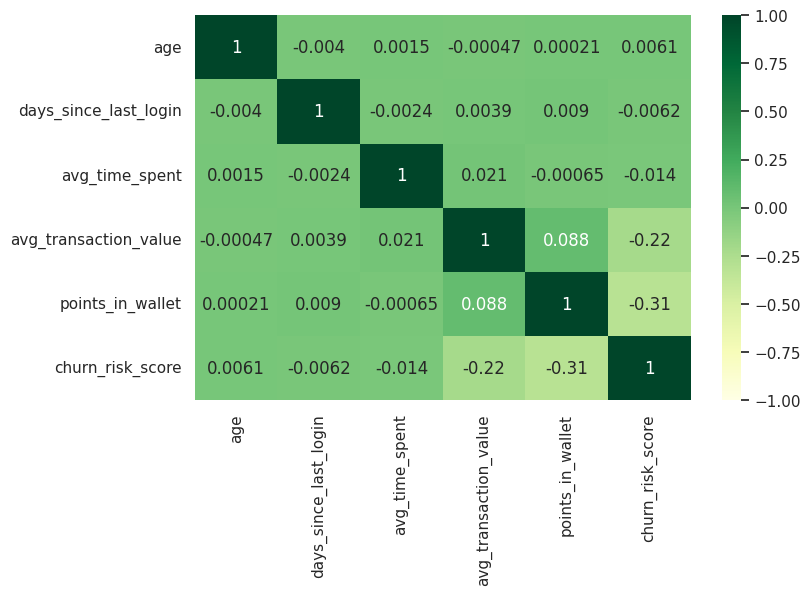

In [ ]:
plt.figure(figsize=(8,5))
sns.heatmap(data.corr(), vmax=1, vmin=-1,cmap='YlGn', annot=True)
plt.show()

#ไม่มีฟีเจอร์ไหนที่มีความสัมพันธ์กันสูง ที่ชัดเจน ซึ่งข้อมูลไม่มีความซ้ำซ้อน

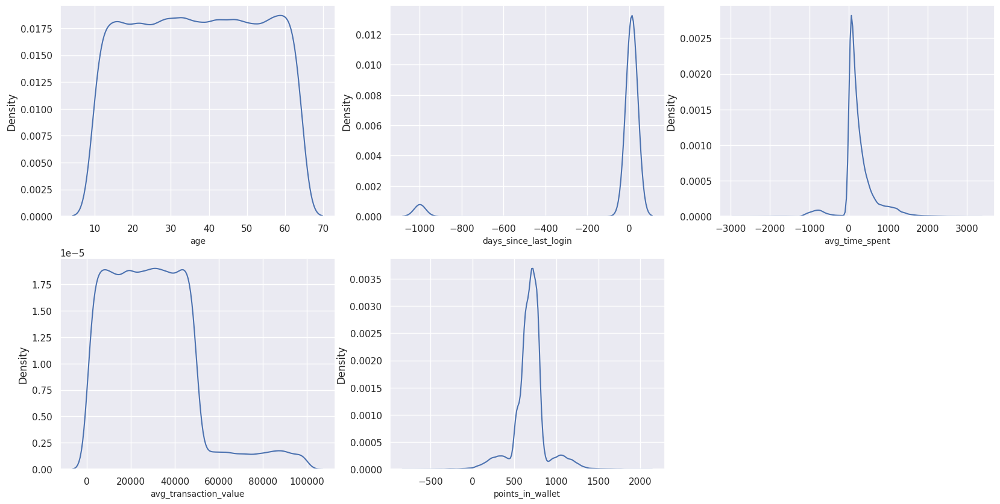

In [ ]:
data_num=data.drop('churn_risk_score', axis=1).select_dtypes(include=[np.number])
fig,ax= plt.subplots(nrows=2,ncols=3,figsize=(20,10))
for variable, subplot in zip(data_num.columns,ax.flatten()):
    z = sns.kdeplot(x = data_num[variable] , ax=subplot)
    z.set_xlabel(variable, fontsize = 10)

fig.delaxes(ax[1][2])
plt.show()

Plot ดูกราฟจากข้อมูลที่ยังไม่ได้ทำความสะอาด  

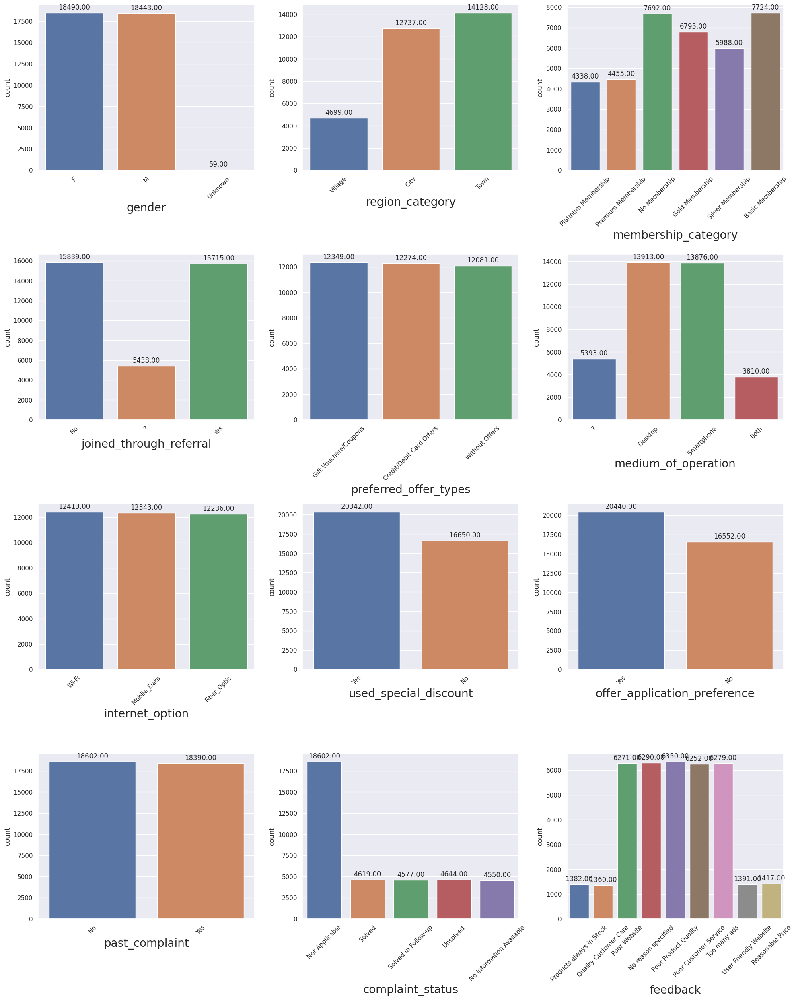

In [ ]:
data_cat = data.drop(['referral_id','last_visit_time','avg_frequency_login_days','security_no','joining_date'], axis=1).select_dtypes(include='object')
fig,ax= plt.subplots(nrows=4,ncols=3,figsize=(20, 25))
for variable, subplot in zip(data_cat.columns,ax.flatten()):
    z = sns.countplot(x = data_cat[variable],ax=subplot, )
    z.set_xlabel(variable, fontsize = 20)
    z.set_xticklabels(z.get_xticklabels(),rotation=45)
    for p in z.patches:
      z.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center',
           xytext = (0, 6), textcoords = 'offset points')

plt.tight_layout()

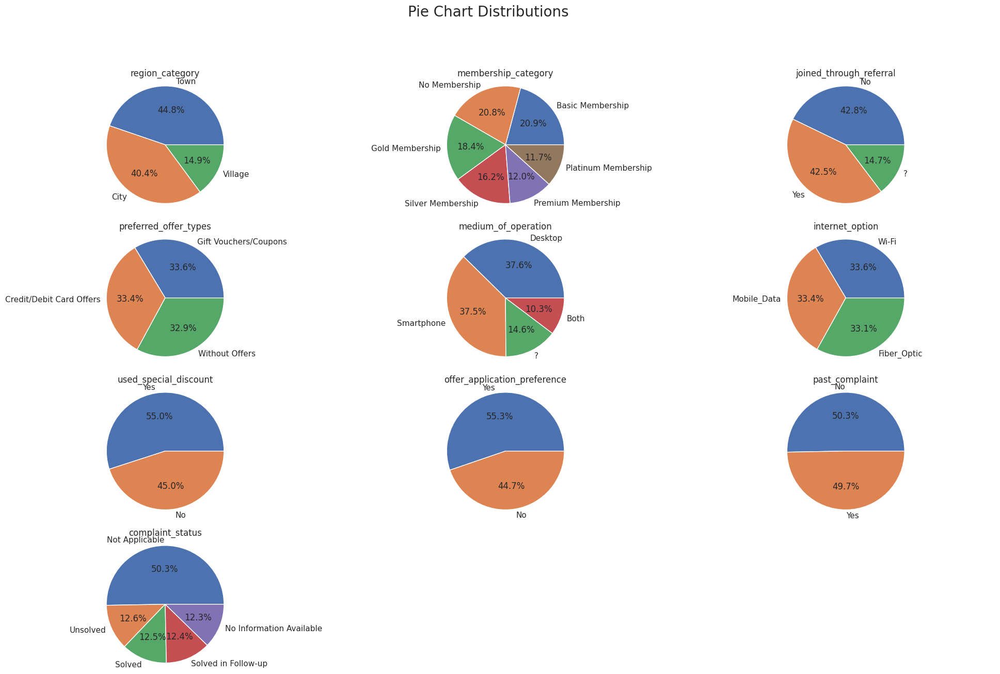

In [ ]:
## Pie Plots
data.columns
df2 = data.drop(['churn_risk_score', 'security_no', 'joining_date', 'gender',
                   'referral_id', 'age','churn_risk_score', 'last_visit_time',
                   'days_since_last_login', 'avg_time_spent','avg_transaction_value',
                   'avg_frequency_login_days', 'points_in_wallet','avg_transaction_value',
                   'feedback'], axis=1)
fig = plt.figure(figsize=(20, 20))
plt.suptitle('Pie Chart Distributions', fontsize=20)
for i in range(1, df2.shape[1] + 1):
    plt.subplot(6, 3, i)
    f = plt.gca()
    f.axes.get_yaxis().set_visible(False)
    f.set_title(df2.columns.values[i - 1])

    values = df2.iloc[:, i - 1].value_counts(normalize = True).values
    index = df2.iloc[:, i - 1].value_counts(normalize = True).index
    plt.pie(values, labels = index, autopct='%1.1f%%')
    plt.axis('equal')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

<Axes: xlabel='churn_risk_score', ylabel='count'>

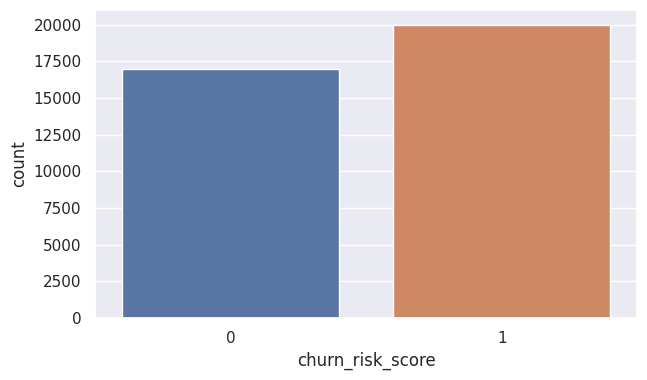

In [ ]:
plt.figure(figsize=(7,4))
#plt.title('Churn Count')
sns.countplot(x=data.churn_risk_score)

# ข้อมูล Target มีความ Imbalance เล็กน้อย

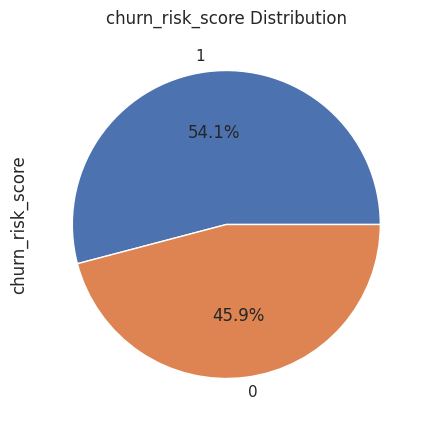

In [ ]:
plt.figure(figsize=(8,5))
data['churn_risk_score'].value_counts().plot.pie(autopct='%1.1f%%')
plt.title("churn_risk_score Distribution")
plt.show()

In [ ]:
def CountPlot(xcolumn, xlabel, rotationangle=0):

    """
    Function for plotting classes dsitribution againest the target feature
    """

    ax = sns.countplot(x = xcolumn,
                      hue = 'churn_risk_score',
                      data = data)

    for p in ax.patches:
        ax.annotate(format(p.get_height()), (p.get_x() + p.get_width() / 2. , p.get_height()), ha = 'center',xytext = (0, 8), textcoords = 'offset points')
   # plt.title(f"Churn rate by {xlabel}", fontsize=15)
    plt.xlabel(xlabel)
    plt.ylabel("Count")
    plt.xticks(rotation=rotationangle)
    plt.show()

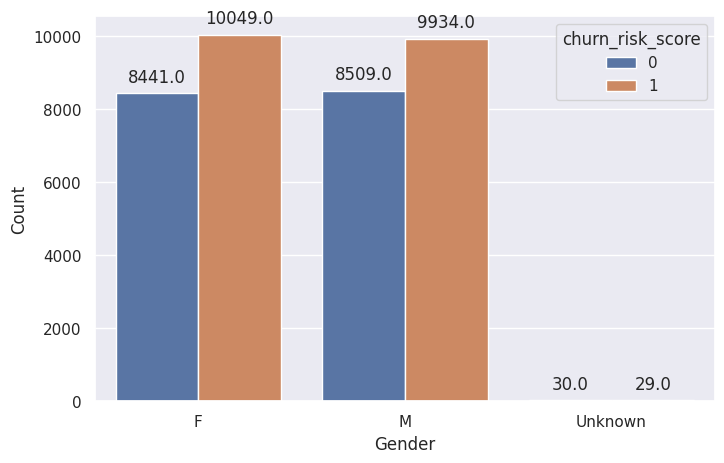

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("gender", "Gender")

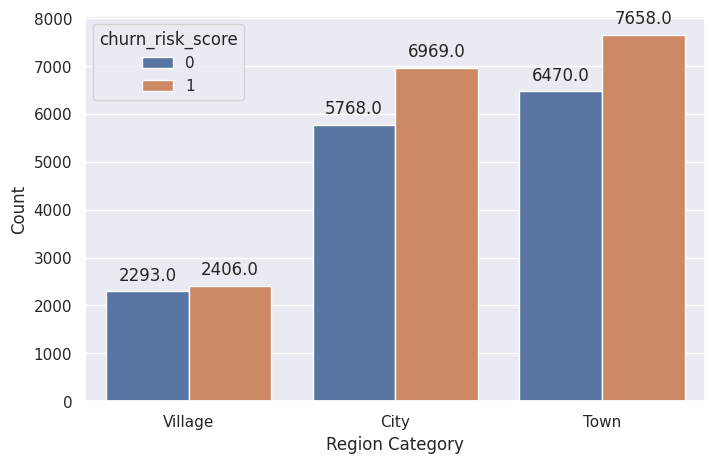

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("region_category", "Region Category")

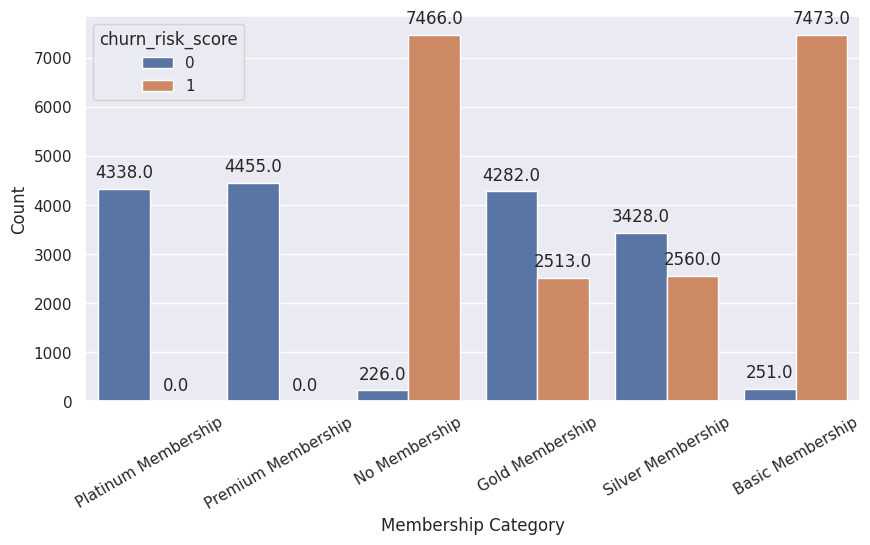

In [ ]:
plt.figure(figsize=(10,5))
CountPlot("membership_category", "Membership Category", 30)

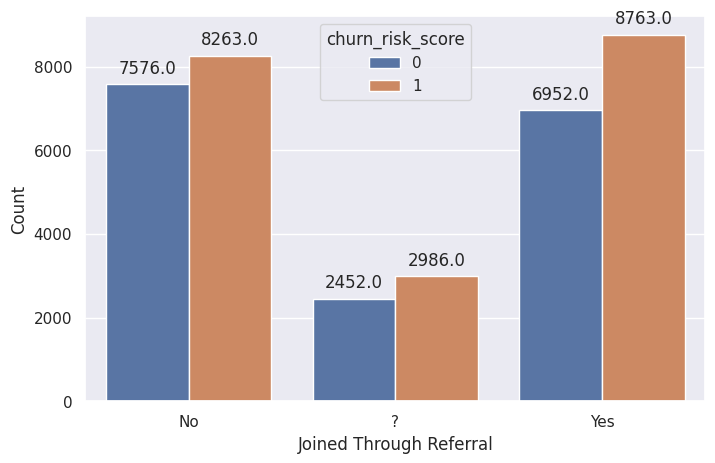

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("joined_through_referral", "Joined Through Referral")

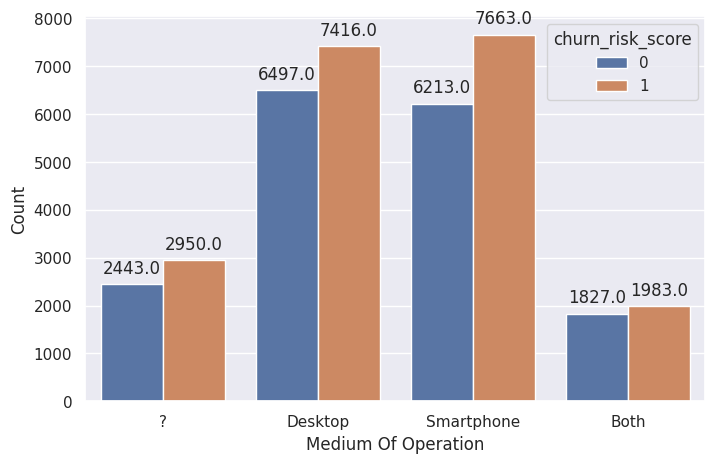

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("medium_of_operation", "Medium Of Operation")

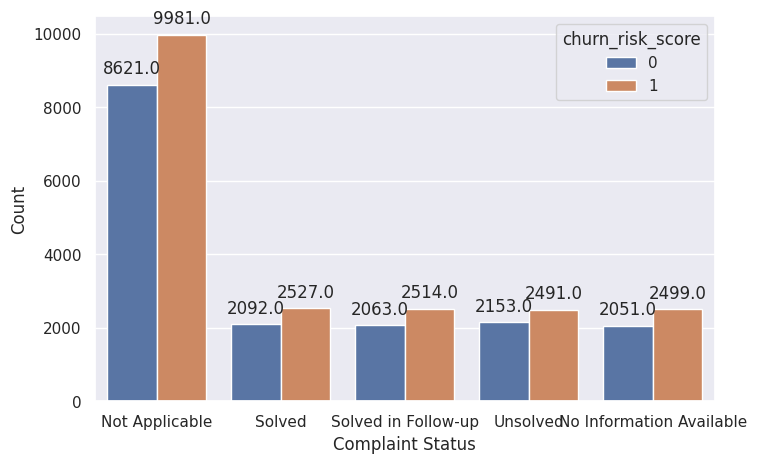

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("complaint_status", "Complaint Status")

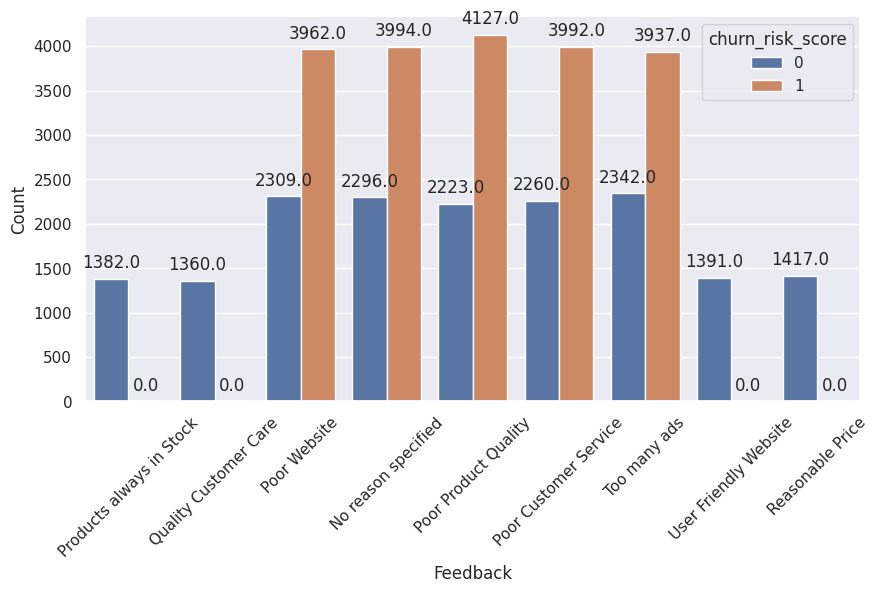

In [ ]:
plt.figure(figsize=(10,5))
CountPlot("feedback", "Feedback", 45)

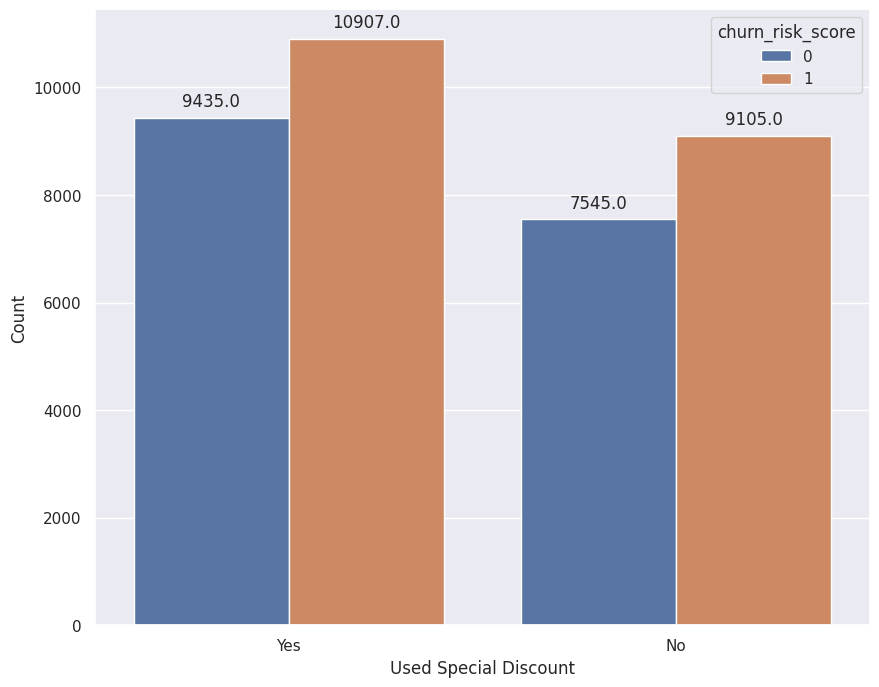

In [ ]:
plt.figure(figsize=(10,8))
CountPlot("used_special_discount", "Used Special Discount")

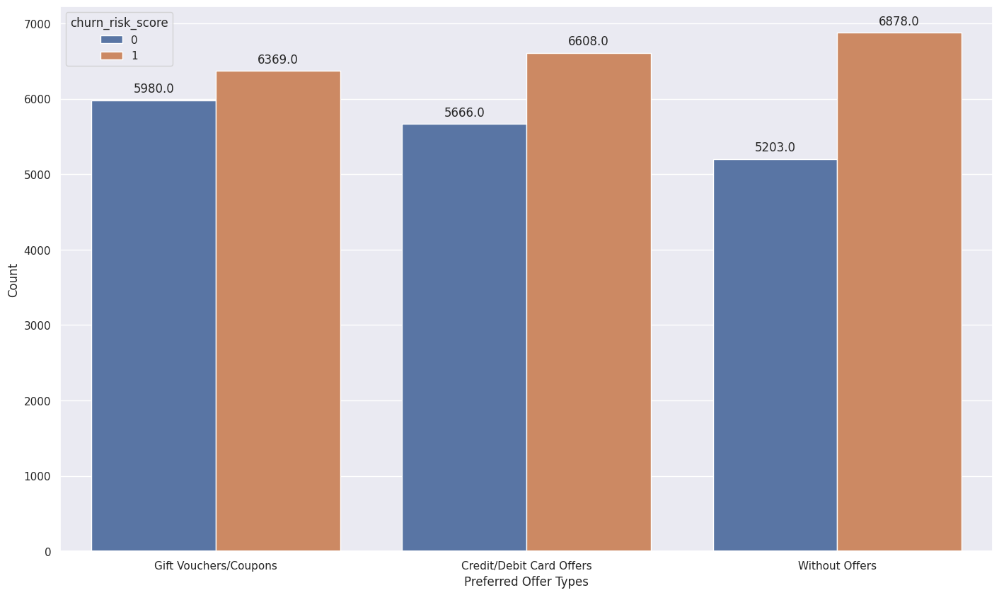

In [ ]:
plt.figure(figsize=(17,10))
CountPlot("preferred_offer_types", "Preferred Offer Types")

Text(0.5, 1.0, 'age distribution by churn_risk_score')

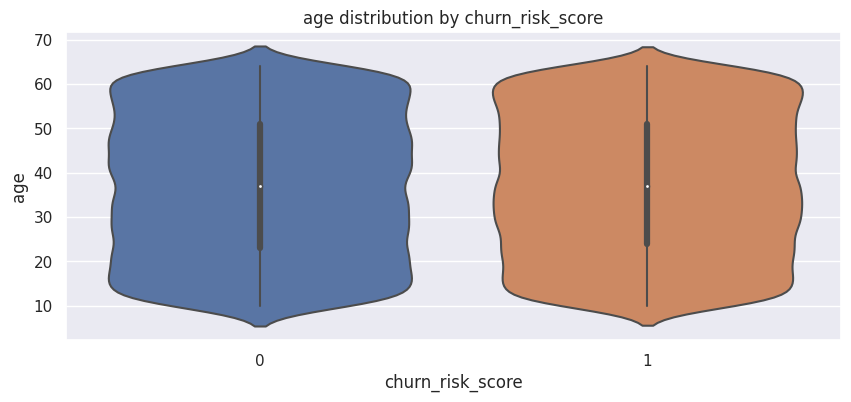

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='age', data=data)
plt.title('age distribution by churn_risk_score')

Text(0.5, 1.0, 'avg_transaction_value distribution by churn_risk_score')

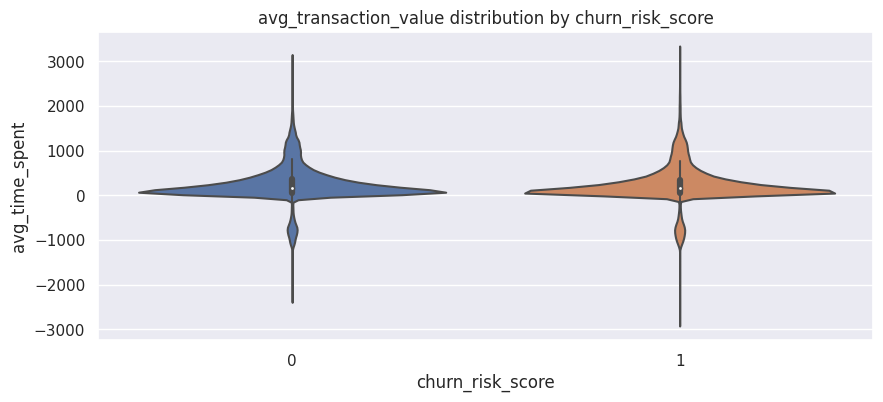

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='avg_time_spent', data=data)
plt.title('avg_transaction_value distribution by churn_risk_score')

Text(0.5, 1.0, 'avg_transaction_value distribution by churn_risk_score')

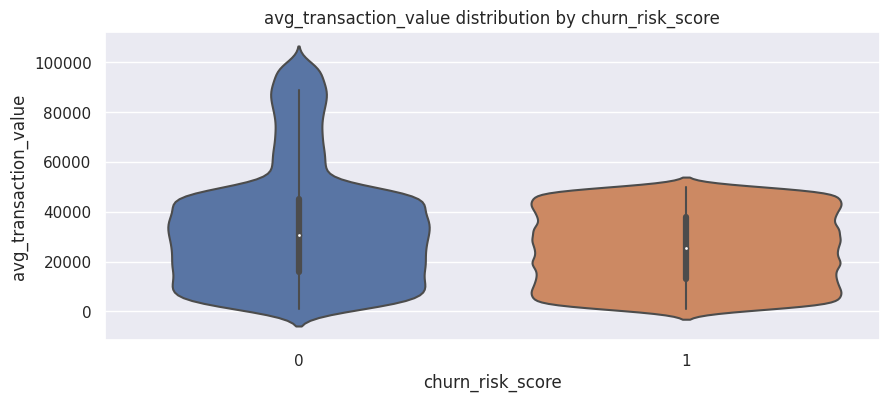

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='avg_transaction_value', data=data)
plt.title('avg_transaction_value distribution by churn_risk_score')

Text(0.5, 1.0, 'points_in_wallet distribution by churn_risk_score')

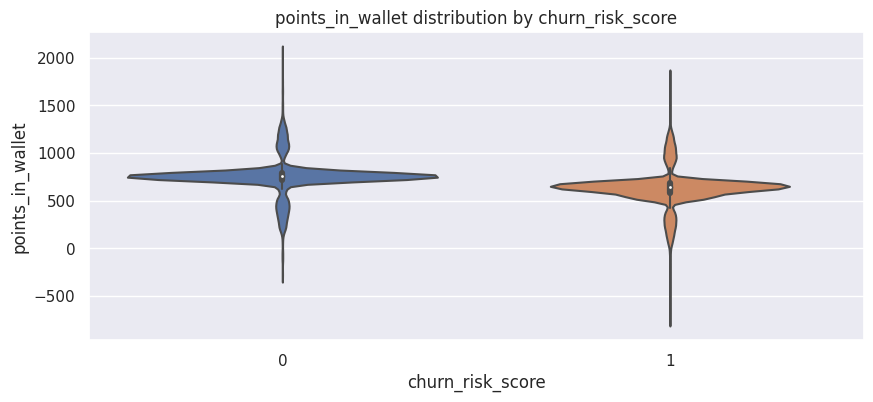

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='points_in_wallet', data=data)
plt.title('points_in_wallet distribution by churn_risk_score')

<Figure size 1000x400 with 0 Axes>

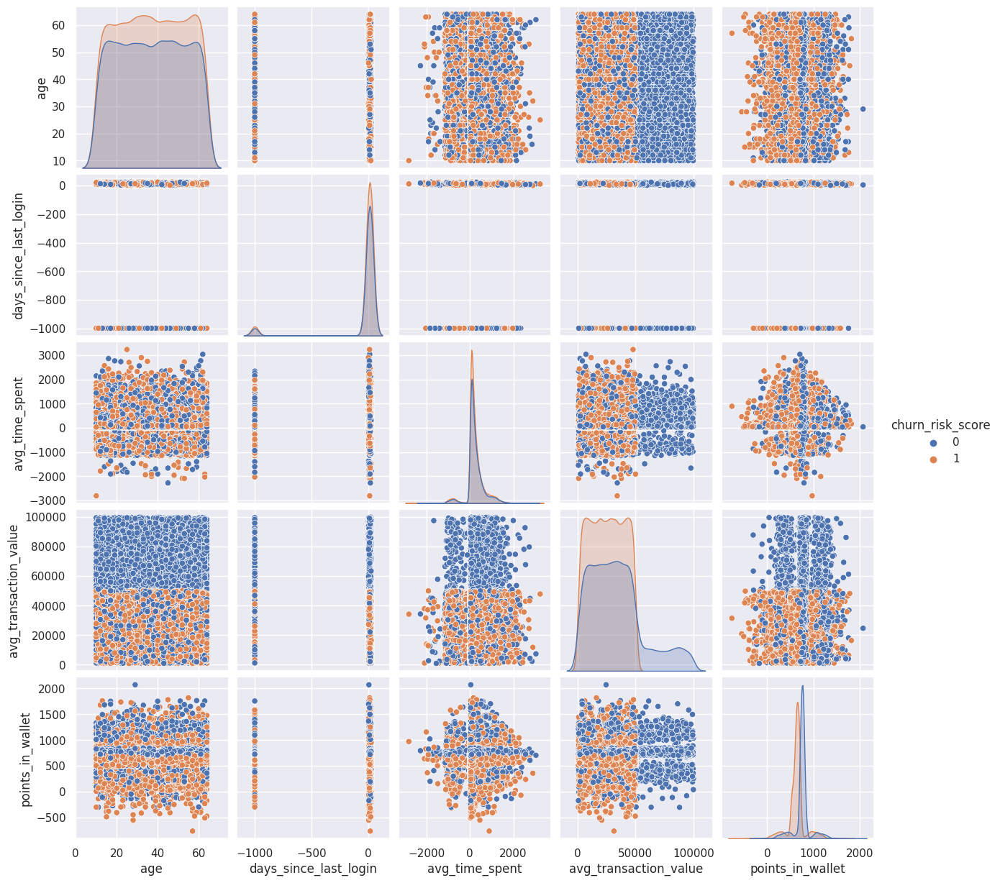

In [ ]:
plt.figure(figsize=(10,4))
data.reset_index(inplace=True)
sns.pairplot(data.drop('index', axis=1), hue='churn_risk_score')

In [ ]:
# Create two subsets of the data based on churn risk score values
subset_0 = data[data['churn_risk_score'] == 0]
subset_1 = data[data['churn_risk_score'] == 1]

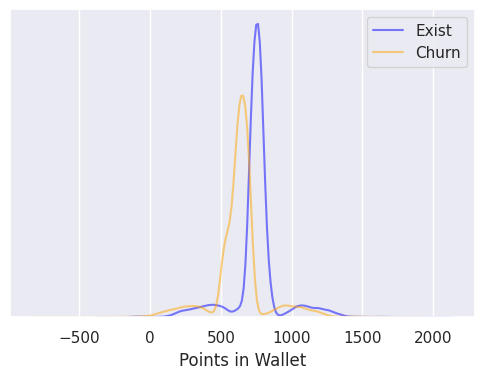

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['points_in_wallet'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['points_in_wallet'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('Points in Wallet')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

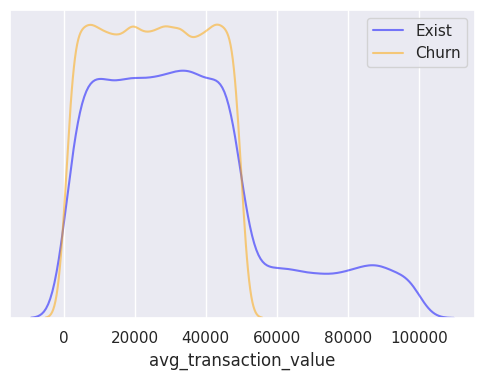

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['avg_transaction_value'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['avg_transaction_value'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('avg_transaction_value')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

In [ ]:
subset_0.describe()

,index,age,days_since_last_login,avg_time_spent,avg_transaction_value,points_in_wallet,churn_risk_score
count,16980.000000,16980.000000,16980.000000,16980.000000,16980.000000,15407.000000,16980.0
mean,18468.549706,37.012662,-40.368375,249.639207,33873.282446,751.623407,0.0
std,10670.909938,15.920910,225.532235,396.908088,23348.967821,179.005435,0.0
min,0.000000,10.000000,-999.000000,-2281.236526,806.220000,-301.998780,0.0
25%,9287.750000,23.000000,8.000000,62.527500,15859.427500,719.780000,0.0
50%,18492.500000,37.000000,12.000000,169.255000,30602.620000,755.890000,0.0
75%,27686.250000,51.000000,16.000000,367.330000,45153.212500,787.440000,0.0
max,36991.000000,64.000000,26.000000,3040.410000,99914.050000,2069.069761,0.0


In [ ]:
subset_1.describe()

,index,age,days_since_last_login,avg_time_spent,avg_transaction_value,points_in_wallet,churn_risk_score
count,20012.000000,20012.000000,20012.000000,20012.000000,20012.000000,18142.000000,20012.0
mean,18518.367080,37.207675,-43.228363,238.239798,25366.363813,631.901062,1.0
std,10685.730918,15.821724,231.570371,399.392465,14252.729860,189.342881,0.0
min,2.000000,10.000000,-999.000000,-2814.109110,800.460000,-760.661236,1.0
25%,9191.500000,24.000000,8.000000,58.157500,12933.325000,578.760000,1.0
50%,18497.000000,37.000000,12.000000,156.860000,25384.440000,637.935000,1.0
75%,27803.250000,51.000000,16.000000,346.610000,37775.212500,683.797500,1.0
max,36989.000000,64.000000,26.000000,3235.578521,49997.690000,1816.933696,1.0


Text(0.5, 1.0, 'Relationship between Average Transaction Value and Points in Wallet')

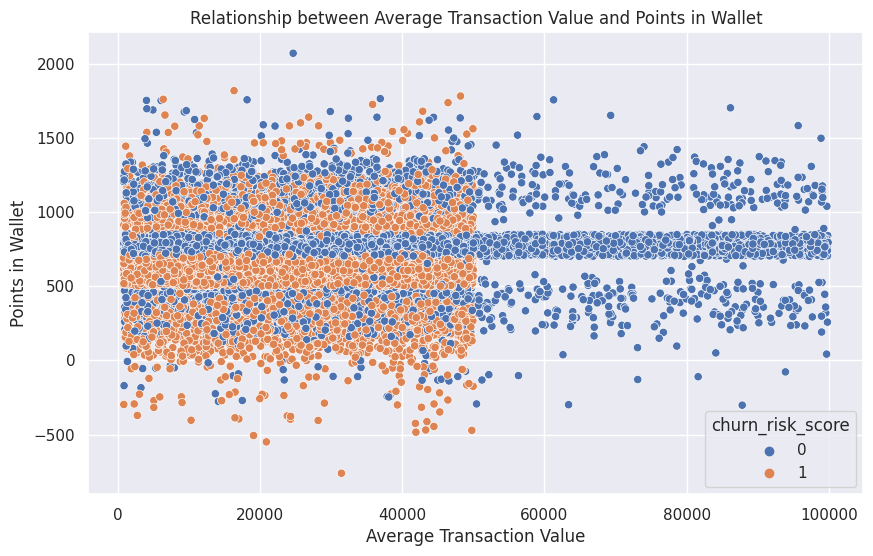

In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(data=data, x='avg_transaction_value', y='points_in_wallet', hue='churn_risk_score')
plt.xlabel('Average Transaction Value')
plt.ylabel('Points in Wallet')
plt.title('Relationship between Average Transaction Value and Points in Wallet')

In [ ]:
data.shape

(36992, 24)

In [ ]:
data.isnull().sum()
#region_category  preferred_offer_types  points_in_wallet  มีค่าว่างอยู่

index                              0
age                                0
gender                             0
security_no                        0
region_category                 5428
membership_category                0
joining_date                       0
joined_through_referral            0
referral_id                        0
preferred_offer_types            288
medium_of_operation                0
internet_option                    0
last_visit_time                    0
days_since_last_login              0
avg_time_spent                     0
avg_transaction_value              0
avg_frequency_login_days           0
points_in_wallet                3443
used_special_discount              0
offer_application_preference       0
past_complaint                     0
complaint_status                   0
feedback                           0
churn_risk_score                   0
dtype: int64

preferred_offer_types  ลบออกเพราะหาอะไรมาแทนไม่ได้

In [ ]:
data['region_category'].value_counts()

Town       14128
City       12737
Village     4699
Name: region_category, dtype: int64

In [ ]:
data['region_category'].shape

(36992,)

In [ ]:
data['preferred_offer_types'].value_counts()

Gift Vouchers/Coupons       12349
Credit/Debit Card Offers    12274
Without Offers              12081
Name: preferred_offer_types, dtype: int64

In [ ]:
data['preferred_offer_types'].shape

(36992,)

In [ ]:
data['joined_through_referral'].value_counts()

No     15839
Yes    15715
?       5438
Name: joined_through_referral, dtype: int64

In [ ]:
data['joined_through_referral'].shape

(36992,)

In [ ]:
data['days_since_last_login'].value_counts()

 12     2380
 13     2373
 14     2307
 15     2278
 11     2262
 10     2091
 16     2068
-999    1999
 9      1863
 17     1747
 8      1571
 18     1444
 7      1442
 19     1308
 6      1257
 5      1234
 20     1184
 21     1015
 4       998
 22      895
 3       852
 23      727
 2       613
 24      471
 1       328
 25      203
 26       82
Name: days_since_last_login, dtype: int64

In [ ]:
data['days_since_last_login'].shape

(36992,)

In [ ]:
data['medium_of_operation'].value_counts()

Desktop       13913
Smartphone    13876
?              5393
Both           3810
Name: medium_of_operation, dtype: int64

In [ ]:
data['medium_of_operation'].shape

(36992,)

In [ ]:
data['avg_frequency_login_days'].value_counts()

Error                  3522
13.0                   1394
19.0                   1365
8.0                    1361
14.0                   1355
                       ... 
28.191570401129514        1
41.73357294995208         1
-11.515939810499656       1
45.71683637272365         1
27.8399274405269          1
Name: avg_frequency_login_days, Length: 1654, dtype: int64

In [ ]:
data['avg_frequency_login_days'].shape

(36992,)

In [ ]:
negative_time= (data['avg_time_spent'] < 0).sum()
non_negative_time = (data['avg_time_spent'] >= 0).sum()

print(f"Number of negative values: {negative_time}")
print(f"Number of non-negative values: {non_negative_time}")

Number of negative values: 1719
Number of non-negative values: 35273


In [ ]:
# Convert the 'avg_frequency_login_days' column to numeric type  แปลงข้อมูลอบเจคให้เป็นตัวเลข
data['avg_frequency_login_days'] = pd.to_numeric(data['avg_frequency_login_days'], errors='coerce')
# เมื่อระบุ error='coerce' ค่าที่ไม่ถูกต้องหรือไม่รู้จักในคอลัมน์จะถูกแปลงเป็น NaN (ไม่ใช่ตัวเลข)

In [ ]:
negative_frequency = (data['avg_frequency_login_days'] < 0).sum()
non_negative_frequency = (data['avg_frequency_login_days'] >= 0).sum()

print(f"Number of negative values: {negative_frequency}")
print(f"Number of non-negative values: {non_negative_frequency}")

Number of negative values: 683
Number of non-negative values: 32787


In [ ]:
negative_points = (data['points_in_wallet'] < 0).sum()
non_negative_points = (data['points_in_wallet'] >= 0).sum()

print(f"Number of negative values: {negative_points}")
print(f"Number of non-negative values: {non_negative_points}")

Number of negative values: 136
Number of non-negative values: 33413


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36992 entries, 0 to 36991
Data columns (total 24 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   index                         36992 non-null  int64  
 1   age                           36992 non-null  int64  
 2   gender                        36992 non-null  object 
 3   security_no                   36992 non-null  object 
 4   region_category               31564 non-null  object 
 5   membership_category           36992 non-null  object 
 6   joining_date                  36992 non-null  object 
 7   joined_through_referral       36992 non-null  object 
 8   referral_id                   36992 non-null  object 
 9   preferred_offer_types         36704 non-null  object 
 10  medium_of_operation           36992 non-null  object 
 11  internet_option               36992 non-null  object 
 12  last_visit_time               36992 non-null  object 
 13  d

In [ ]:
data['points_in_wallet'] = pd.to_numeric(data['points_in_wallet'], errors='coerce')

#**ทำความสะอาดข้อมูล**

In [ ]:
data.isnull().sum()

index                              0
age                                0
gender                             0
security_no                        0
region_category                 5428
membership_category                0
joining_date                       0
joined_through_referral            0
referral_id                        0
preferred_offer_types            288
medium_of_operation                0
internet_option                    0
last_visit_time                    0
days_since_last_login              0
avg_time_spent                     0
avg_transaction_value              0
avg_frequency_login_days        3522
points_in_wallet                3443
used_special_discount              0
offer_application_preference       0
past_complaint                     0
complaint_status                   0
feedback                           0
churn_risk_score                   0
dtype: int64

In [ ]:
missing_count=data.isnull().sum()
missung_df=pd.DataFrame({'count':missing_count})
missung_df

,count
index,0
age,0
gender,0
security_no,0
region_category,5428
membership_category,0
joining_date,0
joined_through_referral,0
referral_id,0
preferred_offer_types,288


ลบค่าติดลบออกไปแล้ว

In [ ]:
#ค่าว่างแทนค่าด้วยค่าเฉลี่ย
# replace 'Error' with NaN
data['avg_frequency_login_days'] = data['avg_frequency_login_days'].replace('avg_frequency_login_days', pd.np.nan)

# calculate the average value of the column
avg_val1 = data['avg_frequency_login_days'].mean()

# replace NaN values with the average value   แทนที่ค่า  nan เป็น mean
data['avg_frequency_login_days'] = data['avg_frequency_login_days'].fillna(avg_val1)

หากคุณต้องการเขียน df[df['points_in_wallet'] > 0] แสดงว่าหมายถึงส่วนย่อยของ DataFrame ดั้งเดิมที่เลือกเฉพาะแถวที่มีค่ามากกว่า 0 ในคอลัมน์ point_in_wallet สิ่งนี้เรียกว่าการจัดทำดัชนีบูลีน โดยที่นิพจน์ df['points_in_wallet'] > 0 จะสร้างมาสก์บูลีนที่ใช้ในการกรอง DataFrame

In [ ]:
print("The replaced mean is:", avg_val1)

The replaced mean is: 15.976715237406284


In [ ]:
# Find the missing values
missing_vals2 = data['avg_frequency_login_days'].isna().sum()

# Print the results
print(f"The missing values in avg_frequency_login_days represented by the mean is {avg_val1}")
print(f"There are {missing_vals2} missing values.")

The missing values in avg_frequency_login_days represented by the mean is 15.976715237406284
There are 0 missing values.


In [ ]:
value1 = data[data['avg_frequency_login_days'] == 15.976715237406284]['avg_frequency_login_days']
print(value1)
print(len(value1))

39       15.976715
44       15.976715
45       15.976715
48       15.976715
50       15.976715
           ...    
36960    15.976715
36962    15.976715
36971    15.976715
36989    15.976715
36991    15.976715
Name: avg_frequency_login_days, Length: 3522, dtype: float64
3522


In [ ]:
count = (data['avg_frequency_login_days'] == 15.976715237406284).sum()
print(count)   #แทนที่ในค่าว่าง ด้วยค่า 15.976715237406284 ลงไป เป็นจำนวน 3522

3522


In [ ]:
data['avg_frequency_login_days'].shape

(36992,)

In [ ]:
#ลบ และ แทนค่า
#data['points_in_wallet'] = data['points_in_wallet'].fillna(data['points_in_wallet'].mean()) #แทนค่าด้วยค่าเฉลี่ย

# replace 'Error' with NaN
data['points_in_wallet'] = data['points_in_wallet'].replace('points_in_wallet', pd.np.nan)
# calculate the average value of the column
avg_val2 = data['points_in_wallet'].mean()

# replace NaN values with the average value   แทนที่ค่า  nan เป็น mean
data['points_in_wallet'] = data['points_in_wallet'].fillna(avg_val2)

In [ ]:
# Find the missing values
missing_vals3 = data['points_in_wallet'].isna().sum()

# Print the results
print(f"The missing values in points_in_wallet represented by the mean is {avg_val2}")
print(f"There are {missing_vals3} missing values.")

The missing values in points_in_wallet represented by the mean is 686.8821987429081
There are 0 missing values.


In [ ]:
value2 = data[data['points_in_wallet'] == 686.8821987429081]['points_in_wallet']
print(value2)
print(len(value2))

1        686.882199
8        686.882199
13       686.882199
14       686.882199
16       686.882199
            ...    
36937    686.882199
36939    686.882199
36941    686.882199
36947    686.882199
36951    686.882199
Name: points_in_wallet, Length: 3443, dtype: float64
3443


In [ ]:
op1 = data[data['points_in_wallet'] == 686.8821987429081]
op1.head(5)

,index,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,...,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
1,1,32,F,5K0N3X1,City,Premium Membership,2017-08-28,?,CID21329,Gift Vouchers/Coupons,...,306.34,12838.38,10.0,686.882199,Yes,No,Yes,Solved,Quality Customer Care,0
8,8,44,M,0481QNQ,Village,Silver Membership,2016-12-14,No,xxxxxxxx,Without Offers,...,191.07,18362.31,20.0,686.882199,Yes,No,Yes,Solved in Follow-up,Poor Customer Service,0
13,13,34,M,S71G75R,City,Basic Membership,2016-12-07,Yes,CID10856,Gift Vouchers/Coupons,...,89.76,21318.19,6.0,686.882199,No,Yes,No,Not Applicable,Poor Product Quality,1
14,14,40,M,QAL9ZY2,City,Premium Membership,2016-11-19,No,xxxxxxxx,Without Offers,...,100.59,14842.62,26.0,686.882199,No,Yes,No,Not Applicable,Poor Website,0
16,16,57,F,RZ6TPTR,City,No Membership,2016-01-27,No,xxxxxxxx,Without Offers,...,333.34,47241.32,8.0,686.882199,Yes,Yes,Yes,Solved in Follow-up,Too many ads,1


In [ ]:
op2 = data[data['avg_frequency_login_days'] == 15.976715237406284]
op2.head(5)

,index,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,...,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
39,39,49,F,M9F3TE2,Village,Platinum Membership,2017-06-09,Yes,CID18445,Credit/Debit Card Offers,...,706.36,19062.25,15.976715,780.580000,Yes,No,No,Not Applicable,Poor Product Quality,0
44,44,36,M,C7QZITU,Village,Silver Membership,2016-11-28,Yes,CID33962,Gift Vouchers/Coupons,...,691.09,17989.46,15.976715,686.882199,No,Yes,Yes,Solved,No reason specified,1
45,45,12,M,B1XF70C,City,Premium Membership,2017-02-13,No,xxxxxxxx,Without Offers,...,33.09,55607.35,15.976715,686.882199,Yes,No,No,Not Applicable,User Friendly Website,0
48,48,30,M,TER02YR,City,Platinum Membership,2015-12-11,?,CID4129,Gift Vouchers/Coupons,...,100.42,86433.91,15.976715,719.930000,No,Yes,Yes,Unsolved,Reasonable Price,0
50,50,23,M,UAAYTIM,Village,Gold Membership,2015-10-22,Yes,CID24995,Without Offers,...,65.25,5136.08,15.976715,755.220000,No,Yes,No,Not Applicable,Poor Customer Service,0


In [ ]:
count1 = (data['points_in_wallet'] == 686.8821987429081).sum()
print(count1)    #การแทนค่าว่างลงไปแทนไป 3443 แถว

3443


In [ ]:
data['points_in_wallet'].shape

(36992,)

In [ ]:
data['medium_of_operation'].replace('?', 'Unknown', inplace=True) #แทนคำว่า ? ด้วยคำว่า  unknown

In [ ]:
data['joined_through_referral'].replace('?', 'Unknown', inplace=True)

In [ ]:
data['days_since_last_login'].replace(-999, 999, inplace=True)

In [ ]:
data.dropna(subset=['preferred_offer_types'],inplace=True) #ลบค่าว่างอก

In [ ]:
data['region_category'].fillna('Unknown', inplace=True)

In [ ]:
data['region_category'].value_counts()

Town       14025
City       12635
Unknown     5379
Village     4665
Name: region_category, dtype: int64

In [ ]:
data['region_category'].shape

(36704,)

In [ ]:
data['preferred_offer_types'].value_counts()

Gift Vouchers/Coupons       12349
Credit/Debit Card Offers    12274
Without Offers              12081
Name: preferred_offer_types, dtype: int64

In [ ]:
data['preferred_offer_types'].shape

(36704,)

In [ ]:
data['joined_through_referral'].value_counts()

No         15731
Yes        15578
Unknown     5395
Name: joined_through_referral, dtype: int64

In [ ]:
data['joined_through_referral'].shape

(36704,)

In [ ]:
data['days_since_last_login'].value_counts()

12     2362
13     2354
14     2289
15     2262
11     2239
10     2077
16     2055
999    1988
9      1845
17     1735
8      1553
18     1431
7      1426
19     1302
6      1246
5      1228
20     1177
21     1009
4       989
22      888
3       843
23      724
2       605
24      470
1       325
25      202
26       80
Name: days_since_last_login, dtype: int64

In [ ]:
data['days_since_last_login'].shape

(36704,)

In [ ]:
data['medium_of_operation'].value_counts()

Desktop       13806
Smartphone    13766
Unknown        5348
Both           3784
Name: medium_of_operation, dtype: int64

In [ ]:
data['medium_of_operation'].shape

(36704,)

In [ ]:
data['age'].value_counts()

33    713
42    711
16    710
61    706
30    706
38    703
60    697
57    697
41    692
59    692
55    690
28    689
47    688
21    684
34    683
32    679
17    679
48    679
45    679
46    677
29    675
56    674
62    673
58    672
22    672
26    671
64    667
10    667
53    666
52    666
14    665
49    663
23    661
36    660
12    656
44    656
19    655
51    652
27    652
63    652
50    651
43    651
37    651
13    650
35    649
11    649
15    644
20    638
39    638
24    637
25    635
31    629
18    625
40    624
54    604
Name: age, dtype: int64

In [ ]:

data.set_index('index', inplace=True, drop=True)

In [ ]:
data.shape

(36704, 23)

In [ ]:
# Remove negative values
data = data[data['points_in_wallet'] >= 0]

In [ ]:
negative_points1 = (data['points_in_wallet'] < 0).sum()
non_negative_points1 = (data['points_in_wallet'] >= 0).sum()
print(f"Number of negative values: {negative_points1}")
print(f"Number of non-negative values: {non_negative_points1}")

Number of negative values: 0
Number of non-negative values: 36568


In [ ]:
# Remove negative values
data = data[data['avg_time_spent'] >= 0]

In [ ]:
negative_time1= (data['avg_time_spent'] < 0).sum()
non_negative_time1 = (data['avg_time_spent'] >= 0).sum()

print(f"Number of negative values: {negative_time1}")
print(f"Number of non-negative values: {non_negative_time1}")

Number of negative values: 0
Number of non-negative values: 34876


In [ ]:
# Remove negative values
data = data[data['avg_frequency_login_days'] >= 0]

In [ ]:
negative_frequency1 = (data['avg_frequency_login_days'] < 0).sum()
non_negative_frequency1 = (data['avg_frequency_login_days'] >= 0).sum()

print(f"Number of negative values: {negative_frequency1}")
print(f"Number of non-negative values: {non_negative_frequency1}")

Number of negative values: 0
Number of non-negative values: 34250


In [ ]:
data['age'].value_counts()

42    673
16    668
33    657
38    655
47    654
30    653
41    649
61    649
60    648
57    647
59    646
21    642
55    640
17    639
32    637
45    637
28    636
34    634
48    634
62    633
56    631
36    631
46    630
10    628
22    627
23    626
14    625
29    623
64    623
44    623
26    619
53    618
52    618
43    618
58    617
12    615
35    614
50    613
49    612
51    610
27    610
11    607
19    606
63    603
13    601
37    598
24    597
20    597
31    592
39    591
25    589
15    587
40    584
54    571
18    565
Name: age, dtype: int64

In [ ]:
data['age'].shape

(34250,)

In [ ]:
data['age'].max

<bound method NDFrame._add_numeric_operations.<locals>.max of index
0        18
1        32
2        44
3        37
4        31
         ..
36985    12
36986    27
36989    23
36990    53
36991    35
Name: age, Length: 34250, dtype: int64>

In [ ]:
data['region_category'].value_counts()

Town       13092
City       11761
Unknown     5033
Village     4364
Name: region_category, dtype: int64

In [ ]:
data['gender'].value_counts()

F          17134
M          17065
Unknown       51
Name: gender, dtype: int64

In [ ]:
data['preferred_offer_types'].value_counts()

Gift Vouchers/Coupons       11518
Credit/Debit Card Offers    11471
Without Offers              11261
Name: preferred_offer_types, dtype: int64

In [ ]:
data['joined_through_referral'].value_counts()

No         14650
Yes        14574
Unknown     5026
Name: joined_through_referral, dtype: int64

In [ ]:
data['medium_of_operation'].value_counts()

Desktop       12862
Smartphone    12840
Unknown        4990
Both           3558
Name: medium_of_operation, dtype: int64

In [ ]:
data['days_since_last_login'].value_counts()

12     2212
13     2185
14     2151
15     2087
11     2084
10     1953
16     1926
999    1861
9      1706
17     1622
8      1446
18     1355
7      1337
19     1220
6      1161
5      1129
20     1103
21      958
4       924
22      835
3       770
23      674
2       561
24      436
1       301
25      181
26       72
Name: days_since_last_login, dtype: int64

In [ ]:
data['membership_category'].value_counts()

Basic Membership       7129
No Membership          7088
Gold Membership        6307
Silver Membership      5564
Premium Membership     4128
Platinum Membership    4034
Name: membership_category, dtype: int64

In [ ]:
data['internet_option'].value_counts()

Wi-Fi          11489
Mobile_Data    11381
Fiber_Optic    11380
Name: internet_option, dtype: int64

In [ ]:
data['complaint_status'].value_counts()

Not Applicable              17230
Unsolved                     4309
Solved                       4273
Solved in Follow-up          4219
No Information Available     4219
Name: complaint_status, dtype: int64

In [ ]:
data['feedback'].value_counts()

Poor Product Quality        5873
Poor Website                5826
Poor Customer Service       5815
No reason specified         5803
Too many ads                5793
Reasonable Price            1303
User Friendly Website       1291
Products always in Stock    1281
Quality Customer Care       1265
Name: feedback, dtype: int64

ตรวจดูความซ้ำซ้อน

In [ ]:
data.duplicated().value_counts()
#ไม่มีความซ้ำซ้อนกัน

False    34250
dtype: int64

In [ ]:
data.shape

(34250, 23)

In [ ]:
data.describe()

,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,churn_risk_score
count,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000
mean,37.117635,66.369431,292.450552,29253.835764,16.475932,690.034748,0.539591
std,15.859211,223.623608,331.545641,19475.385199,7.962363,177.108824,0.498437
min,10.000000,1.000000,1.837399,800.460000,0.009208,6.432208,0.000000
25%,23.000000,9.000000,71.470000,14163.282500,10.000000,625.215000,0.000000
50%,37.000000,13.000000,174.005000,27469.545000,15.976715,686.882199,1.000000
75%,51.000000,18.000000,370.717500,40784.997500,22.000000,757.137500,1.000000
max,64.000000,999.000000,3235.578521,99914.050000,73.061995,2069.069761,1.000000


In [ ]:
data.describe(include='object')


,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,medium_of_operation,internet_option,last_visit_time,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback
count,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250
unique,3,34250,4,6,1096,3,10860,3,4,3,28291,2,2,2,5,9
top,F,XW0DQ7H,Town,Basic Membership,2015-06-02,No,xxxxxxxx,Gift Vouchers/Coupons,Desktop,Wi-Fi,07:56:41,Yes,Yes,No,Not Applicable,Poor Product Quality
freq,17134,1,13092,7129,52,14650,16515,11518,12862,11489,6,18843,18948,17230,17230,5873


#**ดูรูปหลังทำความสะอาดแล้ว**

<Figure size 1000x400 with 0 Axes>

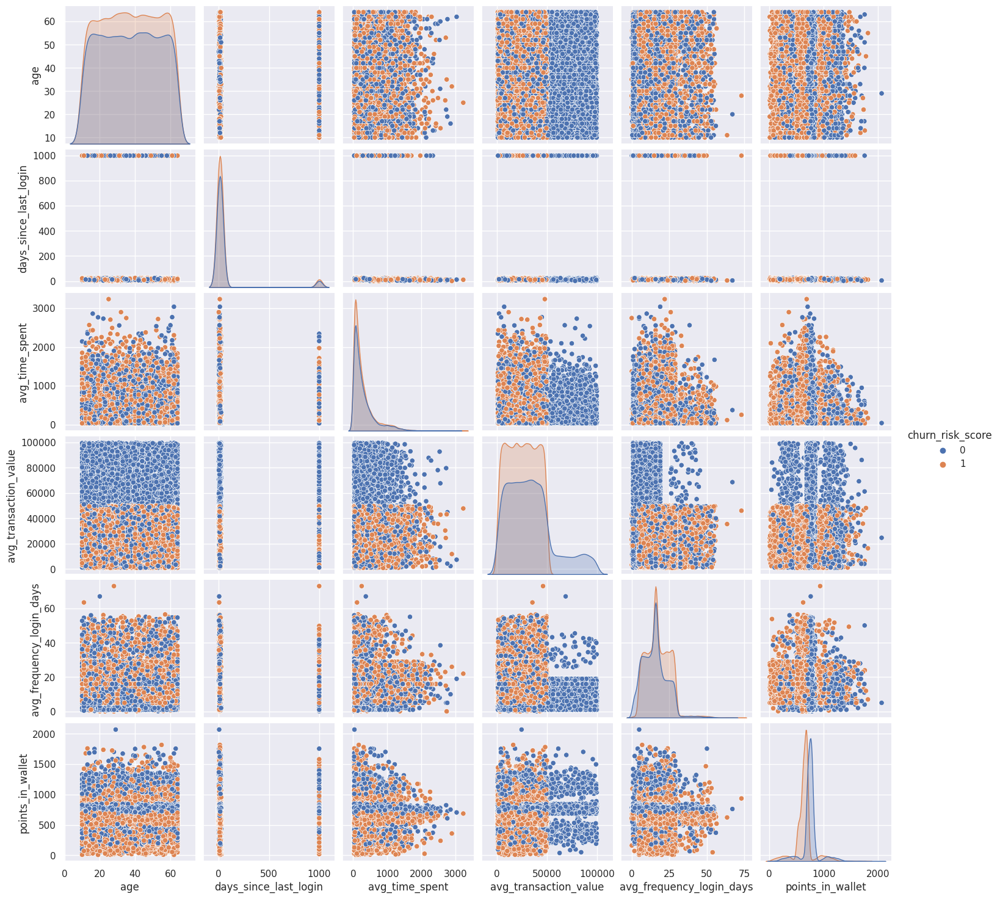

In [ ]:
plt.figure(figsize=(10,4))
data.reset_index(inplace=True)
sns.pairplot(data.drop('index', axis=1), hue='churn_risk_score')

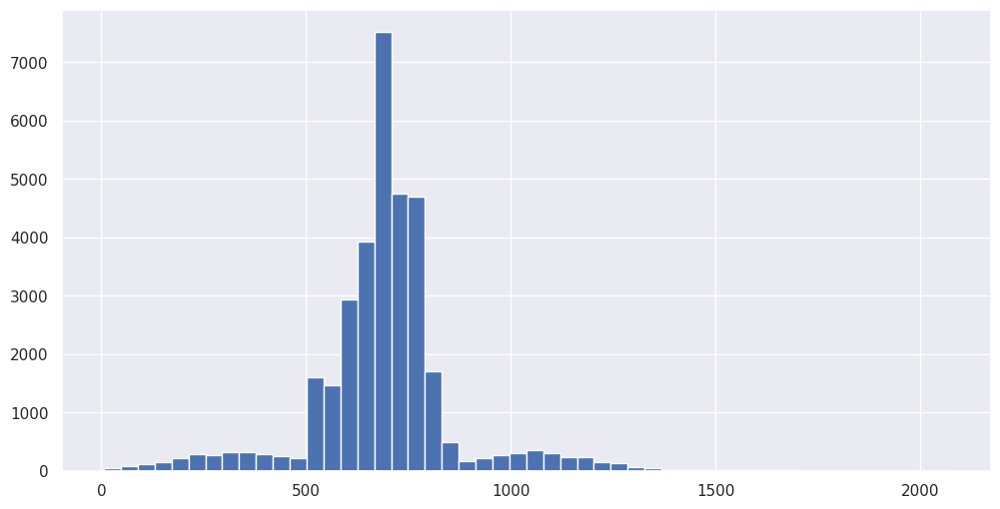

In [ ]:
# Create the histogram
plt.hist(data['points_in_wallet'], bins=50)

# Set the title and labels
#plt.title('Points in Wallet Histogram')
#plt.xlabel('Points')
#plt.ylabel('Frequency')

# Show the plot
plt.show()

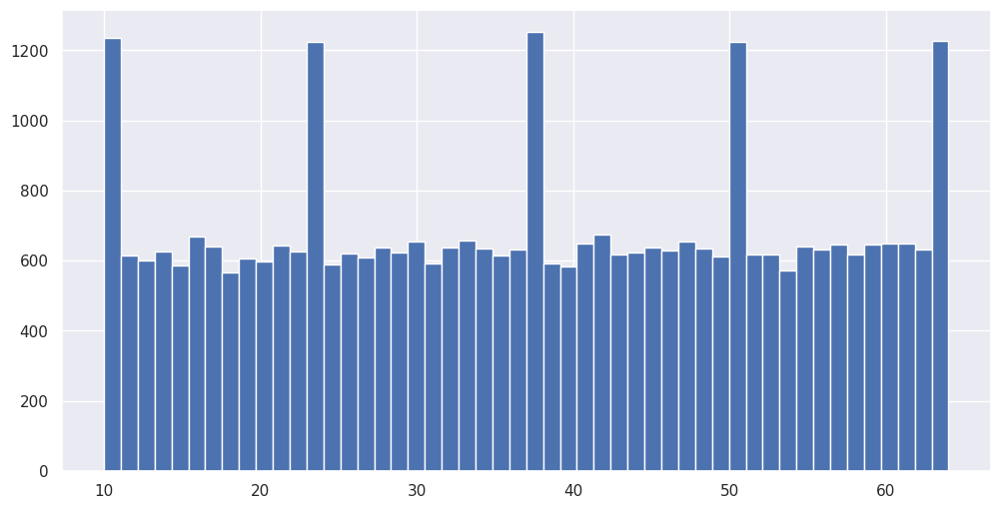

In [ ]:
# Create the histogram
plt.hist(data['age'], bins=50)

# Set the title and labels
#plt.title('Points in Wallet Histogram')
#plt.xlabel('Points')
#plt.ylabel('Frequency')

# Show the plot
plt.show()

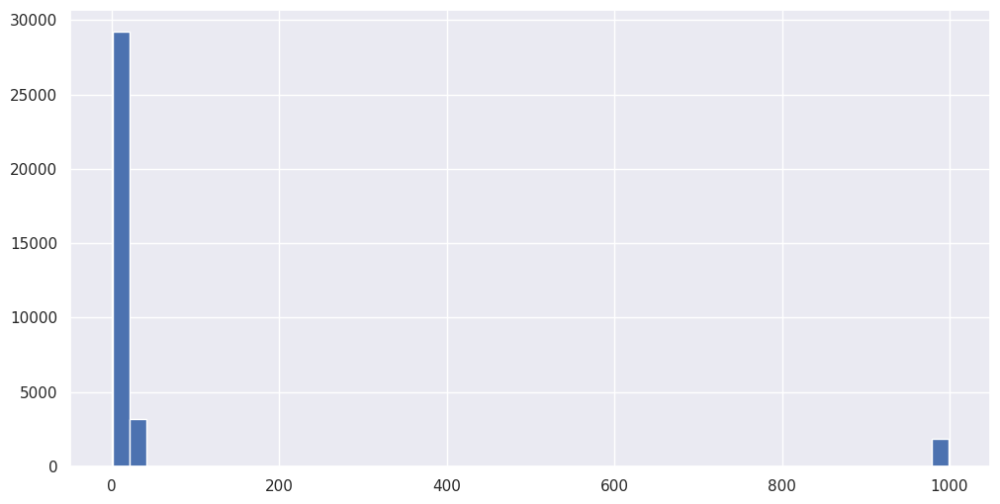

In [ ]:
# Create the histogram
plt.hist(data['days_since_last_login'], bins=50)



# Show the plot
plt.show()

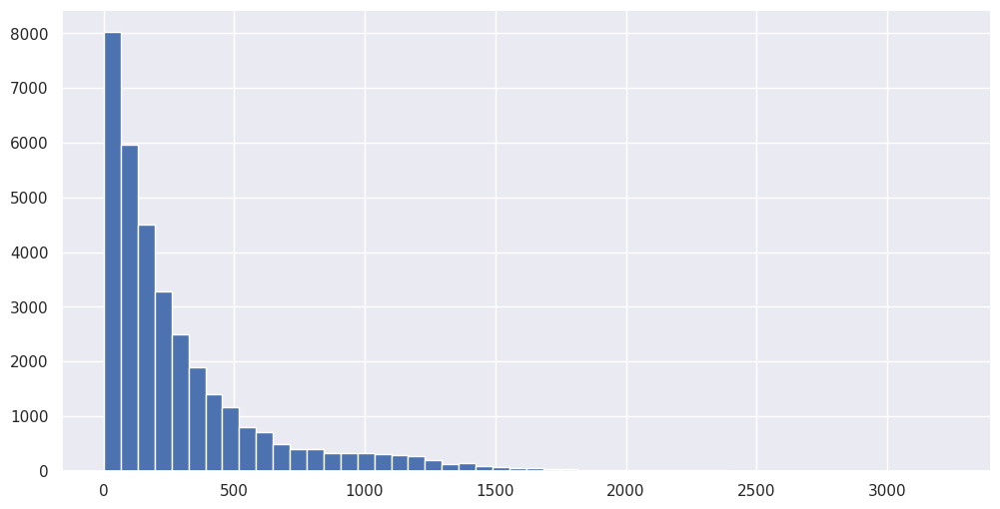

In [ ]:
# Create the histogram
plt.hist(data['avg_time_spent'], bins=50)

# Show the plot
plt.show()

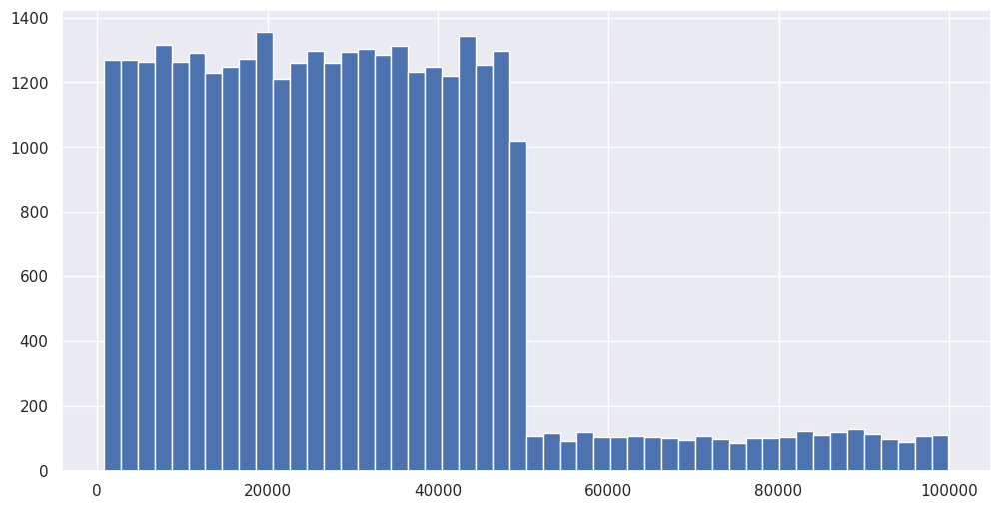

In [ ]:
# Create the histogram
plt.hist(data['avg_transaction_value'], bins=50)


# Show the plot
plt.show()

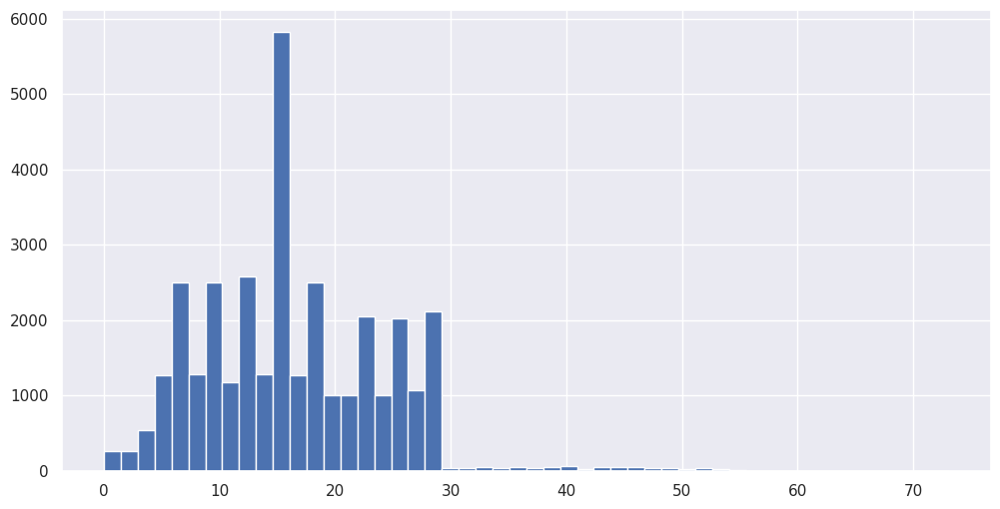

In [ ]:
# Create the histogram
plt.hist(data['avg_frequency_login_days'], bins=50)


# Show the plot
plt.show()

In [ ]:
# Create two subsets of the data based on churn risk score values
subset_0 = data[data['churn_risk_score'] == 0]
subset_1 = data[data['churn_risk_score'] == 1]

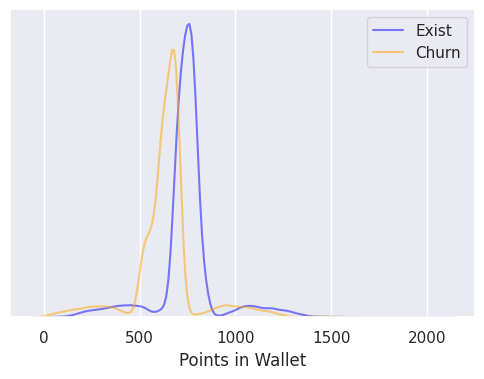

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['points_in_wallet'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['points_in_wallet'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('Points in Wallet')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

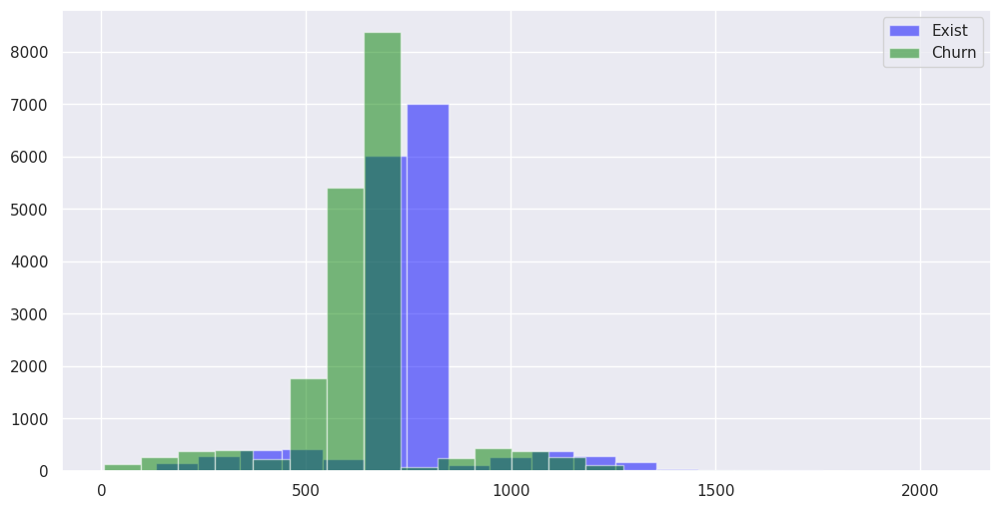

In [ ]:
plt.hist(subset_0['points_in_wallet'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['points_in_wallet'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()

รหัสโค้ดที่คุณให้มาเป็นการสร้าง histogram สองแผนภูมิที่เรียกว่า "Exist" และ "Churn" ซึ่งแสดงการกระจายของข้อมูลในคอลัมน์ 'points_in_wallet' สำหรับข้อมูลใน subset_0 และ subset_1 โดยแกน x แสดงค่าของ 'points_in_wallet' และแกน y แสดงจำนวนข้อมูลที่มีค่า 'points_in_wallet' ในช่วงของแต่ละ bin (ช่อง) ที่กำหนดโดยพารามิเตอร์ bins.

    แกน x: แสดงค่าของ 'points_in_wallet' ซึ่งเป็นจำนวนคะแนนในกระเป๋าของลูกค้า
    แกน y: แสดงจำนวนข้อมูลที่มีค่า 'points_in_wallet' อยู่ในแต่ละช่วงของ bin (ช่อง)
    "Exist": แสดงแผนภูมิสีฟ้า แสดงกราฟสำหรับ subset_0 ซึ่งเป็นกลุ่มข้อมูลที่มีค่า churn_risk_score เป็น 0 (ไม่เกิดการย้ายความเสี่ยง)
    "Churn": แสดงแผนภูมิสีเขียว แสดงกราฟสำหรับ subset_1 ซึ่งเป็นกลุ่มข้อมูลที่มีค่า churn_risk_score เป็น 1 (เกิดการย้ายความเสี่ยง)

ค่า bins ในพารามิเตอร์ใช้ในการแบ่งช่วงของคะแนน 'points_in_wallet' เป็นช่วงหลายๆ ช่วงเพื่อแสดงกราฟที่มีรายละเอียดมากขึ้น แต่จะอาจทำให้กราฟดูซับซ้อนหากมีค่ามากเกินไป ดังนั้นค่า bins ถูกตั้งค่าเพื่อให้กราฟง่ายต่อการอ่านและเข้าใจได้ดี.

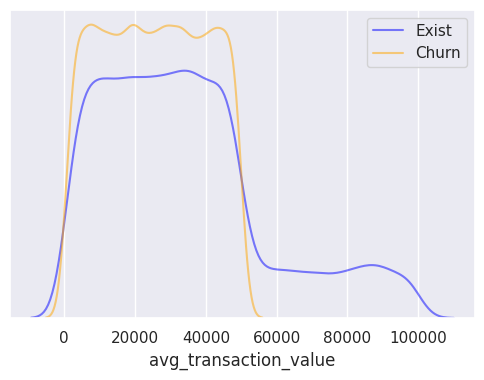

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['avg_transaction_value'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['avg_transaction_value'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('avg_transaction_value')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

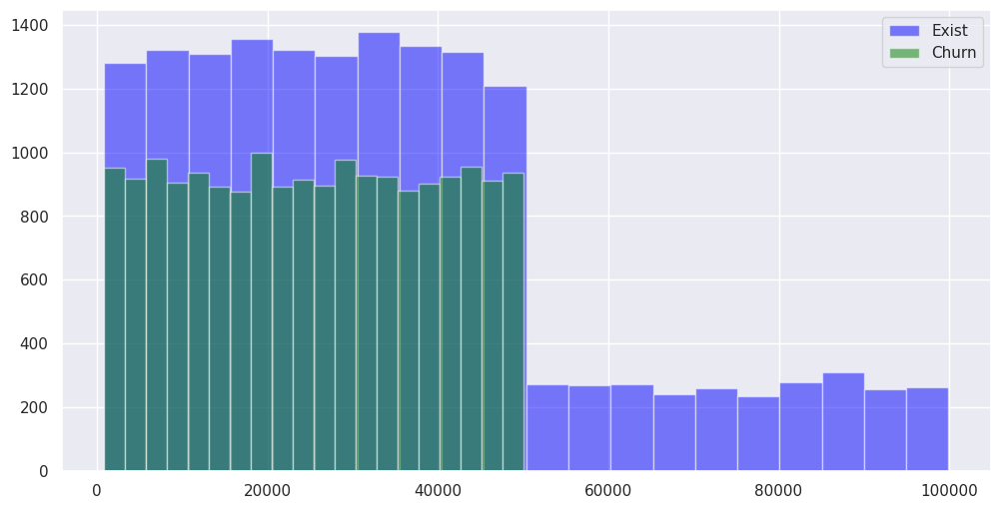

In [ ]:
plt.hist(subset_0['avg_transaction_value'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['avg_transaction_value'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()

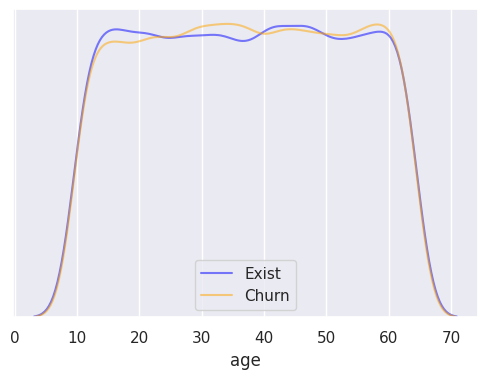

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['age'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['age'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('age')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

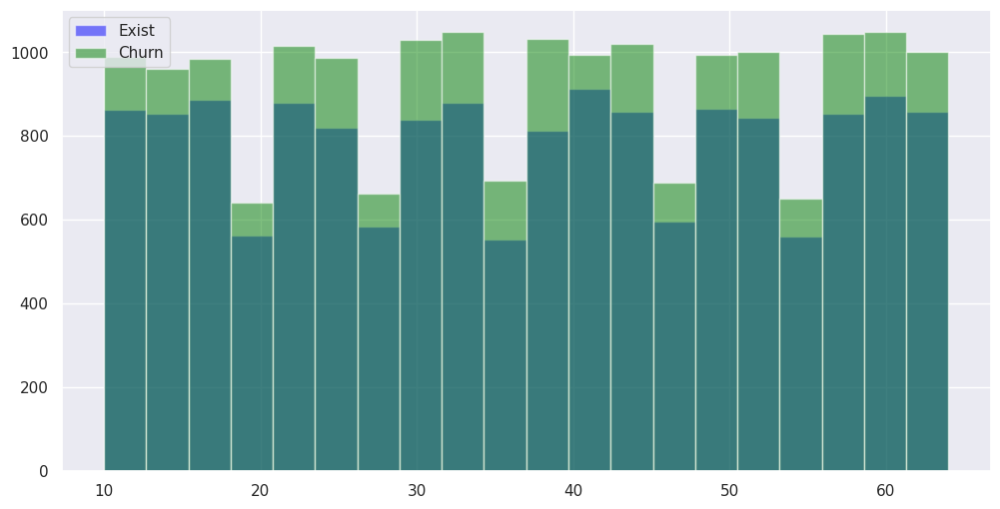

In [ ]:
plt.hist(subset_0['age'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['age'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()

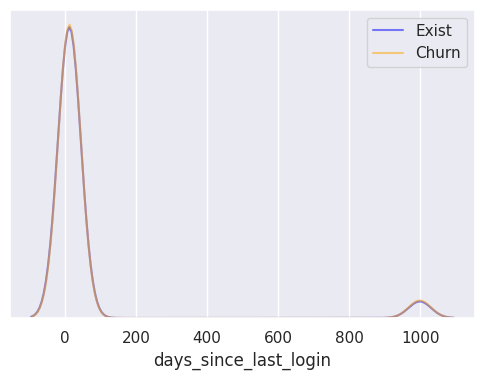

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['days_since_last_login'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['days_since_last_login'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('days_since_last_login')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

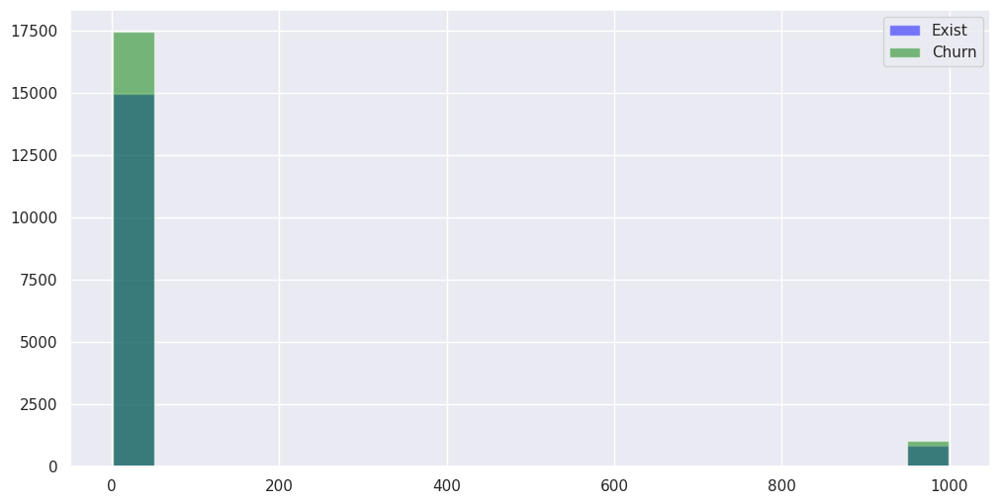

In [ ]:
plt.hist(subset_0['days_since_last_login'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['days_since_last_login'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()



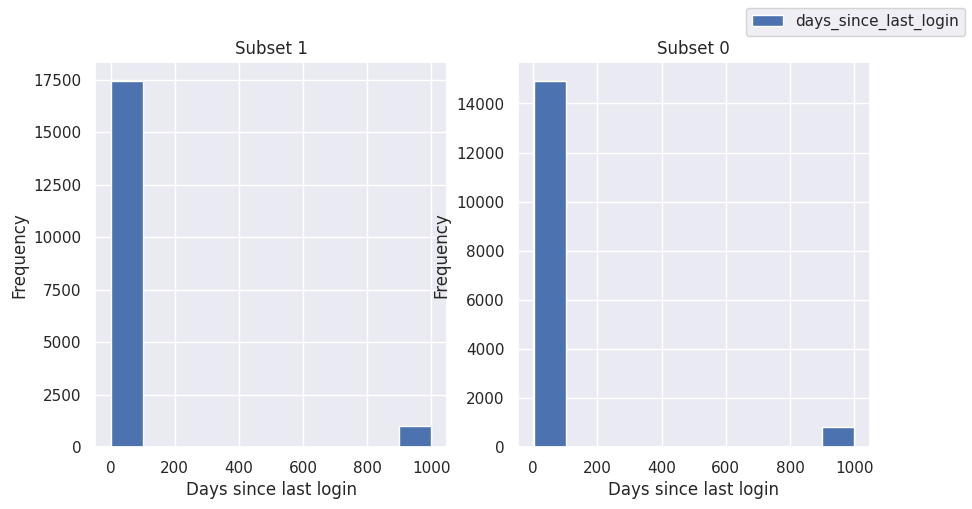

In [ ]:
# Create a figure with two subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

# Create a histogram of 'days_since_last_login' column for subset_1 and set title and labels
subset_1['days_since_last_login'].plot(kind='hist', ax=axes[0], title='Subset 1')
axes[0].set_xlabel('Days since last login')
axes[0].set_ylabel('Frequency')

# Create a histogram of 'days_since_last_login' column for subset_0 and set title and labels
subset_0['days_since_last_login'].plot(kind='hist', ax=axes[1], title='Subset 0')
axes[1].set_xlabel('Days since last login')
axes[1].set_ylabel('Frequency')

# Set the legend for both subplots
patches, labels = axes[0].get_legend_handles_labels()
#fig.legend(patches, labels, loc='best')
fig.legend(patches, labels, loc='upper right')
# Show the figure
plt.show()

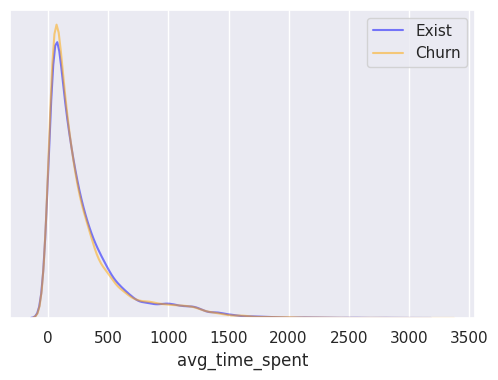

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['avg_time_spent'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['avg_time_spent'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('avg_time_spent')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

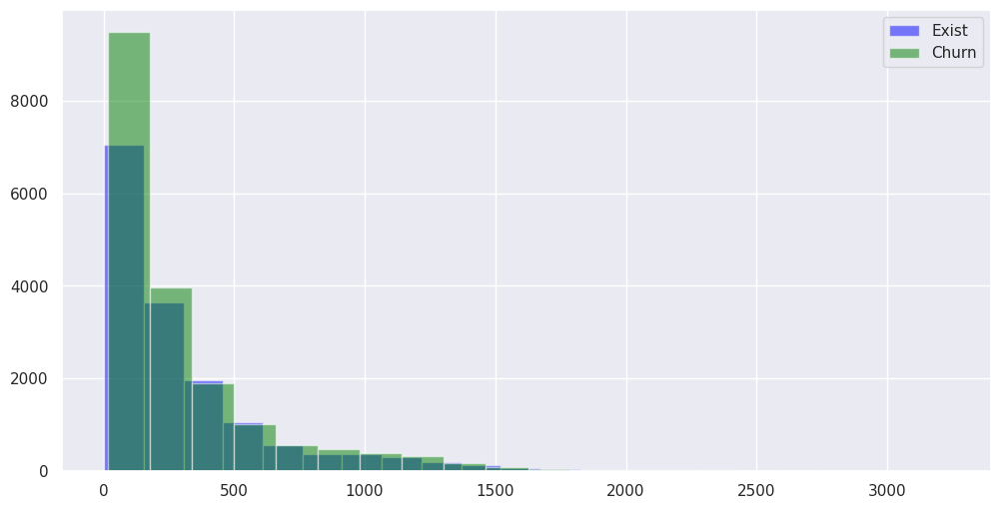

In [ ]:
plt.hist(subset_0['avg_time_spent'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['avg_time_spent'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()

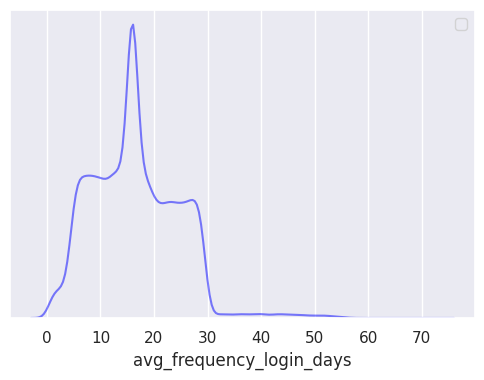

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))

sns.kdeplot(data['avg_frequency_login_days'], color='blue', alpha=0.5)
plt.xlabel('avg_frequency_login_days')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

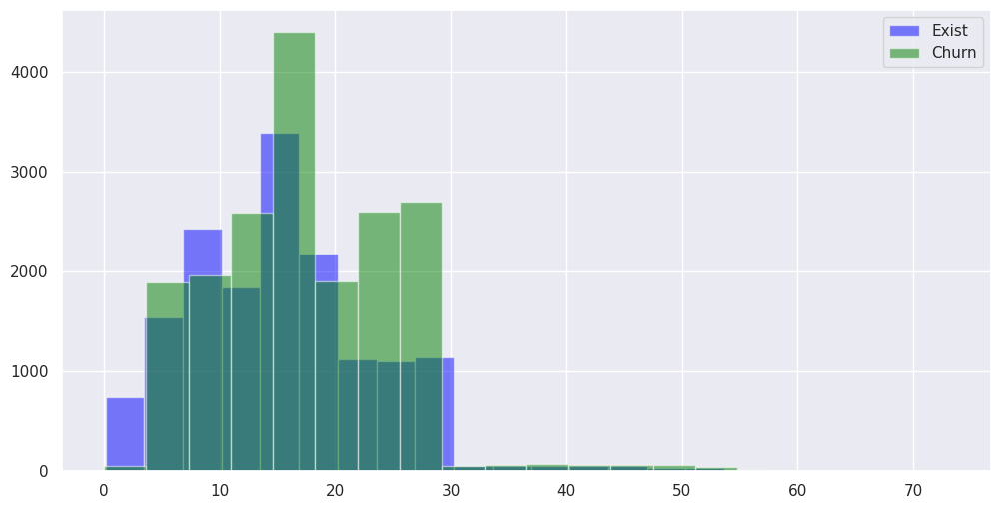

In [ ]:
plt.hist(subset_0['avg_frequency_login_days'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['avg_frequency_login_days'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()

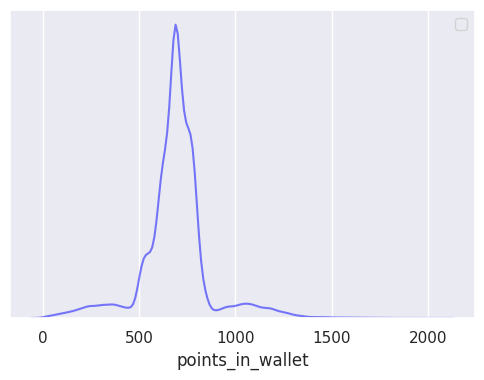

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))

sns.kdeplot(data['points_in_wallet'], color='blue', alpha=0.5)
plt.xlabel('points_in_wallet')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

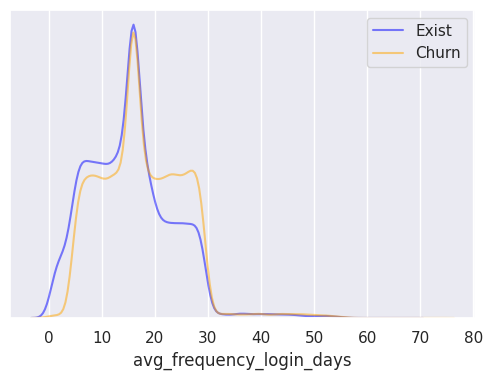

In [ ]:
# Create a histogram with two colors for each subset
plt.figure(figsize=(6,4))
sns.kdeplot(subset_0['avg_frequency_login_days'], color='blue', alpha=0.5, label='Exist')
sns.kdeplot(subset_1['avg_frequency_login_days'], color='orange', alpha=0.5, label='Churn')
plt.xlabel('avg_frequency_login_days')
plt.ylabel('')
plt.yticks([])
plt.legend()
plt.show()

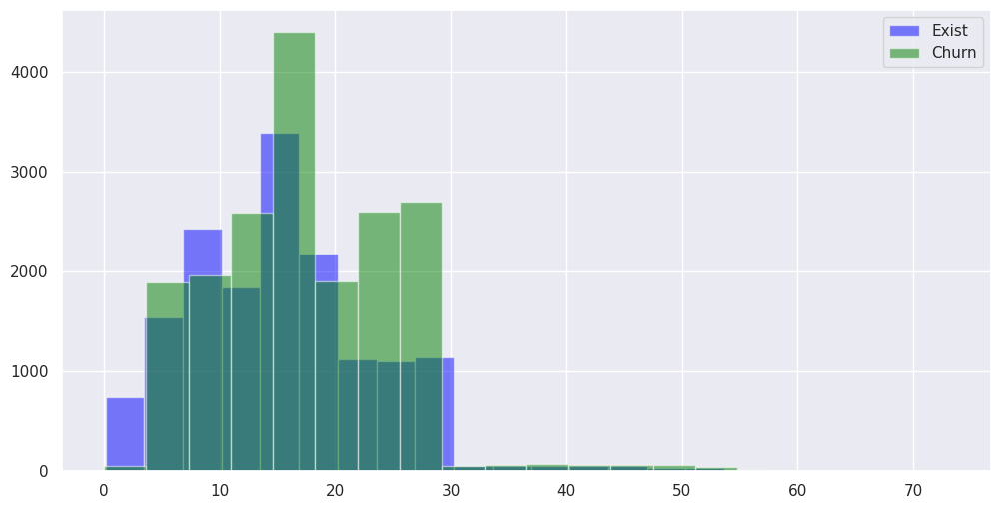

In [ ]:
plt.hist(subset_0['avg_frequency_login_days'], color='blue',bins=20,alpha=0.5, label='Exist')
plt.hist(subset_1['avg_frequency_login_days'], color='green',bins=20,alpha=0.5, label='Churn')
plt.legend()
plt.show()

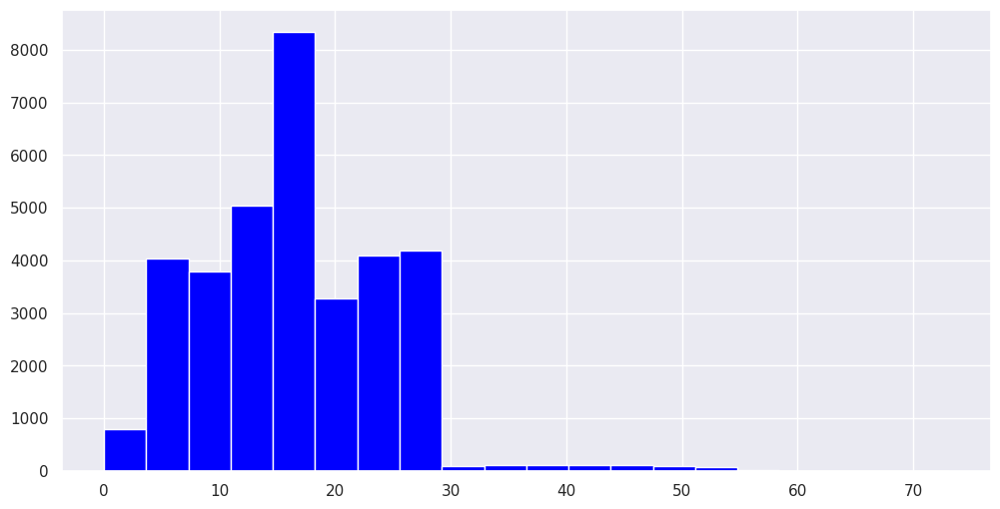

In [ ]:
plt.hist(data['avg_frequency_login_days'], color='blue',bins=20)

plt.show()

In [ ]:
data['avg_frequency_login_days'].shape

(34250,)

In [ ]:
data.describe()

,index,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,churn_risk_score
count,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000
mean,18508.593693,37.117635,66.369431,292.450552,29253.835764,16.475932,690.034748,0.539591
std,10681.609380,15.859211,223.623608,331.545641,19475.385199,7.962363,177.108824,0.498437
min,0.000000,10.000000,1.000000,1.837399,800.460000,0.009208,6.432208,0.000000
25%,9266.250000,23.000000,9.000000,71.470000,14163.282500,10.000000,625.215000,0.000000
50%,18497.500000,37.000000,13.000000,174.005000,27469.545000,15.976715,686.882199,1.000000
75%,27772.750000,51.000000,18.000000,370.717500,40784.997500,22.000000,757.137500,1.000000
max,36991.000000,64.000000,999.000000,3235.578521,99914.050000,73.061995,2069.069761,1.000000


In [ ]:
subset_0.describe()

,index,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,churn_risk_score
count,15769.000000,15769.000000,15769.000000,15769.000000,15769.000000,15769.000000,15769.000000,15769.0
mean,18512.329063,37.031898,64.963156,296.688201,33832.677374,15.291507,747.572656,0.0
std,10659.197099,15.916415,221.074995,331.903467,23393.645502,7.982472,165.765840,0.0
min,0.000000,10.000000,1.000000,1.837399,806.220000,0.132288,32.272706,0.0
25%,9353.000000,23.000000,9.000000,73.680000,15804.930000,9.000000,708.660000,0.0
50%,18515.000000,37.000000,13.000000,180.500000,30519.380000,15.976715,749.330000,0.0
75%,27701.000000,51.000000,17.000000,382.420000,45094.240000,20.000000,784.270000,0.0
max,36991.000000,64.000000,999.000000,3040.410000,99914.050000,67.062422,2069.069761,0.0


In [ ]:
subset_1.describe()

,index,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,churn_risk_score
count,18481.000000,18481.000000,18481.000000,18481.000000,18481.000000,18481.000000,18481.000000,18481.0
mean,18505.406472,37.190791,67.569341,288.834757,25346.917668,17.486547,640.940258,1.0
std,10700.982926,15.810302,225.774527,331.206132,14242.001585,7.804525,171.616877,0.0
min,2.000000,10.000000,1.000000,15.114910,800.460000,0.009208,6.432208,1.0
25%,9179.000000,24.000000,9.000000,70.110000,12916.760000,12.000000,593.590000,1.0
50%,18480.000000,37.000000,13.000000,169.030000,25371.910000,16.000000,648.410000,1.0
75%,27838.000000,51.000000,18.000000,361.030000,37714.880000,23.000000,686.882199,1.0
max,36989.000000,64.000000,999.000000,3235.578521,49997.690000,73.061995,1816.933696,1.0


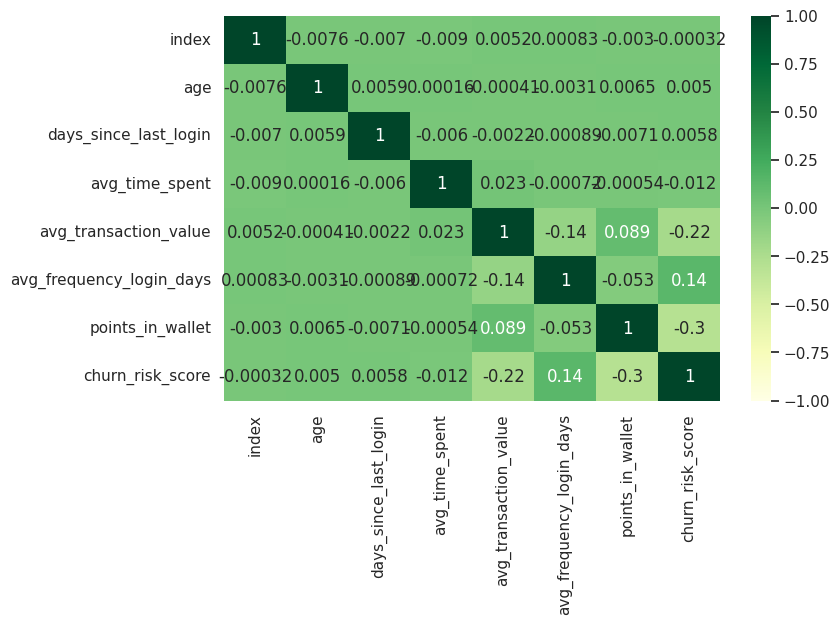

In [ ]:
plt.figure(figsize=(8,5))
sns.heatmap(data.corr(), vmax=1, vmin=-1,cmap='YlGn', annot=True)
plt.show()

#ไม่มีฟีเจอร์ไหนที่มีความสัมพันธ์กันสูง ที่ชัดเจน ซึ่งข้อมูลไม่มีความซ้ำซ้อน

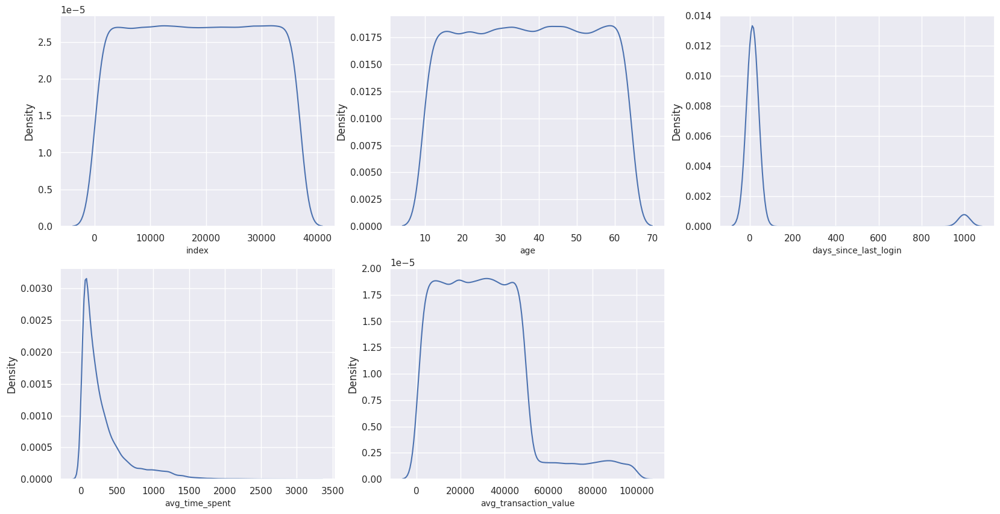

In [ ]:
data_num=data.drop('churn_risk_score', axis=1).select_dtypes(include=[np.number])
fig,ax= plt.subplots(nrows=2,ncols=3,figsize=(20,10))
for variable, subplot in zip(data_num.columns,ax.flatten()):
    z = sns.kdeplot(x = data_num[variable] , ax=subplot)
    z.set_xlabel(variable, fontsize = 10)

fig.delaxes(ax[1][2])
plt.show()

In [ ]:
data_num.skew() #The skew() function in pandas is used to calculate the skewness of the numerical columns in a pandas dataframe.

index                      -0.001807
age                        -0.009327
days_since_last_login       3.928413
avg_time_spent              2.252108
avg_transaction_value       1.019859
avg_frequency_login_days    0.686703
points_in_wallet            0.294746
dtype: float64

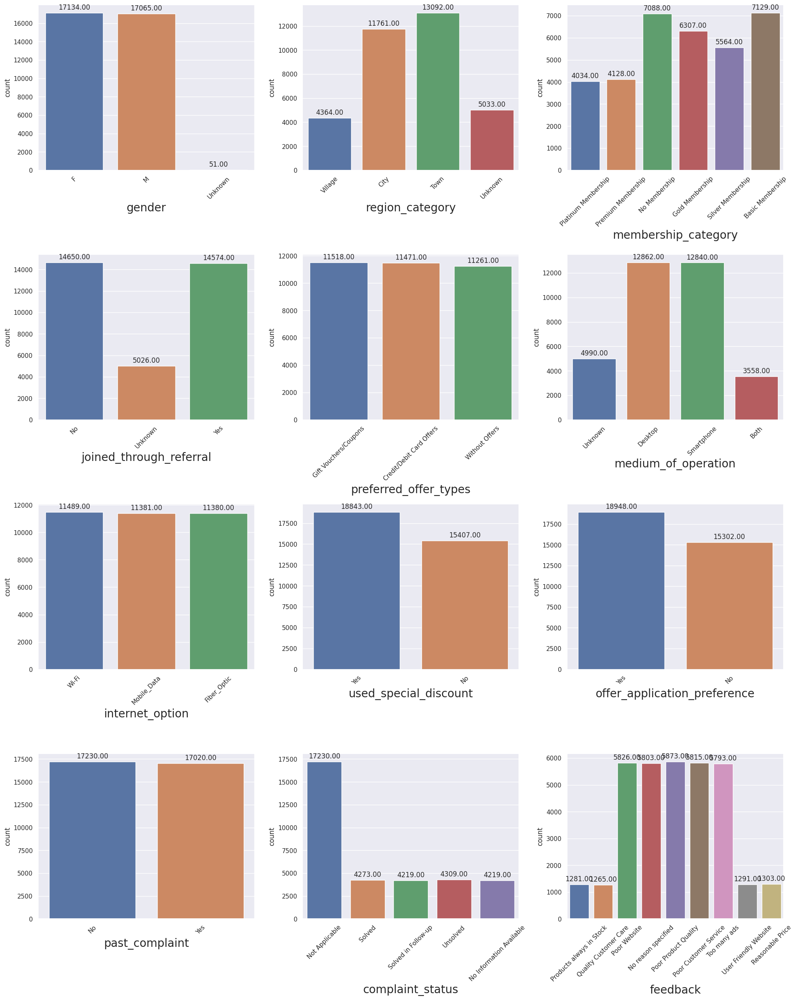

In [ ]:
data_cat = data.drop(['referral_id','last_visit_time','avg_frequency_login_days','security_no','joining_date'], axis=1).select_dtypes(include='object')
fig,ax= plt.subplots(nrows=4,ncols=3,figsize=(20, 25))
for variable, subplot in zip(data_cat.columns,ax.flatten()):
    z = sns.countplot(x = data_cat[variable],ax=subplot, )
    z.set_xlabel(variable, fontsize = 20)
    z.set_xticklabels(z.get_xticklabels(),rotation=45)
    for p in z.patches:
      z.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center',
           xytext = (0, 6), textcoords = 'offset points')

plt.tight_layout()

In [ ]:
def CountPlot(xcolumn, xlabel, rotationangle=0):

    """
    Function for plotting classes dsitribution againest the target feature
    """

    ax = sns.countplot(x = xcolumn,
                      hue = 'churn_risk_score',
                      data = data)

    for p in ax.patches:
        ax.annotate(format(p.get_height()), (p.get_x() + p.get_width() / 2. , p.get_height()), ha = 'center',xytext = (0, 8), textcoords = 'offset points')
   # plt.title(f"Churn rate by {xlabel}", fontsize=15)
    plt.xlabel(xlabel)
    plt.ylabel("Count")
    plt.xticks(rotation=rotationangle)
    plt.show()

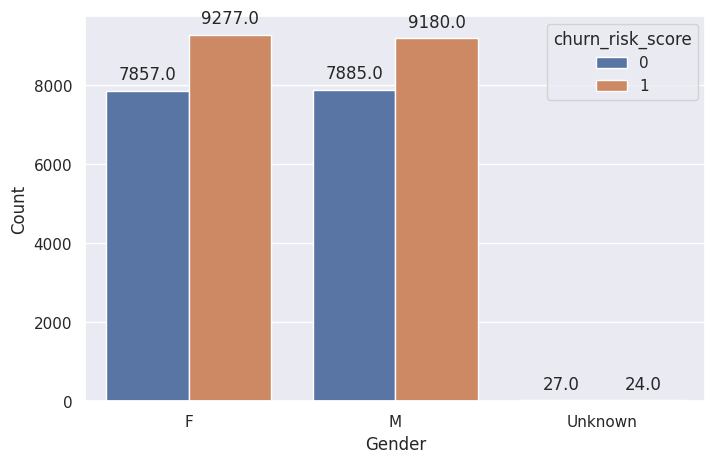

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("gender", "Gender")

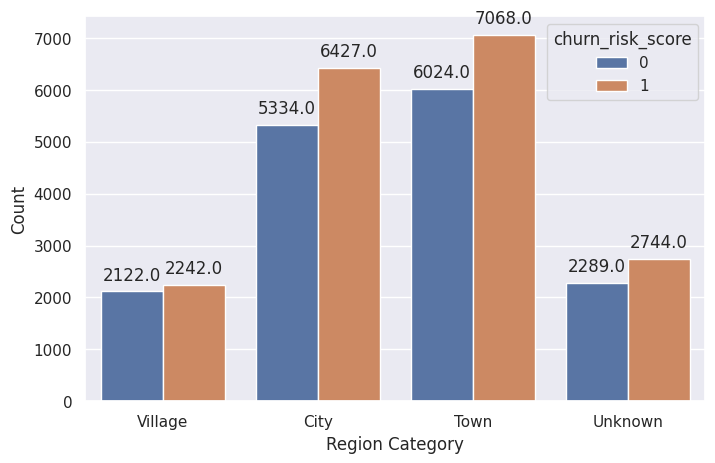

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("region_category", "Region Category")

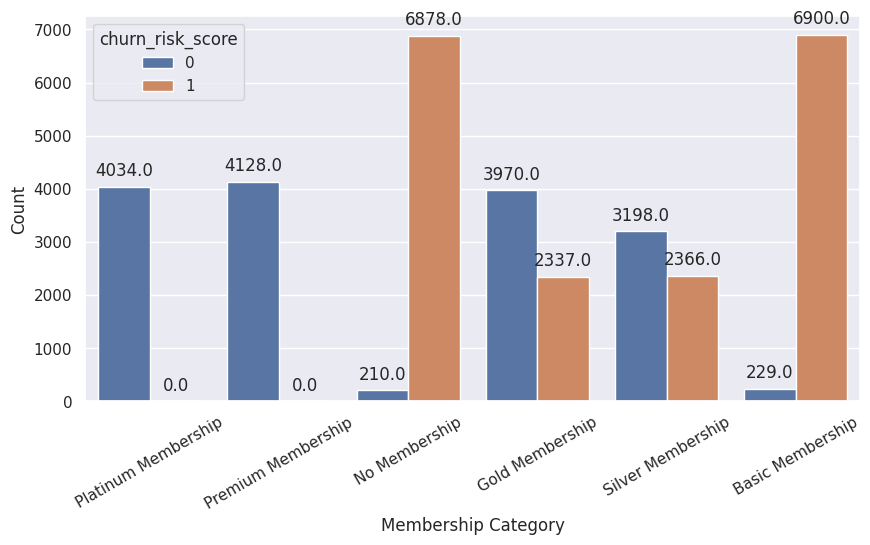

In [ ]:
plt.figure(figsize=(10,5))
CountPlot("membership_category", "Membership Category", 30)

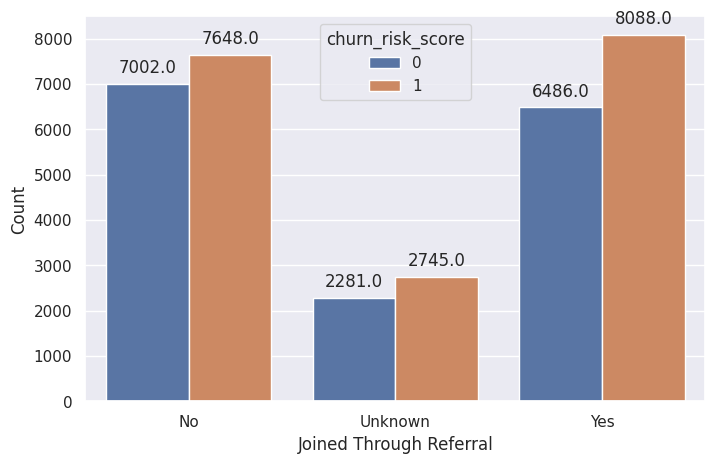

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("joined_through_referral", "Joined Through Referral")

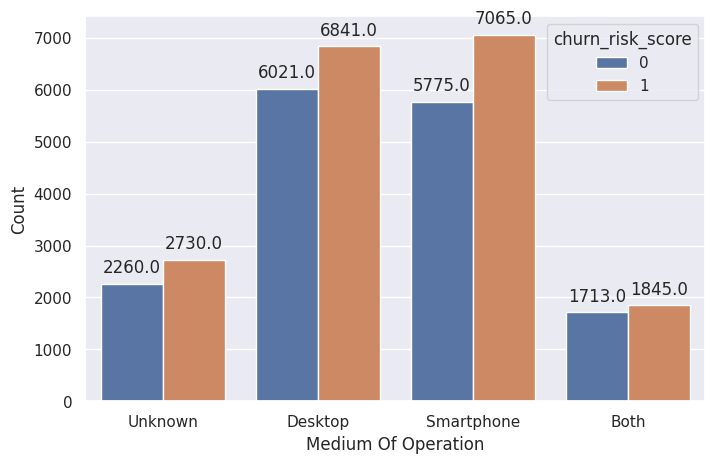

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("medium_of_operation", "Medium Of Operation")

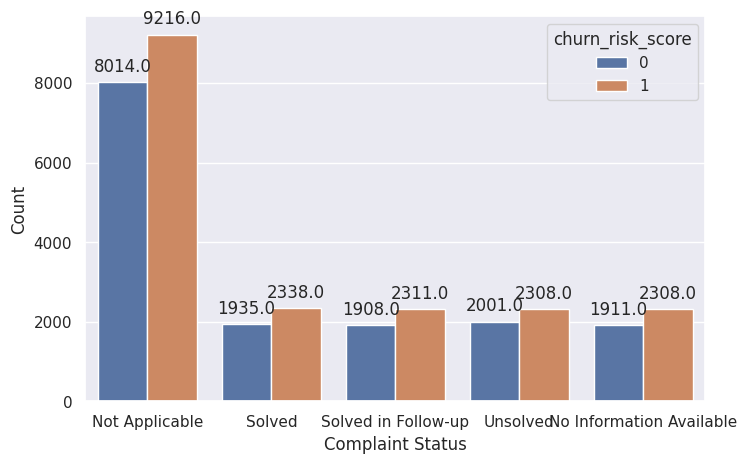

In [ ]:
plt.figure(figsize=(8,5))
CountPlot("complaint_status", "Complaint Status")

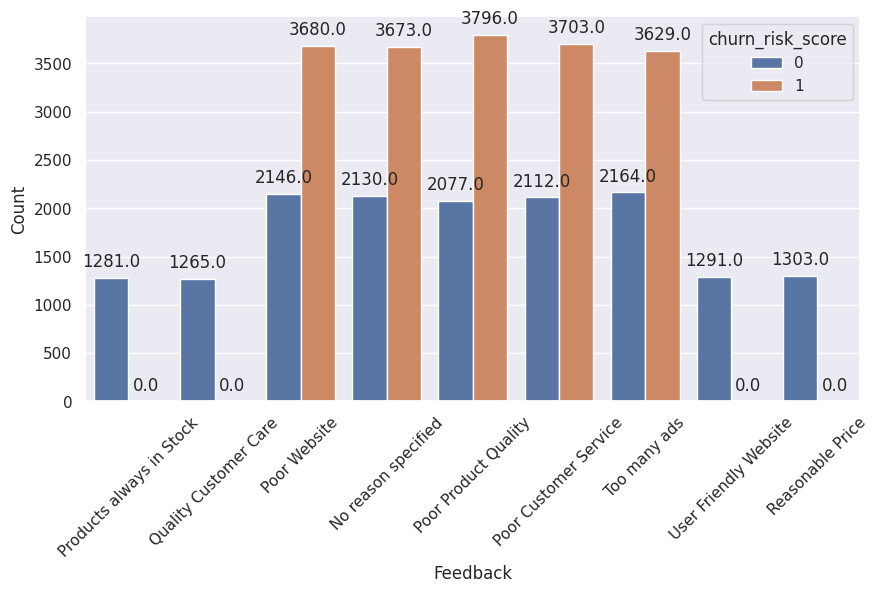

In [ ]:
plt.figure(figsize=(10,5))
CountPlot("feedback", "Feedback", 45)

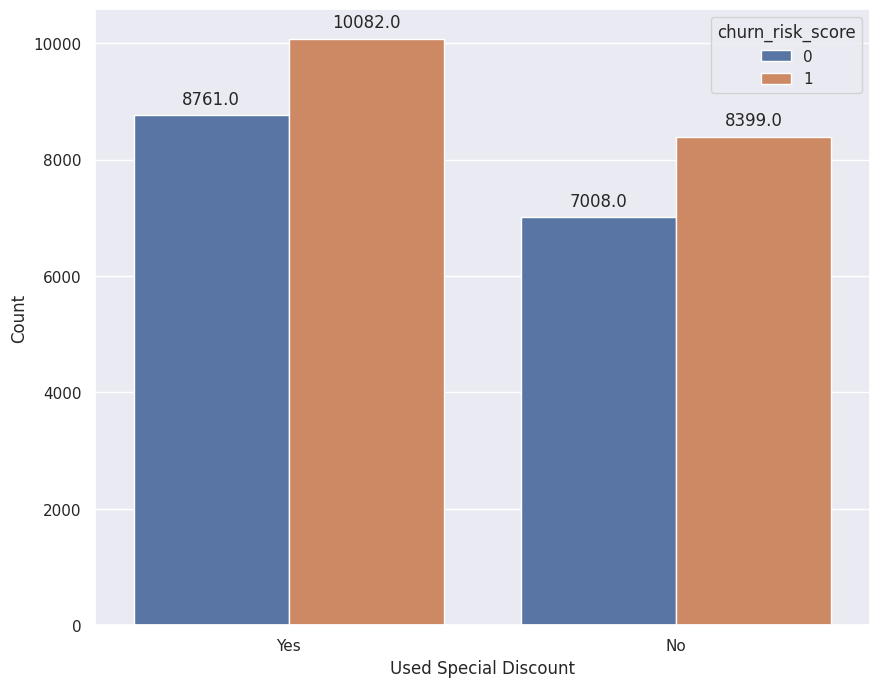

In [ ]:
plt.figure(figsize=(10,8))
CountPlot("used_special_discount", "Used Special Discount")

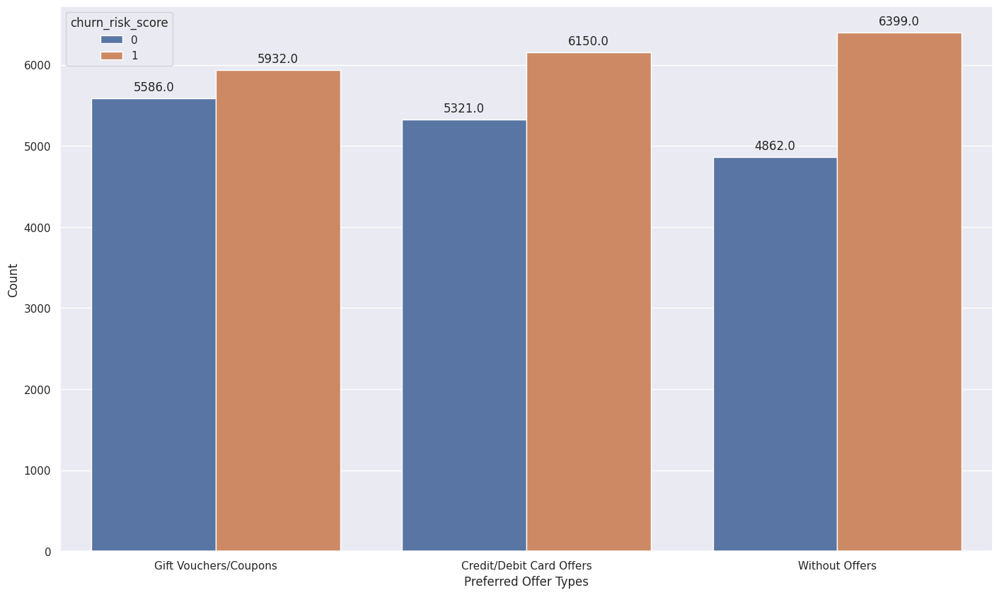

In [ ]:
plt.figure(figsize=(17,10))
CountPlot("preferred_offer_types", "Preferred Offer Types")

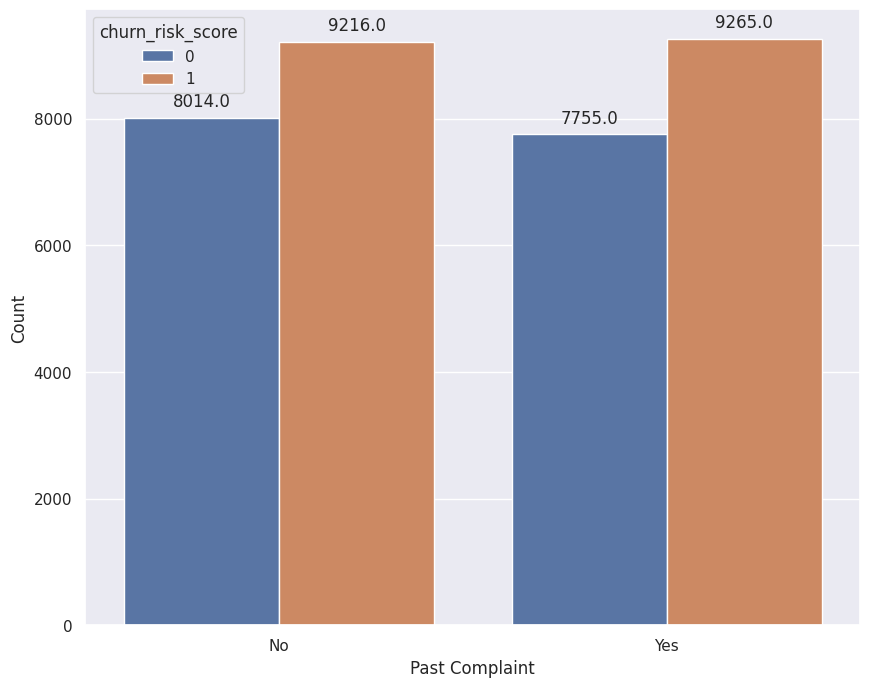

In [ ]:
plt.figure(figsize=(10,8))
CountPlot("past_complaint", "Past Complaint")

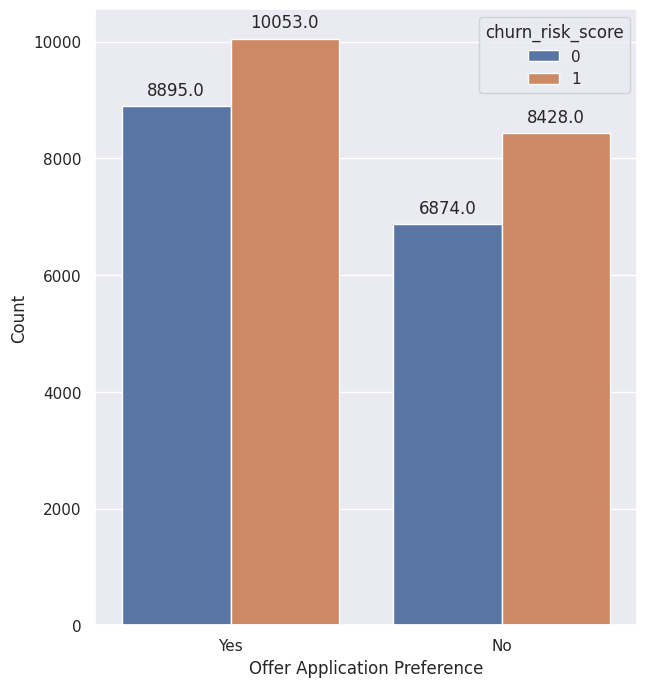

In [ ]:
plt.figure(figsize=(7,8))
CountPlot("offer_application_preference", "Offer Application Preference")

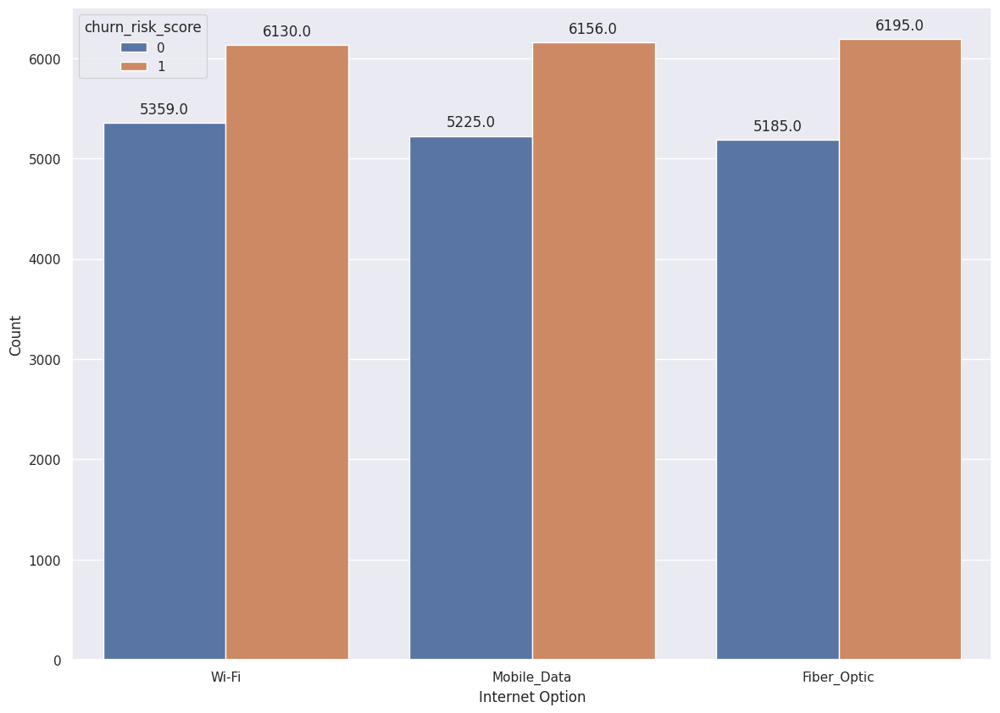

In [ ]:
plt.figure(figsize=(14,10))
CountPlot("internet_option", "Internet Option")

Text(0.5, 1.0, 'age distribution by churn_risk_score')

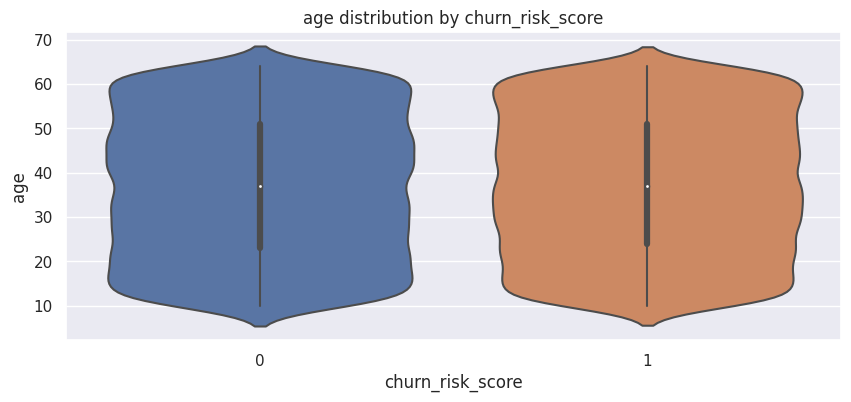

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='age', data=data)  #hue = 'churn_risk_score',
plt.title('age distribution by churn_risk_score')

Text(0.5, 1.0, 'avg_transaction_value distribution by churn_risk_score')

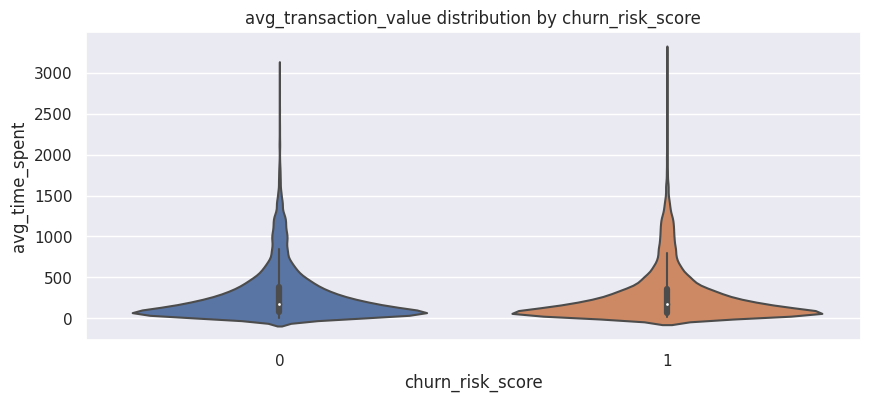

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='avg_time_spent', data=data)
plt.title('avg_transaction_value distribution by churn_risk_score')

Text(0.5, 1.0, 'avg_transaction_value distribution by churn_risk_score')

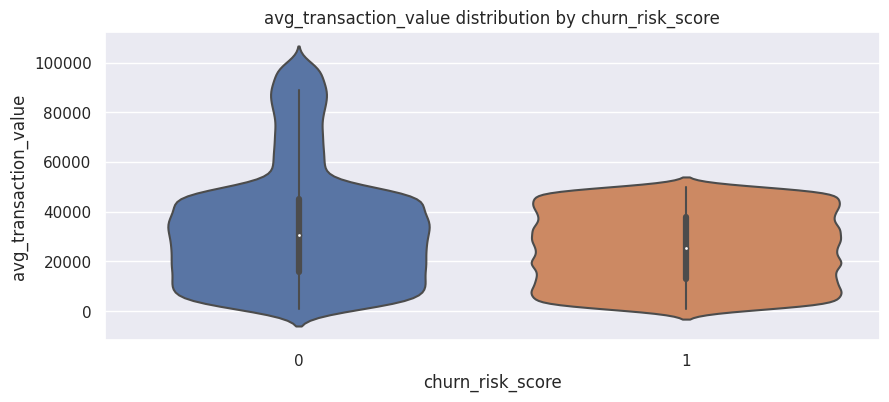

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='avg_transaction_value', data=data)
plt.title('avg_transaction_value distribution by churn_risk_score')

Text(0.5, 1.0, 'points_in_wallet distribution by churn_risk_score')

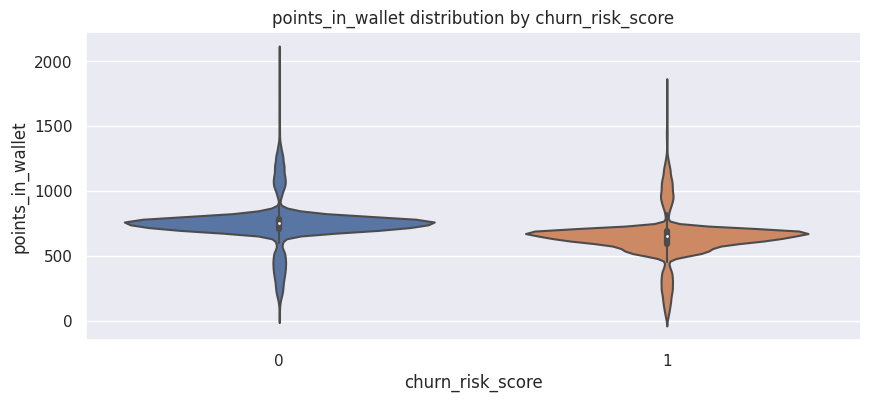

In [ ]:
plt.figure(figsize=(10,4))
sns.violinplot(x='churn_risk_score', y='points_in_wallet', data=data)
plt.title('points_in_wallet distribution by churn_risk_score')

<Axes: xlabel='churn_risk_score', ylabel='count'>

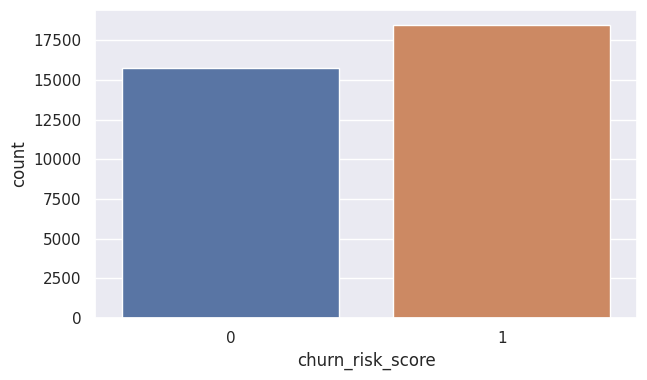

In [ ]:
plt.figure(figsize=(7,4))
#plt.title('Churn Count')
sns.countplot(x=data.churn_risk_score)

# ข้อมูล Target มีความ Imbalance เล็กน้อย

In [ ]:
data['churn_risk_score'].value_counts()

1    18481
0    15769
Name: churn_risk_score, dtype: int64

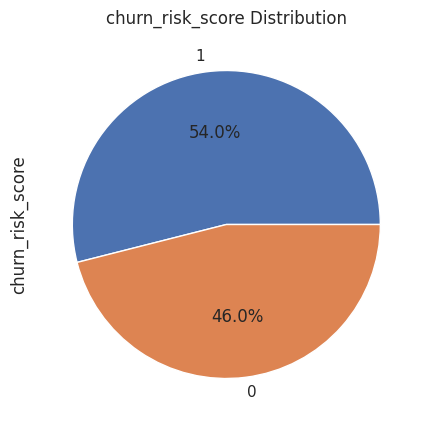

In [ ]:
plt.figure(figsize=(8,5))
data['churn_risk_score'].value_counts().plot.pie(autopct='%1.1f%%')
plt.title("churn_risk_score Distribution")
plt.show()

In [ ]:
data.describe()

,index,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,churn_risk_score
count,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000,34250.000000
mean,18508.593693,37.117635,66.369431,292.450552,29253.835764,16.475932,690.034748,0.539591
std,10681.609380,15.859211,223.623608,331.545641,19475.385199,7.962363,177.108824,0.498437
min,0.000000,10.000000,1.000000,1.837399,800.460000,0.009208,6.432208,0.000000
25%,9266.250000,23.000000,9.000000,71.470000,14163.282500,10.000000,625.215000,0.000000
50%,18497.500000,37.000000,13.000000,174.005000,27469.545000,15.976715,686.882199,1.000000
75%,27772.750000,51.000000,18.000000,370.717500,40784.997500,22.000000,757.137500,1.000000
max,36991.000000,64.000000,999.000000,3235.578521,99914.050000,73.061995,2069.069761,1.000000


In [ ]:
data.describe(include='object')

,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,medium_of_operation,internet_option,last_visit_time,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback
count,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250,34250
unique,3,34250,4,6,1096,3,10860,3,4,3,28291,2,2,2,5,9
top,F,XW0DQ7H,Town,Basic Membership,2015-06-02,No,xxxxxxxx,Gift Vouchers/Coupons,Desktop,Wi-Fi,07:56:41,Yes,Yes,No,Not Applicable,Poor Product Quality
freq,17134,1,13092,7129,52,14650,16515,11518,12862,11489,6,18843,18948,17230,17230,5873


In [ ]:
mode_x = data['age'].mode()
print(mode_x)

0    42
Name: age, dtype: int64


In [ ]:
mode_x1 = data['days_since_last_login'].mode()
print(mode_x1)

0    12
Name: days_since_last_login, dtype: int64


In [ ]:
mode_x2 = data['avg_time_spent'].mode()
print(mode_x2)

0    33.68
1    34.10
2    34.71
Name: avg_time_spent, dtype: float64


In [ ]:
mode_x3 = data['avg_transaction_value'].mode()
print(mode_x3)

0      1603.36
1      2097.09
2      2265.35
3      2279.58
4      2867.47
        ...   
83    48440.34
84    48790.61
85    48989.22
86    49165.25
87    61756.98
Name: avg_transaction_value, Length: 88, dtype: float64


In [ ]:
mode_x4 = data['avg_frequency_login_days'].mode()
print(mode_x4)

0    15.976715
Name: avg_frequency_login_days, dtype: float64


In [ ]:
mode_x5 = data['points_in_wallet'].mode()
print(mode_x5)

0    686.882199
Name: points_in_wallet, dtype: float64


In [ ]:
median_y = data['age'].median()
print(median_y)

37.0


In [ ]:
median_y1 = data['days_since_last_login'].median()
print(median_y1)

13.0


In [ ]:
median_y2 = data['avg_time_spent'].median()
print(median_y2)

174.005


In [ ]:
median_y3 = data['avg_transaction_value'].median()
print(median_y3)

27469.545


In [ ]:
median_y4= data['avg_frequency_login_days'].median()
print(median_y4)

15.976715237406284


In [ ]:
median_y5 = data['points_in_wallet'].median()
print(median_y5)

686.8821987429081


In [ ]:
median_y11111 = subset_0['points_in_wallet'].median()
print(median_y11111)

749.33


In [ ]:
median_y00 = subset_1['points_in_wallet'].median()
print(median_y00)

648.41


In [ ]:
median_y7 = subset_1['avg_time_spent'].mode()
print(median_y7)

0    31.49
1    34.71
Name: avg_time_spent, dtype: float64


In [ ]:
median_y8 = subset_0['avg_time_spent'].mode()
print(median_y8)

0    33.68
Name: avg_time_spent, dtype: float64


In [ ]:
median_y8 = subset_0['avg_transaction_value'].mode()
print(median_y8)

0     12182.94
1     13626.76
2     17755.38
3     18002.25
4     23318.42
5     37388.33
6     37718.91
7     38686.35
8     42972.40
9     45635.76
10    46907.01
11    48338.57
12    61756.98
Name: avg_transaction_value, dtype: float64


In [ ]:
median_y7 = subset_1['avg_transaction_value'].mode()
print(median_y7)

0      2265.35
1      2867.47
2      3432.73
3      3561.94
4      4407.26
5      6801.07
6      6970.80
7      6971.96
8      7282.58
9     10616.35
10    12557.03
11    12664.76
12    14245.33
13    21969.88
14    23142.51
15    23702.75
16    26008.94
17    26705.40
18    28492.90
19    29224.20
20    32574.49
21    33922.27
22    35460.38
23    36471.19
24    39623.10
25    40613.31
26    45804.25
27    46600.57
28    47358.60
29    48989.22
30    49165.25
Name: avg_transaction_value, dtype: float64


กดหนด XY

In [ ]:
#X=data[['gender', 'region_category', 'membership_category',
  #     'joined_through_referral', 'preferred_offer_types',
#       'medium_of_operation', 'internet_option', 'used_special_discount',
##       'offer_application_preference', 'past_complaint', 'complaint_status',
 #      'feedback', 'age', 'days_since_last_login', 'avg_time_spent',
 #      'avg_transaction_value', 'avg_frequency_login_days',
 #      'points_in_wallet']]
#y=data['churn_risk_score']

In [ ]:
#X.shape

In [ ]:
#y.shape

#ต้องทำ preprocessor

#เลือกตัวแปรที่สำคัญ

#**Split data into train and test sets**
from sklearn.model_selection import train_test_split
ทำการแย่งแยกออกก่อน เพื่อป้องกัน data leakage

In [ ]:
#train_df, test_df = train_test_split(data, test_size=0.2, random_state=0)

In [ ]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
#โดย test_size = 0.2 หมายถึงว่า กำหนดให้จำนวน data ใน test set = 20% ของทั้งหมด และ random_state = 42 คือการใส่ไว้เหมือนให้คอมพิวเตอร์จำชุดข้อมูลนี้ที่เราแบ่งไว้ได้ ไม่เช่นนั้นหากเรารันใหม่ train_set เราก็จะเปลี่ยนไปทุกรอบครับ

In [ ]:
train_df, test_df = train_test_split(data, test_size=0.2, random_state=0)

In [ ]:
train_df.head(5)

,index,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,...,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
10488,11349,30,M,RK3SXOD,Town,Silver Membership,2016-05-23,Yes,CID51264,Without Offers,...,58.90,38478.65,10.0,709.29,Yes,No,No,Not Applicable,No reason specified,1
8463,9156,55,F,C188G1Y,Town,Silver Membership,2017-06-20,No,xxxxxxxx,Credit/Debit Card Offers,...,80.76,8815.31,13.0,661.42,Yes,No,Yes,Unsolved,No reason specified,1
6036,6533,60,M,SSOBUM7,Town,Premium Membership,2017-01-26,Yes,CID9745,Without Offers,...,95.40,7270.76,14.0,765.47,Yes,No,Yes,Unsolved,Poor Website,0
30144,32562,21,F,ZRIK02C,City,Basic Membership,2016-06-18,No,xxxxxxxx,Credit/Debit Card Offers,...,183.22,40971.53,17.0,656.29,Yes,No,Yes,No Information Available,Poor Product Quality,0
18721,20237,33,M,A7MJ4XT,City,No Membership,2016-08-02,Unknown,CID35428,Gift Vouchers/Coupons,...,50.40,47226.13,22.0,637.74,No,Yes,No,Not Applicable,No reason specified,1


In [ ]:
train_df.shape

(27400, 24)

In [ ]:
test_df.columns

Index(['index', 'age', 'gender', 'security_no', 'region_category',
       'membership_category', 'joining_date', 'joined_through_referral',
       'referral_id', 'preferred_offer_types', 'medium_of_operation',
       'internet_option', 'last_visit_time', 'days_since_last_login',
       'avg_time_spent', 'avg_transaction_value', 'avg_frequency_login_days',
       'points_in_wallet', 'used_special_discount',
       'offer_application_preference', 'past_complaint', 'complaint_status',
       'feedback', 'churn_risk_score'],
      dtype='object')

In [ ]:
test_df.shape

(6850, 24)

In [ ]:
X_train=train_df[['gender', 'region_category', 'membership_category',
       'joined_through_referral', 'preferred_offer_types',
       'medium_of_operation', 'internet_option', 'used_special_discount',
       'offer_application_preference', 'past_complaint', 'complaint_status',
       'feedback', 'age', 'days_since_last_login', 'avg_time_spent',
       'avg_transaction_value', 'avg_frequency_login_days',
       'points_in_wallet']]
y_train=train_df['churn_risk_score']

In [ ]:
X_train.shape

(27400, 18)

In [ ]:
X_train.columns

Index(['gender', 'region_category', 'membership_category',
       'joined_through_referral', 'preferred_offer_types',
       'medium_of_operation', 'internet_option', 'used_special_discount',
       'offer_application_preference', 'past_complaint', 'complaint_status',
       'feedback', 'age', 'days_since_last_login', 'avg_time_spent',
       'avg_transaction_value', 'avg_frequency_login_days',
       'points_in_wallet'],
      dtype='object')

In [ ]:
y_train.shape

(27400,)

In [ ]:
X_test=test_df[['gender', 'region_category', 'membership_category',
       'joined_through_referral', 'preferred_offer_types',
       'medium_of_operation', 'internet_option', 'used_special_discount',
       'offer_application_preference', 'past_complaint', 'complaint_status',
       'feedback', 'age', 'days_since_last_login', 'avg_time_spent',
       'avg_transaction_value', 'avg_frequency_login_days',
       'points_in_wallet']]
y_test=test_df['churn_risk_score']

In [ ]:
X_test.shape

(6850, 18)

In [ ]:
y_test.shape

(6850,)

In [ ]:
y_train.value_counts()

1    14735
0    12665
Name: churn_risk_score, dtype: int64

In [ ]:
y_test.value_counts()

1    3746
0    3104
Name: churn_risk_score, dtype: int64

In [ ]:
# Define the categorical and numeric features
categorical_features = ['gender','region_category','membership_category','joined_through_referral','preferred_offer_types','medium_of_operation','internet_option',
                        'used_special_discount','offer_application_preference','past_complaint','complaint_status','feedback']
numeric_features = ['age', 'days_since_last_login','avg_time_spent','avg_transaction_value','avg_frequency_login_days','points_in_wallet']

In [ ]:

from sklearn.preprocessing import StandardScaler


In [ ]:
# Define the preprocessor using ColumnTransformer

preprocessor = make_column_transformer(
     (
        make_pipeline(OneHotEncoder()),
        categorical_features,
    ),
    (
        StandardScaler(),
        numeric_features,
    ),
)


In [ ]:
# Fit and transform the training data
X_train_preprocessed = preprocessor.fit_transform(X_train)

# Get the column names for the one-hot encoded features
ohe_feature_names = preprocessor.named_transformers_['pipeline'].named_steps['onehotencoder'].get_feature_names_out(categorical_features)

# Combine the column names for the preprocessed data
feature_names = list(ohe_feature_names) + numeric_features

# Create a DataFrame for the preprocessed data
X_train_transformed = pd.DataFrame(X_train_preprocessed, columns=feature_names)

In [ ]:
X_train_transformed.head(10)

,gender_F,gender_M,gender_Unknown,region_category_City,region_category_Town,region_category_Unknown,region_category_Village,membership_category_Basic Membership,membership_category_Gold Membership,membership_category_No Membership,...,feedback_Quality Customer Care,feedback_Reasonable Price,feedback_Too many ads,feedback_User Friendly Website,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet
0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,-0.445852,-0.226125,-0.701277,0.473173,-0.811447,0.101208
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.129898,-0.217210,-0.635571,-1.049709,-0.435826,-0.167526
2,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.445048,-0.235040,-0.591567,-1.129004,-0.310619,0.416593
3,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,-1.013122,-0.221667,-0.327602,0.601155,0.065002,-0.196325
4,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,-0.256762,-0.243955,-0.726826,0.922259,0.691037,-0.300461
5,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,-1.454332,-0.217210,0.523656,-0.513159,-0.060205,0.350631
6,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.499598,-0.248412,-0.773475,0.447931,-0.063121,0.405646
7,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.184448,-0.212753,-0.507166,1.616168,-1.813103,3.706392
8,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.571108,-0.208295,-0.530400,-0.847744,0.315416,-0.287999
9,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,-1.202212,-0.203838,-0.520541,3.171923,0.315416,0.686562


In [ ]:
X_train_transformed.shape

(27400, 52)

In [ ]:
# Fit and transform the training data
X_test_preprocessor = preprocessor.fit_transform(X_test)

# Get the column names for the one-hot encoded features
ohe_feature_names = preprocessor.named_transformers_['pipeline'].named_steps['onehotencoder'].get_feature_names_out(categorical_features)

# Combine the column names for the preprocessed data
feature_names = list(ohe_feature_names) + numeric_features

# Create a DataFrame for the preprocessed data
X_test_transformed = pd.DataFrame(X_test_preprocessor, columns=feature_names)

In [ ]:
X_test_transformed.head(5)

,gender_F,gender_M,gender_Unknown,region_category_City,region_category_Town,region_category_Unknown,region_category_Village,membership_category_Basic Membership,membership_category_Gold Membership,membership_category_No Membership,...,feedback_Quality Customer Care,feedback_Reasonable Price,feedback_Too many ads,feedback_User Friendly Website,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet
0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.423604,-0.199044,-0.388662,2.989253,-1.329750,2.060747
1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,-0.144871,-0.199044,-0.798600,-0.835902,-0.060987,-2.794516
2,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.623719,-0.221699,-0.729125,0.636272,-0.312371,-0.432364
3,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,-0.776511,-0.253415,2.004885,-0.214456,0.323491,-0.001951
4,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,-0.460691,-0.217168,0.671363,2.863972,0.323491,0.431644


In [ ]:
X_test_transformed.shape

(6850, 52)

In [ ]:
X_test_transformed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6850 entries, 0 to 6849
Data columns (total 52 columns):
 #   Column                                          Non-Null Count  Dtype  
---  ------                                          --------------  -----  
 0   gender_F                                        6850 non-null   float64
 1   gender_M                                        6850 non-null   float64
 2   gender_Unknown                                  6850 non-null   float64
 3   region_category_City                            6850 non-null   float64
 4   region_category_Town                            6850 non-null   float64
 5   region_category_Unknown                         6850 non-null   float64
 6   region_category_Village                         6850 non-null   float64
 7   membership_category_Basic Membership            6850 non-null   float64
 8   membership_category_Gold Membership             6850 non-null   float64
 9   membership_category_No Membership        

In [ ]:
X_train_transformed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27400 entries, 0 to 27399
Data columns (total 52 columns):
 #   Column                                          Non-Null Count  Dtype  
---  ------                                          --------------  -----  
 0   gender_F                                        27400 non-null  float64
 1   gender_M                                        27400 non-null  float64
 2   gender_Unknown                                  27400 non-null  float64
 3   region_category_City                            27400 non-null  float64
 4   region_category_Town                            27400 non-null  float64
 5   region_category_Unknown                         27400 non-null  float64
 6   region_category_Village                         27400 non-null  float64
 7   membership_category_Basic Membership            27400 non-null  float64
 8   membership_category_Gold Membership             27400 non-null  float64
 9   membership_category_No Membership      

#เลือกตัวแปรที่สำคัญเอาไปเทรน

In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
# สร้างโมเดล Random Forest
rf_importance = RandomForestClassifier(random_state=42)

In [ ]:
rf_importance.fit(X_train_transformed,y_train)

RandomForestClassifier(random_state=42)

class sklearn.ensemble.RandomForestClassifier(n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None

In [ ]:
rf_importance   #โดยใช้ค่าตั้งต้นของ RF ใน Sklearn

RandomForestClassifier(random_state=42)

In [ ]:
y_predict_importance =rf_importance.predict(X_test_transformed)

In [ ]:
accuracy_score(y_test,y_predict_importance)

0.9254014598540146

In [ ]:
# หา Feature Importance
feature_importance = pd.DataFrame(rf_importance.feature_importances_,
                                  index=X_train_transformed.columns,
                                  columns=["Importance"]).sort_values("Importance", ascending=False)
feature_importance

,Importance
points_in_wallet,0.305142
membership_category_No Membership,0.127159
membership_category_Basic Membership,0.117295
membership_category_Platinum Membership,0.069479
membership_category_Premium Membership,0.069087
avg_transaction_value,0.048781
avg_frequency_login_days,0.023275
avg_time_spent,0.022968
age,0.020319
days_since_last_login,0.018047


# ดูกราฟ ตัวแปรที่สำคัญ

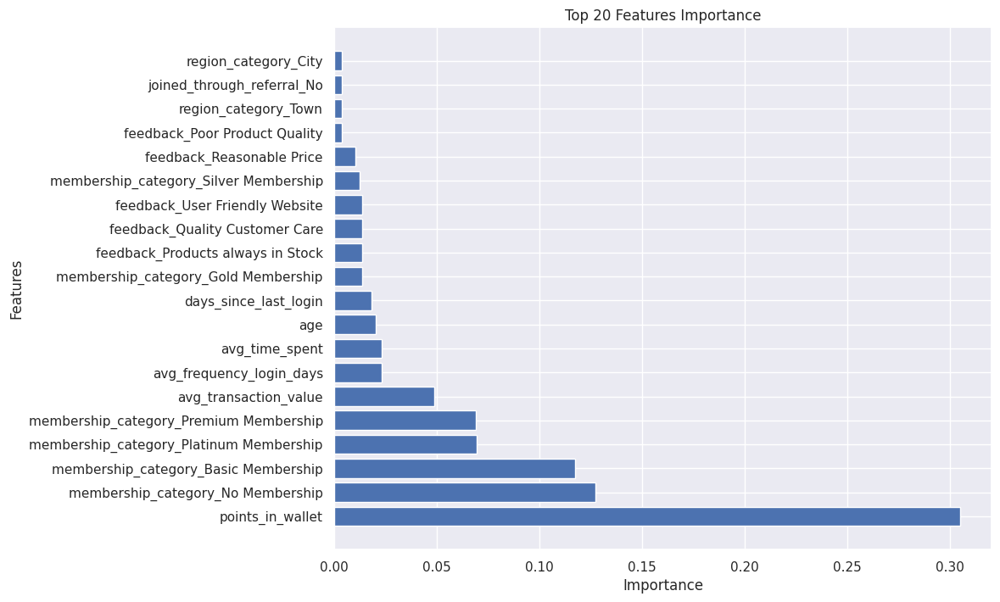

In [ ]:
# สร้าง DataFrame เพื่อเก็บ Feature Importance
feature_importance_df = pd.DataFrame({
    'Features': X_train_transformed.columns,
    'Importance': rf_importance.feature_importances_
})

# เรียงลำดับ Feature Importance จากมากไปน้อย
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# สร้าง plot แสดง Features Importance 20 อันดับแรก
top_n = 20
plt.figure(figsize=(10, 8))
plt.barh(feature_importance_df['Features'][:top_n], feature_importance_df['Importance'][:top_n])
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Top 20 Features Importance')
plt.show()




จากสังเกตุว่า points_in_wallet เป็นตัวแปรที่สำคัญมากที่สุด
รองลงมาก็ membership_category
avg_transaction_value
avg_frequency_login_days
avg_time_spent
age
days_since_last_login
feedback

#**Feature Selection (การเลือกตัวแปรที่สำคัญ)**
 การไม่ใช้ SMOTE อาจทำให้คุณได้ Feature Importance ที่ตรงกับข้อมูลที่มีจริงโดยที่ไม่ต้องเพิ่มข้อมูลเท็จๆ เข้าไป

In [ ]:
# ดึงตัวแปรที่สำคัญ 16 ตัว  โดยเลือกจากค่าความสำคัญต้องมีค่ามากกว่า 0.0100 เป็นต้นไป
top_features = feature_importance.head(16)

# แสดงตัวแปรที่สำคัญ 16 ตัว
print(top_features)

                                         Importance
points_in_wallet                           0.305142
membership_category_No Membership          0.127159
membership_category_Basic Membership       0.117295
membership_category_Platinum Membership    0.069479
membership_category_Premium Membership     0.069087
avg_transaction_value                      0.048781
avg_frequency_login_days                   0.023275
avg_time_spent                             0.022968
age                                        0.020319
days_since_last_login                      0.018047
membership_category_Gold Membership        0.013572
feedback_Products always in Stock          0.013551
feedback_Quality Customer Care             0.013449
feedback_User Friendly Website             0.013386
membership_category_Silver Membership      0.012338
feedback_Reasonable Price                  0.010362


In [ ]:
#from sklearn.feature_selection import SelectKBest, f_classif
# Initialize SelectKBest with f_classif as score function
#sel_kbest = SelectKBest(score_func=f_classif, k=16)

# Fit SelectKBest to the preprocessed data
#sel_kbest.fit(X_train_transformed, y_train)

# Get the selected feature indices
#selected_feature_indices = sel_kbest.get_support(indices=True)

# Get the column names of the selected features
#selected_feature_names = X_train_transformed.columns[selected_feature_indices]

#print(selected_feature_names)

In [ ]:
X_train_transformed.head(5)

,gender_F,gender_M,gender_Unknown,region_category_City,region_category_Town,region_category_Unknown,region_category_Village,membership_category_Basic Membership,membership_category_Gold Membership,membership_category_No Membership,...,feedback_Quality Customer Care,feedback_Reasonable Price,feedback_Too many ads,feedback_User Friendly Website,age,days_since_last_login,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet
0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,-0.445852,-0.226125,-0.701277,0.473173,-0.811447,0.101208
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.129898,-0.217210,-0.635571,-1.049709,-0.435826,-0.167526
2,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.445048,-0.235040,-0.591567,-1.129004,-0.310619,0.416593
3,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,-1.013122,-0.221667,-0.327602,0.601155,0.065002,-0.196325
4,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,-0.256762,-0.243955,-0.726826,0.922259,0.691037,-0.300461


In [ ]:
X_train_transformed.shape

(27400, 52)

In [ ]:
X_test_transformed.shape

(6850, 52)

In [ ]:
# Assume X_train_transformed is already defined and contains the transformed data
selected_columns =[
    'membership_category_Basic Membership',
    'membership_category_Gold Membership',
    'membership_category_No Membership',
    'membership_category_Platinum Membership',
    'membership_category_Premium Membership',
    'membership_category_Silver Membership',
    'feedback_Products always in Stock',
    'feedback_Quality Customer Care',
    'feedback_Reasonable Price',
    'feedback_User Friendly Website',
    'avg_transaction_value',
    'avg_frequency_login_days',
    'points_in_wallet',
    'avg_time_spent',
    'age',
    'days_since_last_login'
]


In [ ]:
X_train_selected = X_train_transformed[selected_columns]
X_train_selected.head(5)

,membership_category_Basic Membership,membership_category_Gold Membership,membership_category_No Membership,membership_category_Platinum Membership,membership_category_Premium Membership,membership_category_Silver Membership,feedback_Products always in Stock,feedback_Quality Customer Care,feedback_Reasonable Price,feedback_User Friendly Website,avg_transaction_value,avg_frequency_login_days,points_in_wallet,avg_time_spent,age,days_since_last_login
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.473173,-0.811447,0.101208,-0.701277,-0.445852,-0.226125
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,-1.049709,-0.435826,-0.167526,-0.635571,1.129898,-0.217210
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,-1.129004,-0.310619,0.416593,-0.591567,1.445048,-0.235040
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.601155,0.065002,-0.196325,-0.327602,-1.013122,-0.221667
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.922259,0.691037,-0.300461,-0.726826,-0.256762,-0.243955


In [ ]:
X_test_selected = X_test_transformed[selected_columns]
X_test_selected.head(5)

,membership_category_Basic Membership,membership_category_Gold Membership,membership_category_No Membership,membership_category_Platinum Membership,membership_category_Premium Membership,membership_category_Silver Membership,feedback_Products always in Stock,feedback_Quality Customer Care,feedback_Reasonable Price,feedback_User Friendly Website,avg_transaction_value,avg_frequency_login_days,points_in_wallet,avg_time_spent,age,days_since_last_login
0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,2.989253,-1.329750,2.060747,-0.388662,0.423604,-0.199044
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.835902,-0.060987,-2.794516,-0.798600,-0.144871,-0.199044
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.636272,-0.312371,-0.432364,-0.729125,1.623719,-0.221699
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.214456,0.323491,-0.001951,2.004885,-0.776511,-0.253415
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,2.863972,0.323491,0.431644,0.671363,-0.460691,-0.217168


In [ ]:
# Assume X_train_selected and y_train are defined

# Create a DataFrame for the selected features
#selected_features_df = pd.DataFrame(X_train_selected, columns=X_train_selected.columns)

# Add the 'churn_risk_score' column from y_train to the DataFrame#
#selected_features_df['churn_risk_score'] = y_train


In [ ]:
#selected_features_df.head(5)

In [ ]:
# Assume X_train_selected and y_train are defined

# Create a DataFrame for the selected features
#selected_features_test = pd.DataFrame(X_test_selected, columns=X_test_selected.columns)

# Add the 'churn_risk_score' column from y_train to the DataFrame๒
#selected_features_test['churn_risk_score'] = y_test

In [ ]:
X_train_selected.shape

(27400, 16)

In [ ]:
X_train_selected.shape

(27400, 16)

In [ ]:
y_test.shape

(6850,)

In [ ]:
y_train.shape

(27400,)

In [ ]:
#selected_features_test.head(5)

In [ ]:
y_test.head(5)

32610    0
7583     0
31319    1
15824    1
394      0
Name: churn_risk_score, dtype: int64

In [ ]:
y_train.head(5)

10488    1
8463     1
6036     0
30144    0
18721    1
Name: churn_risk_score, dtype: int64

In [ ]:
train_df.head(5)

,index,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,...,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
10488,11349,30,M,RK3SXOD,Town,Silver Membership,2016-05-23,Yes,CID51264,Without Offers,...,58.90,38478.65,10.0,709.29,Yes,No,No,Not Applicable,No reason specified,1
8463,9156,55,F,C188G1Y,Town,Silver Membership,2017-06-20,No,xxxxxxxx,Credit/Debit Card Offers,...,80.76,8815.31,13.0,661.42,Yes,No,Yes,Unsolved,No reason specified,1
6036,6533,60,M,SSOBUM7,Town,Premium Membership,2017-01-26,Yes,CID9745,Without Offers,...,95.40,7270.76,14.0,765.47,Yes,No,Yes,Unsolved,Poor Website,0
30144,32562,21,F,ZRIK02C,City,Basic Membership,2016-06-18,No,xxxxxxxx,Credit/Debit Card Offers,...,183.22,40971.53,17.0,656.29,Yes,No,Yes,No Information Available,Poor Product Quality,0
18721,20237,33,M,A7MJ4XT,City,No Membership,2016-08-02,Unknown,CID35428,Gift Vouchers/Coupons,...,50.40,47226.13,22.0,637.74,No,Yes,No,Not Applicable,No reason specified,1


In [ ]:
test_df.head(5)

,index,age,gender,security_no,region_category,membership_category,joining_date,joined_through_referral,referral_id,preferred_offer_types,...,avg_time_spent,avg_transaction_value,avg_frequency_login_days,points_in_wallet,used_special_discount,offer_application_preference,past_complaint,complaint_status,feedback,churn_risk_score
32610,35221,44,M,OWTAFDF,City,Premium Membership,2015-03-01,Yes,CID40063,Credit/Debit Card Offers,...,166.36,87397.43,6.000000,1041.342080,No,Yes,No,Not Applicable,Products always in Stock,0
7583,8210,35,M,PUE36NS,Unknown,Gold Membership,2015-04-14,No,xxxxxxxx,Credit/Debit Card Offers,...,32.36,12953.13,15.976715,202.075096,No,Yes,No,Not Applicable,Poor Customer Service,0
31319,33828,63,M,HU263LH,Town,No Membership,2017-08-24,Yes,CID23121,Without Offers,...,55.07,41604.24,14.000000,610.390000,Yes,No,Yes,No Information Available,Poor Website,1
15824,17101,25,M,4R3N5O3,Village,No Membership,2015-12-11,Yes,CID19181,Without Offers,...,948.76,25047.56,19.000000,684.790000,Yes,No,Yes,Solved in Follow-up,Poor Website,1
394,418,30,M,19ZN4CH,City,Premium Membership,2015-02-15,Yes,CID17765,Credit/Debit Card Offers,...,512.86,84959.24,19.000000,759.740000,No,Yes,No,Not Applicable,Reasonable Price,0


# **ลองจัดการความไม่สมดุลของข้อมูลด้วย SMOTE**

In [ ]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=0)
X_train_sm, y_train_sm = sm.fit_resample(X_train_selected, y_train)

In [ ]:
X_train_sm.shape

(29470, 16)

In [ ]:
X_train_sm.columns

Index(['membership_category_Basic Membership',
       'membership_category_Gold Membership',
       'membership_category_No Membership',
       'membership_category_Platinum Membership',
       'membership_category_Premium Membership',
       'membership_category_Silver Membership',
       'feedback_Products always in Stock', 'feedback_Quality Customer Care',
       'feedback_Reasonable Price', 'feedback_User Friendly Website',
       'avg_transaction_value', 'avg_frequency_login_days', 'points_in_wallet',
       'avg_time_spent', 'age', 'days_since_last_login'],
      dtype='object')

In [ ]:
X_train_sm.head(5)

,membership_category_Basic Membership,membership_category_Gold Membership,membership_category_No Membership,membership_category_Platinum Membership,membership_category_Premium Membership,membership_category_Silver Membership,feedback_Products always in Stock,feedback_Quality Customer Care,feedback_Reasonable Price,feedback_User Friendly Website,avg_transaction_value,avg_frequency_login_days,points_in_wallet,avg_time_spent,age,days_since_last_login
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.473173,-0.811447,0.101208,-0.701277,-0.445852,-0.226125
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,-1.049709,-0.435826,-0.167526,-0.635571,1.129898,-0.217210
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,-1.129004,-0.310619,0.416593,-0.591567,1.445048,-0.235040
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.601155,0.065002,-0.196325,-0.327602,-1.013122,-0.221667
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.922259,0.691037,-0.300461,-0.726826,-0.256762,-0.243955


In [ ]:
y_train_sm.shape

(29470,)

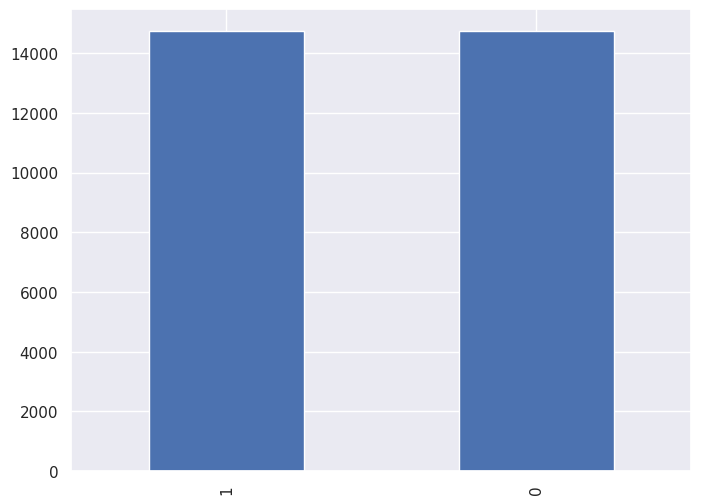

In [ ]:
plt.figure(figsize=(8, 6))
y_train_sm.value_counts().plot(kind="bar");

In [ ]:
y_train_sm.value_counts()

1    14735
0    14735
Name: churn_risk_score, dtype: int64

In [ ]:
data['churn_risk_score'].value_counts()

1    18481
0    15769
Name: churn_risk_score, dtype: int64

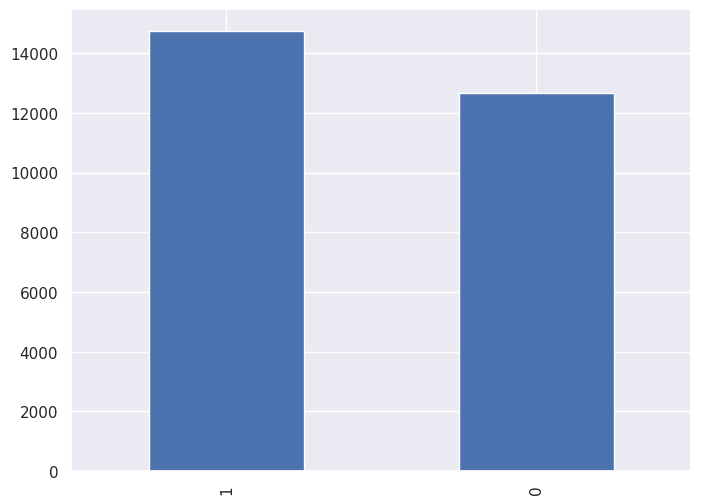

In [ ]:
plt.figure(figsize=(8, 6))
y_train.value_counts().plot(kind="bar");

In [ ]:
y_train.value_counts()

1    14735
0    12665
Name: churn_risk_score, dtype: int64

In [ ]:
y_train_sm.value_counts()

1    14735
0    14735
Name: churn_risk_score, dtype: int64

In [ ]:
y_train.shape

(27400,)

In [ ]:
y_train_sm.shape

(29470,)

#**ขั้นตอนการหา a parameter grid to search for the best hyperparameters**


#GridSearchCV with LGR

In [ ]:

# Create a Logistic Regression model
from sklearn.linear_model import LogisticRegression
lgr = LogisticRegression(random_state=0)



In [ ]:
# Define the parameter grid you want to search over
param_grid_lgr = {
    'C': [0.001, 0.01, 0.1, 1, 10],  # Inverse of regularization strength
    'penalty': ['l1', 'l2'],  # Regularization type
    'solver': ['liblinear', 'saga']  # Optimization algorithm
}

In [ ]:
# Create a GridSearchCV object with the model and parameter grid
grid_search_lgr = GridSearchCV(estimator=lgr, param_grid=param_grid_lgr, cv=5)

# Fit the GridSearchCV object to your data
grid_search_lgr.fit(X_train_selected, y_train)



GridSearchCV(cv=5, estimator=LogisticRegression(random_state=0),
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10],
                         'penalty': ['l1', 'l2'],
                         'solver': ['liblinear', 'saga']})

In [ ]:
# Print the best parameters and best score
print("Best Parameters:", grid_search_lgr.best_params_)
print("Best Score:", grid_search_lgr.best_score_)

Best Parameters: {'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
Best Score: 0.9071532846715329


#เลือกพารามิเตอร์ที่ดีที่สุด

In [ ]:
# Assuming you have the best hyperparameters in best_params_dict
best_params_lgr = {'C': 10, 'penalty': 'l1', 'solver': 'liblinear', 'random_state': 0}

# Create a LogisticRegression model with the best hyperparameters
best_model_lgr = LogisticRegression(**best_params_lgr)


In [ ]:
best_model_lgr

LogisticRegression(C=10, penalty='l1', random_state=0, solver='liblinear')

In [ ]:
start_time = time.time()
lgr_model = best_model_lgr.fit(X_train_selected, y_train)
end_time = time.time()
training_time = end_time - start_time
print("Training time:", training_time, "seconds")

Training time: 0.038537025451660156 seconds


TrainModel Evaluation

In [ ]:
lgr_train_pred = lgr_model.predict(X_train_selected)
print(classification_report(y_train, lgr_train_pred))

              precision    recall  f1-score   support

           0       0.87      0.94      0.90     12665
           1       0.94      0.88      0.91     14735

    accuracy                           0.91     27400
   macro avg       0.91      0.91      0.91     27400
weighted avg       0.91      0.91      0.91     27400



Test Model Evaluation

In [ ]:
lgr_test_pred = best_model_lgr.predict(X_test_selected)
print(classification_report(y_test, lgr_test_pred))

              precision    recall  f1-score   support

           0       0.86      0.94      0.90      3104
           1       0.95      0.87      0.91      3746

    accuracy                           0.90      6850
   macro avg       0.90      0.91      0.90      6850
weighted avg       0.91      0.90      0.90      6850



In [ ]:
lgr_test=confusion_matrix(y_test, lgr_test_pred)
lgr_test

array([[2921,  183],
       [ 475, 3271]])

In [ ]:
tn, fp, fn, tp = confusion_matrix(y_test, lgr_test_pred).ravel()

# Print the values
print("True Negative (TN):", tn)
print("False Positive (FP):", fp)
print("False Negative (FN):", fn)
print("True Positive (TP):", tp)

True Negative (TN): 2921
False Positive (FP): 183
False Negative (FN): 475
True Positive (TP): 3271


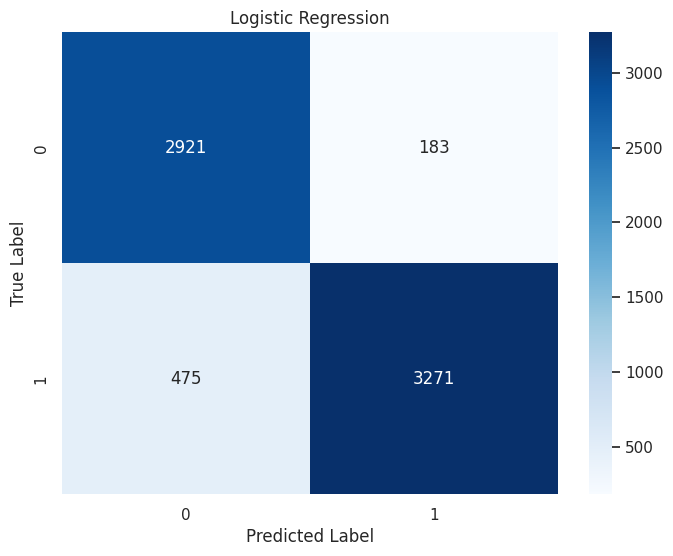

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(lgr_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title("Logistic Regression")
plt.show()

# Confusion Matrix ด้วย heatmap

เนื่องจากแบบจำลอง Logistic Regression ไม่มีแอตทริบิวต์ features_importances_ เช่น โมเดลแบบต้นไม้ (เช่น Random Forest) แต่คุณสามารถดึงข้อมูลความสำคัญของคุณลักษณะได้โดยการดูค่าสัมบูรณ์ของสัมประสิทธิ์

In [ ]:
# หา Feature Importance
# Get the absolute values of the coefficients
coef_abs = np.abs(best_model_lgr.coef_)

# Create a DataFrame to store feature importance
feature_importance_0 = pd.DataFrame(coef_abs[0], index=X_train_selected.columns, columns=["Importance"])

# Sort the features by importance in descending order
feature_importance_0 = feature_importance_0.sort_values(by="Importance", ascending=False)

# Display the feature importance
print(feature_importance_0)

                                         Importance
membership_category_Premium Membership    10.079607
membership_category_Platinum Membership   10.073486
feedback_Reasonable Price                  8.244653
feedback_User Friendly Website             8.228711
feedback_Quality Customer Care             8.195244
feedback_Products always in Stock          8.181529
membership_category_No Membership          3.072026
membership_category_Basic Membership       2.997226
points_in_wallet                           0.426590
membership_category_Gold Membership        0.411750
membership_category_Silver Membership      0.408857
age                                        0.025337
days_since_last_login                      0.011652
avg_frequency_login_days                   0.009343
avg_transaction_value                      0.008418
avg_time_spent                             0.003548


ในการถดถอยโลจิสติก ค่าสัมประสิทธิ์แสดงถึงผลกระทบหรือการมีส่วนร่วมของแต่ละคุณลักษณะต่อการทำนายของแบบจำลอง ค่าสัมบูรณ์ของค่าสัมประสิทธิ์เหล่านี้สามารถใช้เพื่อทำความเข้าใจความสำคัญของคุณลักษณะได้ ต่อไปนี้คือสิ่งที่แต่ละส่วนของรหัสที่คุณให้มาทำหน้าที่:

     coef_abs = np.abs(best_model_lgr.coef_): บรรทัดนี้จะคำนวณค่าสัมบูรณ์ของสัมประสิทธิ์ที่ได้รับจากแบบจำลอง Logistic Regression ที่ดีที่สุด (best_model_lgr) ที่คุณฝึกฝนก่อนหน้านี้โดยใช้ GridSearchCV ค่าสัมบูรณ์ถูกนำมาใช้เพื่อให้แน่ใจว่าผลกระทบทั้งเชิงบวกและเชิงลบของคุณลักษณะได้รับการพิจารณาในความสำคัญของคุณลักษณะ

     คุณลักษณะ_importance_0 = pd.DataFrame(coef_abs[0], index=X_train_selected.columns, columns=["Importance"]): บรรทัดนี้สร้าง DataFrame (feature_importance_0) เพื่อจัดเก็บค่าสัมบูรณ์ของสัมประสิทธิ์ แต่ละค่าสัมประสิทธิ์สอดคล้องกับคุณลักษณะ และชื่อคุณลักษณะจะถูกตั้งค่าเป็นดัชนีของ DataFrame และคอลัมน์มีชื่อว่า "ความสำคัญ"

     คุณลักษณะ_importance_0 = คุณลักษณะ_importance_0.sort_values(by="Importance", ascending=False): บรรทัดนี้จะเรียงลำดับคุณลักษณะใน DataFrame ตามความสำคัญโดยเรียงลำดับจากมากไปน้อย ซึ่งหมายความว่าคุณลักษณะที่สำคัญที่สุดจะปรากฏที่ด้านบนของ DataFrame

     print(feature_importance_0): สุดท้าย บรรทัดนี้จะพิมพ์ DataFrame ซึ่งแสดงคุณสมบัติและคะแนนความสำคัญตามลำดับ คุณลักษณะที่ด้านบนของ DataFrame ถือว่ามีความสำคัญมากกว่าในการคาดการณ์โดยใช้แบบจำลองการถดถอยโลจิสติก

คะแนนความสำคัญของฟีเจอร์แสดงให้เห็นว่าแต่ละฟีเจอร์มีส่วนช่วยในกระบวนการตัดสินใจของโมเดลมากเพียงใด คะแนนความสำคัญที่สูงกว่าบ่งชี้ว่าจุดสนใจมีอิทธิพลต่อการคาดการณ์ของโมเดลมากกว่า

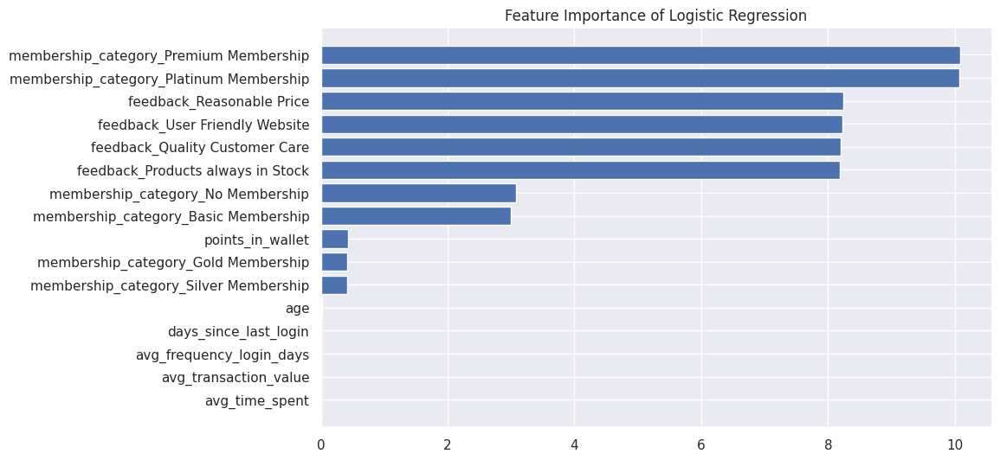

In [ ]:
# Create a bar plot to visualize feature importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_0.index, feature_importance_0["Importance"])
#plt.xlabel("Feature Importances")
#plt.ylabel("Features")
plt.title("Feature Importance of Logistic Regression")
plt.gca().invert_yaxis()  # Invert the y-axis to show the most important feature at the top
plt.show()

#SMOTE LGR

In [ ]:
#SMOTE
grid_search_lgr_sm= GridSearchCV(estimator=lgr, param_grid=param_grid_lgr, cv= 5)
grid_search_lgr_sm.fit(X_train_sm, y_train_sm)


GridSearchCV(cv=5, estimator=LogisticRegression(random_state=0),
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10],
                         'penalty': ['l1', 'l2'],
                         'solver': ['liblinear', 'saga']})

In [ ]:
# Print the best parameters and best score
print("Best Parameters:", grid_search_lgr_sm.best_params_)
print("Best Score:", grid_search_lgr_sm.best_score_)

Best Parameters: {'C': 0.001, 'penalty': 'l1', 'solver': 'liblinear'}
Best Score: 0.8698676620291822


In [ ]:
#เลือกพารามิเตอร์ SMOTE ที่ดีที่สุด

                      # Assuming you have the best hyperparameters in best_params_dict
best_params_lgr_sm = {'C': 0.001, 'penalty': 'l1', 'solver': 'liblinear', 'random_state': 0}

# Create a LogisticRegression model with the best hyperparameters
best_model_lgr_sm = LogisticRegression(**best_params_lgr_sm)

In [ ]:
best_model_lgr_sm

LogisticRegression(C=0.001, penalty='l1', random_state=0, solver='liblinear')

In [ ]:
start_time = time.time()
lgr_sm_model = best_model_lgr_sm.fit(X_train_selected, y_train)
end_time = time.time()
training_time = end_time - start_time
print("Training time:", training_time, "seconds")

Training time: 0.026274919509887695 seconds


In [ ]:
lgr_sm_train_pred = lgr_sm_model.predict(X_train_selected)
print(classification_report(y_train, lgr_sm_train_pred))

              precision    recall  f1-score   support

           0       0.89      0.82      0.85     12665
           1       0.85      0.91      0.88     14735

    accuracy                           0.87     27400
   macro avg       0.87      0.87      0.87     27400
weighted avg       0.87      0.87      0.87     27400



In [ ]:
lgr_sm_test_pred = lgr_sm_model.predict(X_test_selected)
print(classification_report(y_test, lgr_sm_test_pred))

              precision    recall  f1-score   support

           0       0.88      0.81      0.85      3104
           1       0.86      0.91      0.88      3746

    accuracy                           0.87      6850
   macro avg       0.87      0.86      0.86      6850
weighted avg       0.87      0.87      0.87      6850



In [ ]:
lgr_sm_test=confusion_matrix(y_test, lgr_sm_test_pred)
lgr_sm_test

array([[2529,  575],
       [ 342, 3404]])

In [ ]:
tn, fp, fn, tp = confusion_matrix(y_test, lgr_sm_test_pred).ravel()

# Print the values
print("True Negative (TN):", tn)
print("False Positive (FP):", fp)
print("False Negative (FN):", fn)
print("True Positive (TP):", tp)

True Negative (TN): 2529
False Positive (FP): 575
False Negative (FN): 342
True Positive (TP): 3404


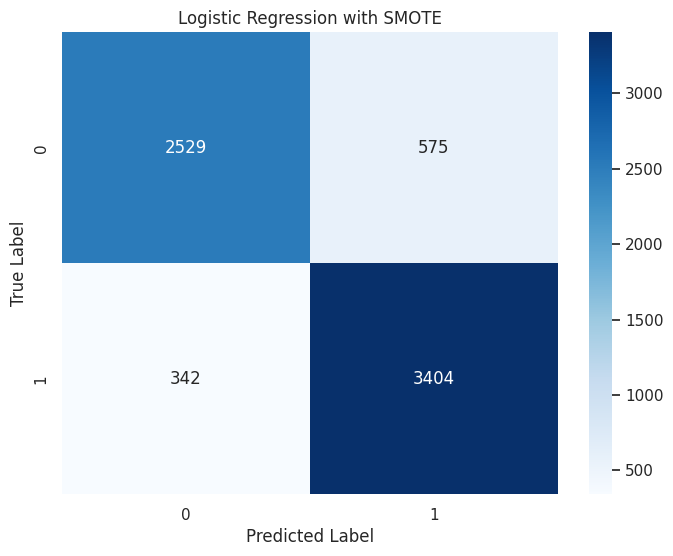

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(lgr_sm_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title("Logistic Regression with SMOTE")
plt.show()

In [ ]:
# หา Feature Importance
# Get the absolute values of the coefficients
coef_abs_1 = np.abs(best_model_lgr_sm.coef_)

# Create a DataFrame to store feature importance
feature_importance_1 = pd.DataFrame(coef_abs_1[0], index=X_train_selected.columns, columns=["Importance"])

# Sort the features by importance in descending order
feature_importance_1 = feature_importance_1.sort_values(by="Importance", ascending=False)

# Display the feature importance
print(feature_importance_1)

                                         Importance
membership_category_Basic Membership       1.237163
membership_category_No Membership          1.235470
membership_category_Premium Membership     0.699443
membership_category_Platinum Membership    0.672711
points_in_wallet                           0.303049
avg_transaction_value                      0.149978
avg_frequency_login_days                   0.010112
membership_category_Gold Membership        0.000000
membership_category_Silver Membership      0.000000
feedback_Products always in Stock          0.000000
feedback_Quality Customer Care             0.000000
feedback_Reasonable Price                  0.000000
feedback_User Friendly Website             0.000000
avg_time_spent                             0.000000
age                                        0.000000
days_since_last_login                      0.000000


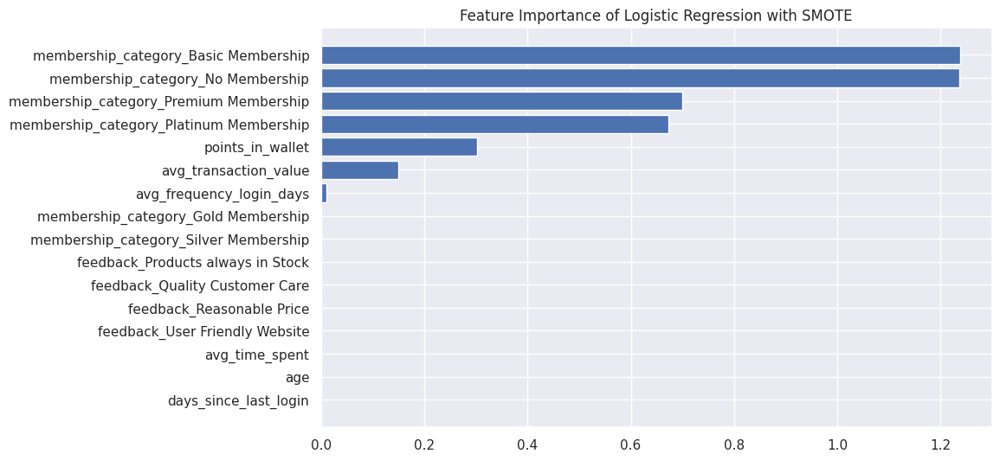

In [ ]:
# Create a bar plot to visualize feature importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_1.index, feature_importance_1["Importance"])
#plt.xlabel("Features Importances")
#plt.ylabel("Features")
plt.title("Feature Importance of Logistic Regression with SMOTE")
plt.gca().invert_yaxis()  # Invert the y-axis to show the most important feature at the top
plt.show()

# GridSearchCV with Support Vector Machine

In [ ]:
from sklearn.svm import SVC

In [ ]:
svm = SVC()

In [ ]:
param_grid_svm = {
    'C': [0.1, 1, 10],  # Regularization parameter
    'kernel': ['linear', 'rbf'],  # Kernel type
    'gamma': [0.001, 0.01, 0.1],  # Kernel coefficient for 'rbf' and 'poly'
}


In [ ]:
# Create a GridSearchCV instance
grid_search_svm = GridSearchCV(estimator=svm, param_grid=param_grid_svm, cv=5)

# Fit the GridSearchCV object to your data
grid_search_svm.fit(X_train_selected, y_train)

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 1, 10], 'gamma': [0.001, 0.01, 0.1],
                         'kernel': ['linear', 'rbf']})

In [ ]:
# Print the best parameters and best score
print("Best Parameters:", grid_search_svm.best_params_)
print("Best Score:", grid_search_svm.best_score_)

Best Parameters: {'C': 10, 'gamma': 0.1, 'kernel': 'rbf'}
Best Score: 0.9217883211678831


In [ ]:
# Assuming you have the best hyperparameters in best_params_
best_params_svm = {'C': 10, 'gamma': 0.1, 'kernel': 'rbf', 'random_state': 0,'probability':True}

# Create a SVC model with the best hyperparameters
best_model_svm = SVC(**best_params_svm)

In [ ]:
best_model_svm

SVC(C=10, gamma=0.1, probability=True, random_state=0)

In [ ]:
start_time = time.time()
svm_model = best_model_svm.fit(X_train_selected, y_train)
end_time = time.time()
training_time = end_time - start_time
print("Training time:", training_time, "seconds")

Training time: 97.98722958564758 seconds


In [ ]:
svm_train_pred = svm_model.predict(X_train_selected)
print(classification_report(y_train, svm_train_pred))

              precision    recall  f1-score   support

           0       0.94      0.91      0.92     12665
           1       0.92      0.95      0.94     14735

    accuracy                           0.93     27400
   macro avg       0.93      0.93      0.93     27400
weighted avg       0.93      0.93      0.93     27400



In [ ]:
svm_test_pred = svm_model.predict(X_test_selected)
print(classification_report(y_test, svm_test_pred))

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3104
           1       0.92      0.93      0.93      3746

    accuracy                           0.92      6850
   macro avg       0.92      0.92      0.92      6850
weighted avg       0.92      0.92      0.92      6850



In [ ]:
svm_test=confusion_matrix(y_test, svm_test_pred)
svm_test

array([[2819,  285],
       [ 261, 3485]])

In [ ]:
tn, fp, fn, tp = confusion_matrix(y_test, svm_test_pred).ravel()

# Print the values
print("True Negative (TN):", tn)
print("False Positive (FP):", fp)
print("False Negative (FN):", fn)
print("True Positive (TP):", tp)

True Negative (TN): 2819
False Positive (FP): 285
False Negative (FN): 261
True Positive (TP): 3485


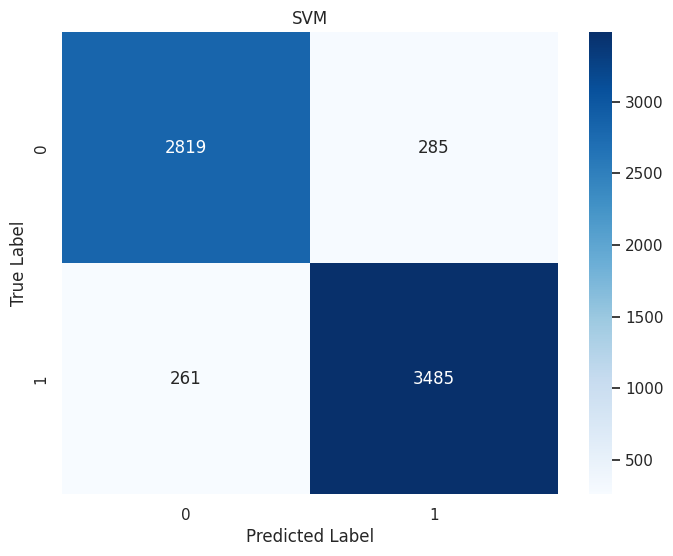

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(svm_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title("SVM")
plt.show()

SVM ด้วย kernel 'rbf' มีหลักการทำงานที่ซับซ้อนและการแยกแยะของข้อมูลที่เชิงเส้นและใช้การคำนวณระหว่าง support vectors และ margin จึงไม่ให้ feature_importance อย่างง่ายดาย แต่คุณยังสามารถทำการวิเคราะห์โดยใช้วิธีอื่น ๆ เพื่อเข้าใจความสำคัญของคุณสมบัติใน SVM ที่ใช้ kernel 'rbf' เช่นดูค่า coefficients ของ support vectors หรือใช้วิธีการจัดกลุ่มคุณสมบัติที่มีค่า coefficients สูงในการเรียนรู้แบบ SVM แล้ววิเคราะห์คุณสมบัติเหล่านั้น

การทำความเข้าใจการทำงานและผลลัพธ์ของ SVM แบบ kernel 'rbf' จำเป็นต้องใช้วิธีการทางคณิตศาสตร์และวิเคราะห์โดยรอบเพื่อหาคำตอบที่ถูกต้องสำหรับงานและข้อมูลที่คุณกำลังจะใช้ หากคุณต้องการความช่วยเหลือในการวิเคราะห์ SVM หรือคำถามเกี่ยวกับการใช้ SVM ในงานของคุณอื่น ๆ โปรดแจ้งมา และฉันยินดีที่จะช่วยเสมอ

In [ ]:
# ดึง coefficients ของคุณสมบัติ
#coefficients_svm = best_model_svm.coef_

# แสดงค่า coefficients
#print(coefficients_svm)

ขออภัยในความสับสนนี้ คุณไม่สามารถใช้ coef_ ใน SVM แบบ kernel 'rbf' เนื่องจาก coef_ มีความหมายเฉพาะสำหรับ SVM แบบ linear kernel เท่านั้น ใน SVM แบบ kernel 'rbf' ไม่มี coefficients เช่นเดียวกับแบบ linear คุณสมบัติแต่ละตัวไม่ได้มีความสำคัญที่มากน้อยแบบเดียวกับ linear SVM แต่แทนที่นี้ kernel 'rbf' ใช้การเรียกใช้ฟังก์ชันระหว่างคุณสมบัติ (จุด) โดยใช้ค่าความคล้ายคลึงระหว่างคุณสมบัติและคุณสมบัติทั้งหมดในข้อมูลเพื่อตัดสินใจในการแบ่งกลุ่ม ดังนั้นคุณไม่สามารถใช้ coef_ เพื่อหาความสำคัญของคุณสมบัติใน SVM แบบ kernel 'rbf' ได้

หากคุณต้องการหาความสำคัญของคุณสมบัติใน SVM แบบ kernel 'rbf' คุณอาจต้องใช้วิธีอื่น ๆ เช่น feature permutation importance หรือ SHAP values ซึ่งเป็นวิธีที่ใช้กันอย่างแพร่หลายในการแปลงความสำคัญของคุณสมบัติในโมเดล SVM แบบ kernel 'rbf'

# SMOTE SVM

In [ ]:
# Create a GridSearchCV instance
grid_search_svm_sm = GridSearchCV(estimator=svm, param_grid=param_grid_svm, cv=5)

# Fit the GridSearchCV object to your data
grid_search_svm_sm.fit(X_train_sm, y_train_sm)

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 1, 10], 'gamma': [0.001, 0.01, 0.1],
                         'kernel': ['linear', 'rbf']})

In [ ]:
# Print the best parameters and best score
print("Best Parameters:", grid_search_svm_sm.best_params_)
print("Best Score:", grid_search_svm_sm.best_score_)

Best Parameters: {'C': 10, 'gamma': 0.1, 'kernel': 'rbf'}
Best Score: 0.9209026128266034


In [ ]:
# Assuming you have the best hyperparameters in best_params_dict
best_params_svm_sm = {'C': 10, 'gamma': 0.1, 'kernel': 'rbf', 'random_state': 0,'probability':True}

# Create a LogisticRegression model with the best hyperparameters
best_model_svm_sm = SVC(**best_params_svm_sm)

In [ ]:
best_model_svm_sm

SVC(C=10, gamma=0.1, probability=True, random_state=0)

In [ ]:
start_time = time.time()
svm_sm_model = best_model_svm_sm.fit(X_train_selected, y_train)
end_time = time.time()
training_time = end_time - start_time
print("Training time:", training_time, "seconds")

Training time: 98.36422109603882 seconds


In [ ]:
svm_sm_train_pred = svm_sm_model.predict(X_train_selected)
print(classification_report(y_train, svm_sm_train_pred))

              precision    recall  f1-score   support

           0       0.94      0.91      0.92     12665
           1       0.92      0.95      0.94     14735

    accuracy                           0.93     27400
   macro avg       0.93      0.93      0.93     27400
weighted avg       0.93      0.93      0.93     27400



In [ ]:
svm_sm_test_pred = svm_sm_model.predict(X_test_selected)
print(classification_report(y_test, svm_sm_test_pred))

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3104
           1       0.92      0.93      0.93      3746

    accuracy                           0.92      6850
   macro avg       0.92      0.92      0.92      6850
weighted avg       0.92      0.92      0.92      6850



In [ ]:
svm_sm_test=confusion_matrix(y_test, svm_sm_test_pred)
svm_sm_test

array([[2819,  285],
       [ 261, 3485]])

In [ ]:
tn, fp, fn, tp = confusion_matrix(y_test, svm_sm_test_pred).ravel()

# Print the values
print("True Negative (TN):", tn)
print("False Positive (FP):", fp)
print("False Negative (FN):", fn)
print("True Positive (TP):", tp)

True Negative (TN): 2819
False Positive (FP): 285
False Negative (FN): 261
True Positive (TP): 3485


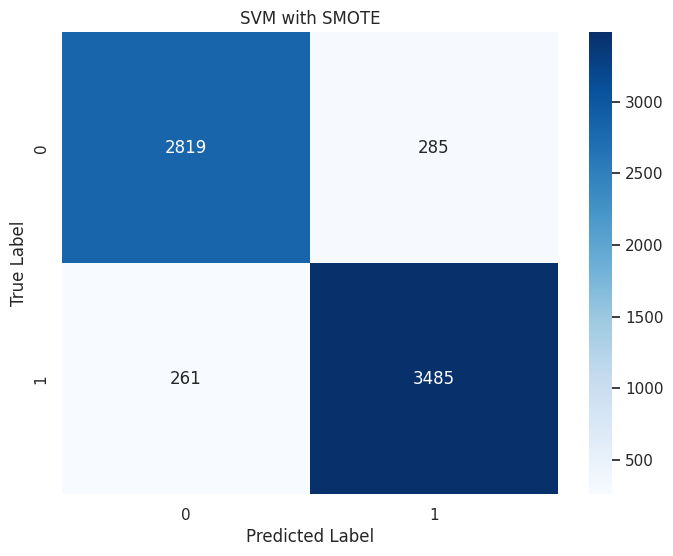

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(svm_sm_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title("SVM with SMOTE")
plt.show()

#GridSearchCV with RF

In [ ]:
rfc=RandomForestClassifier(random_state=42)

In [ ]:
# Define the hyperparameters for grid search
param_grid_rfc = {
    'n_estimators': [200, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [4,5,6,7,8],
    'criterion' :['gini', 'entropy']
}

In [ ]:
grid_search_rfc= GridSearchCV(estimator=rfc, param_grid=param_grid_rfc, cv= 5)
grid_search_rfc.fit(X_train_selected, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 5, 6, 7, 8],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [200, 500]})

In [ ]:
print("Best parameters: ", grid_search_rfc.best_params_)
print("Best score: ", grid_search_rfc.best_score_)

Best parameters:  {'criterion': 'entropy', 'max_depth': 8, 'max_features': 'auto', 'n_estimators': 200}
Best score:  0.9289416058394162


In [ ]:
# Assuming you have the best hyperparameters in best_params_dict
best_params_rfc = {'criterion': 'entropy', 'max_depth': 8, 'max_features': 'auto', 'n_estimators': 200, 'random_state': 0}

# Create a LogisticRegression model with the best hyperparameters
best_model_rfc = RandomForestClassifier(**best_params_rfc)

In [ ]:
best_model_rfc

RandomForestClassifier(criterion='entropy', max_depth=8, max_features='auto',
                       n_estimators=200, random_state=0)

In [ ]:
start_time = time.time()
rfc_model = best_model_rfc.fit(X_train_selected, y_train)
end_time = time.time()
training_time = end_time - start_time
print("Training time:", training_time, "seconds")

Training time: 7.50370717048645 seconds


In [ ]:
rfc_train_pred = rfc_model.predict(X_train_selected)
print(classification_report(y_train, rfc_train_pred))

              precision    recall  f1-score   support

           0       0.93      0.91      0.92     12665
           1       0.93      0.94      0.93     14735

    accuracy                           0.93     27400
   macro avg       0.93      0.93      0.93     27400
weighted avg       0.93      0.93      0.93     27400



In [ ]:
rfc_test_pred = rfc_model.predict(X_test_selected)
print(classification_report(y_test, rfc_test_pred))

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3104
           1       0.93      0.93      0.93      3746

    accuracy                           0.92      6850
   macro avg       0.92      0.92      0.92      6850
weighted avg       0.92      0.92      0.92      6850



In [ ]:
rfc_test=confusion_matrix(y_test, rfc_test_pred)
rfc_test

array([[2826,  278],
       [ 249, 3497]])

In [ ]:
tn, fp, fn, tp = confusion_matrix(y_test, rfc_test_pred).ravel()

# Print the values
print("True Negative (TN):", tn)
print("False Positive (FP):", fp)
print("False Negative (FN):", fn)
print("True Positive (TP):", tp)

True Negative (TN): 2826
False Positive (FP): 278
False Negative (FN): 249
True Positive (TP): 3497


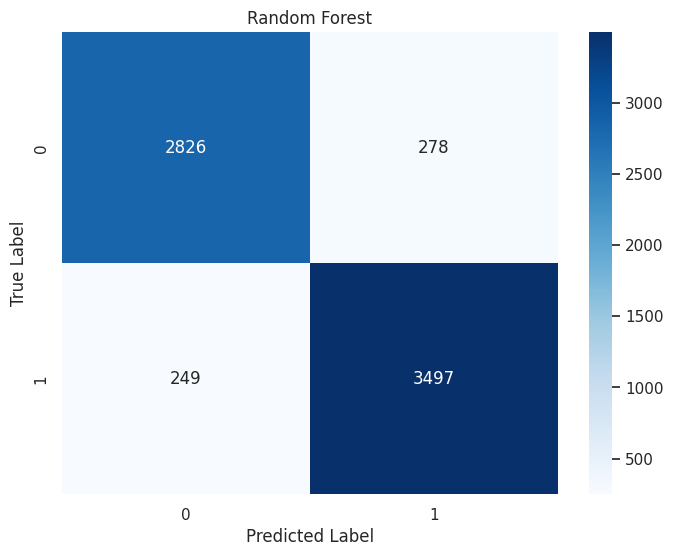

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(rfc_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title("Random Forest")
plt.show()

In [ ]:
# หา Feature Importance
feature_importance1 = pd.DataFrame(rfc_model.feature_importances_,
                                  index=X_train_selected.columns,
                                  columns=["Importance"]).sort_values("Importance", ascending=False)
feature_importance1

,Importance
points_in_wallet,0.351770
membership_category_No Membership,0.159032
membership_category_Basic Membership,0.157474
membership_category_Platinum Membership,0.101284
membership_category_Premium Membership,0.100561
avg_transaction_value,0.044378
membership_category_Gold Membership,0.016917
membership_category_Silver Membership,0.015757
feedback_User Friendly Website,0.011844
feedback_Products always in Stock,0.011754


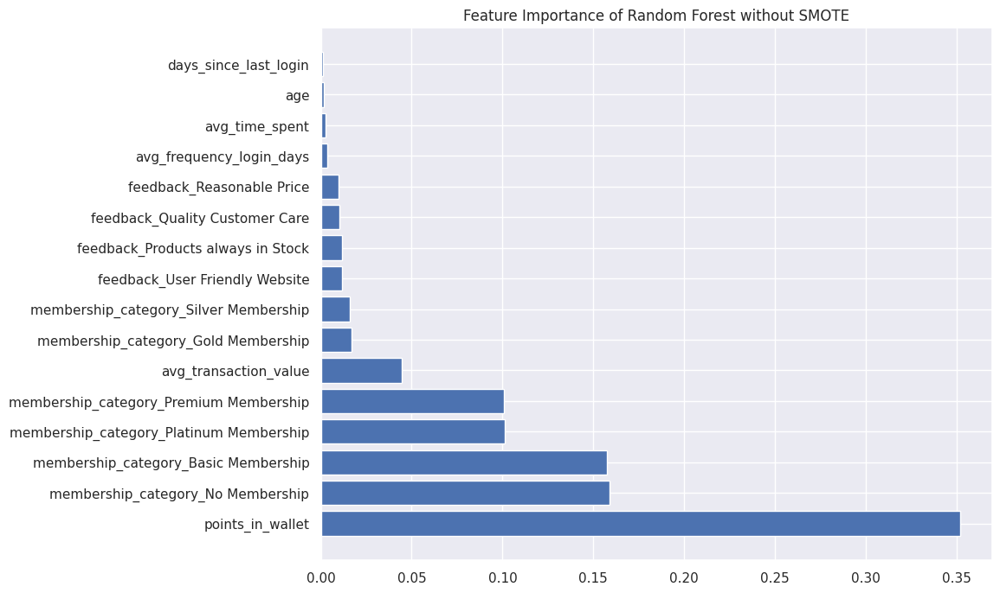

In [ ]:
# สร้าง DataFrame เพื่อเก็บ Feature Importance
feature_importance_df_rf = pd.DataFrame({
    'Features': X_train_selected.columns,
    'Importance': rfc_model.feature_importances_
})

# เรียงลำดับ Feature Importance จากมากไปน้อย
feature_importance_df_rf = feature_importance_df_rf.sort_values(by='Importance', ascending=False)

# สร้าง plot แสดง Features Importance 20 อันดับแรก
top_n = 20
plt.figure(figsize=(10, 8))
plt.barh(feature_importance_df_rf['Features'][:top_n], feature_importance_df_rf['Importance'][:top_n])
#plt.xlabel('Importance')
#plt.ylabel('Features')
plt.title('Feature Importance of Random Forest without SMOTE')
plt.show()

#RF SMOTE

In [ ]:
# Create a GridSearchCV instance
grid_search_rfc_sm = GridSearchCV(estimator=rfc, param_grid=param_grid_rfc, cv= 5)

# Fit the GridSearchCV object to your data
grid_search_rfc_sm.fit(X_train_sm, y_train_sm)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 5, 6, 7, 8],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [200, 500]})

In [ ]:
# Print the best parameters and best score
print("Best Parameters:", grid_search_rfc_sm.best_params_)
print("Best Score:", grid_search_rfc_sm.best_score_)

Best Parameters: {'criterion': 'gini', 'max_depth': 8, 'max_features': 'auto', 'n_estimators': 200}
Best Score: 0.9287410926365794


In [ ]:
# Assuming you have the best hyperparameters in best_params_dict
best_params_rfc_sm = {'criterion': 'gini', 'max_depth': 8, 'max_features': 'auto', 'n_estimators': 200, 'random_state': 0}

# Create a LogisticRegression model with the best hyperparameters
best_model_rfc_sm = RandomForestClassifier(**best_params_rfc_sm)


In [ ]:
best_model_rfc_sm

RandomForestClassifier(max_depth=8, max_features='auto', n_estimators=200,
                       random_state=0)

In [ ]:

start_time = time.time()
rfc_sm_model = best_model_rfc_sm.fit(X_train_selected, y_train)
end_time = time.time()
training_time = end_time - start_time
print("Training time:", training_time, "seconds")

Training time: 6.5358922481536865 seconds


In [ ]:
rfc_sm_train_pred = rfc_sm_model.predict(X_train_selected)
print(classification_report(y_train, rfc_sm_train_pred))

              precision    recall  f1-score   support

           0       0.93      0.91      0.92     12665
           1       0.93      0.94      0.93     14735

    accuracy                           0.93     27400
   macro avg       0.93      0.93      0.93     27400
weighted avg       0.93      0.93      0.93     27400



In [ ]:
rfc_sm_test_pred = rfc_sm_model.predict(X_test_selected)
print(classification_report(y_test, rfc_sm_test_pred))

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3104
           1       0.93      0.93      0.93      3746

    accuracy                           0.92      6850
   macro avg       0.92      0.92      0.92      6850
weighted avg       0.92      0.92      0.92      6850



In [ ]:
rfc_sm_test=confusion_matrix(y_test, rfc_sm_test_pred)
rfc_sm_test


array([[2825,  279],
       [ 249, 3497]])

In [ ]:

tn, fp, fn, tp = confusion_matrix(y_test, rfc_sm_test_pred).ravel()

# Print the values
print("True Negative (TN):", tn)
print("False Positive (FP):", fp)
print("False Negative (FN):", fn)
print("True Positive (TP):", tp)


True Negative (TN): 2825
False Positive (FP): 279
False Negative (FN): 249
True Positive (TP): 3497


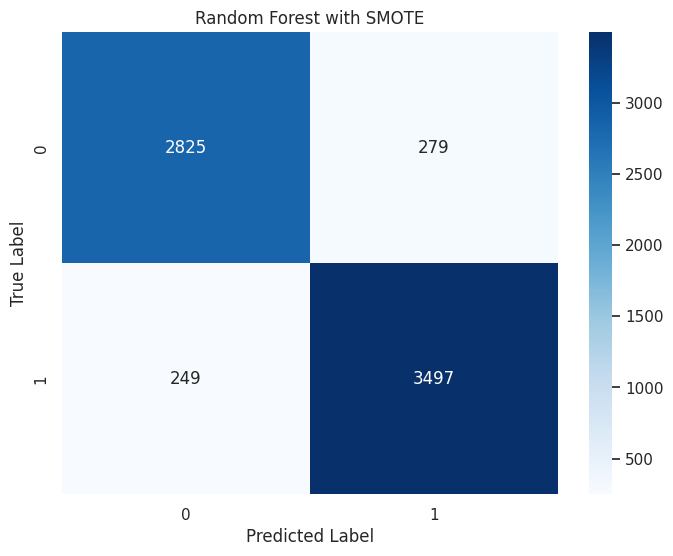

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(rfc_sm_test, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title("Random Forest with SMOTE")
plt.show()

In [ ]:
# หา Feature Importance
feature_importance2 = pd.DataFrame(rfc_sm_model.feature_importances_,
                                  index=X_train_selected.columns,
                                  columns=["Importance"]).sort_values("Importance", ascending=False)
feature_importance2

,Importance
points_in_wallet,0.395838
membership_category_Basic Membership,0.152916
membership_category_No Membership,0.152684
membership_category_Premium Membership,0.092073
membership_category_Platinum Membership,0.089999
avg_transaction_value,0.039846
membership_category_Gold Membership,0.017202
membership_category_Silver Membership,0.014107
feedback_Products always in Stock,0.011300
feedback_User Friendly Website,0.010573


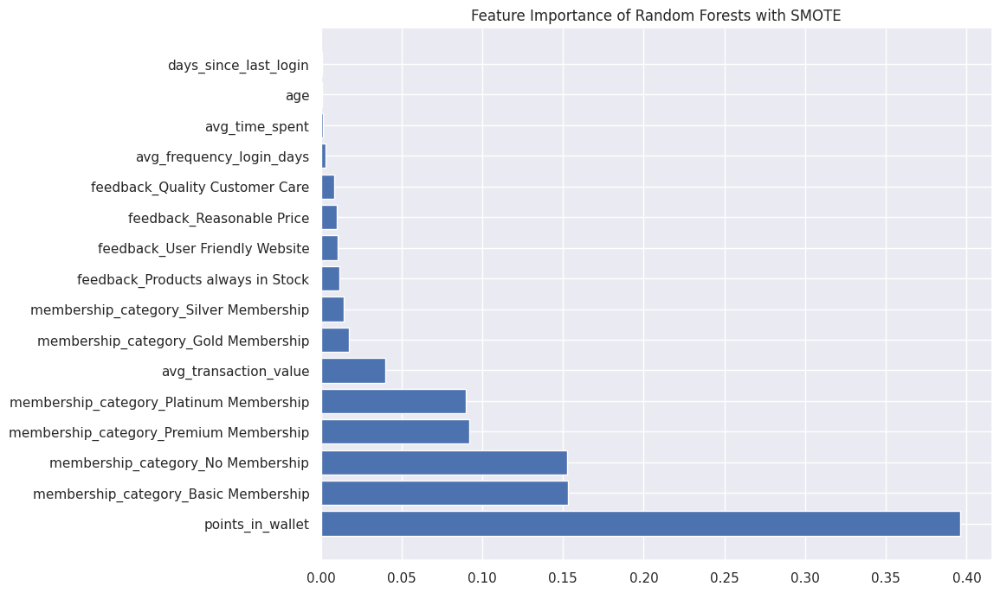

In [ ]:
# สร้าง DataFrame เพื่อเก็บ Feature Importance
feature_importance_df_rf_sm = pd.DataFrame({
    'Features': X_train_selected.columns,
    'Importance': rfc_sm_model.feature_importances_
})

# เรียงลำดับ Feature Importance จากมากไปน้อย
feature_importance_df_rf_sm = feature_importance_df_rf_sm.sort_values(by='Importance', ascending=False)

# สร้าง plot แสดง Features Importance 20 อันดับแรก
top_n = 20
plt.figure(figsize=(10, 8))
plt.barh(feature_importance_df_rf_sm['Features'][:top_n], feature_importance_df_rf_sm['Importance'][:top_n])
#plt.xlabel('Importance')
#plt.ylabel('Features')
plt.title('Feature Importance of Random Forests with SMOTE')
plt.show()

สรุป

In [ ]:
# คำนวณความแม่นยำของ Random Forest Classifier บนชุดข้อมูลการทดสอบ
accuracy_random_forest = accuracy_score(y_test, rfc_test_pred)
accuracy_random_forest_sm = accuracy_score(y_test, rfc_sm_test_pred)

accuracy_svm = accuracy_score(y_test, svm_test_pred)
accuracy_svm_sm = accuracy_score(y_test, svm_sm_test_pred)

accuracy_logistic_regression = accuracy_score(y_test, lgr_test_pred)
accuracy_logistic_regression_sm = accuracy_score(y_test, lgr_sm_test_pred)

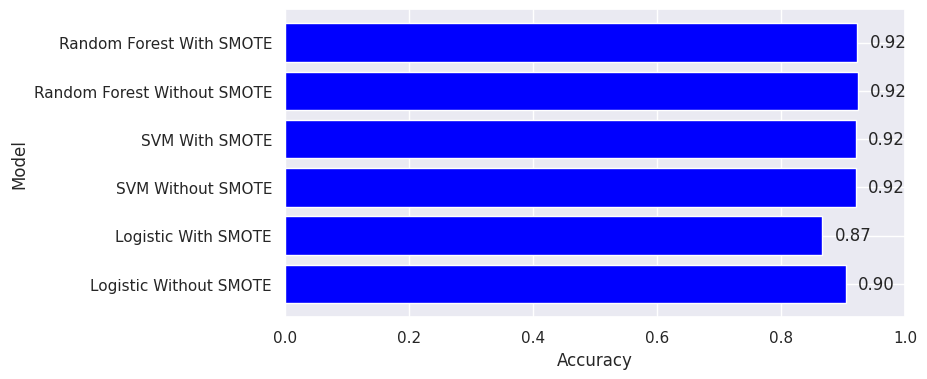

In [ ]:
# สร้างรายงานความแม่นยำสำหรับแต่ละโมเดล
accuracy_report = {
    'Logistic Without SMOTE': accuracy_logistic_regression,
    'Logistic With SMOTE': accuracy_logistic_regression_sm,
    'SVM Without SMOTE': accuracy_svm,
    'SVM With SMOTE': accuracy_svm_sm,
    'Random Forest Without SMOTE': accuracy_random_forest,
    'Random Forest With SMOTE': accuracy_random_forest_sm,
}

# ดึงชื่อโมเดลและค่าความแม่นยำ
models = list(accuracy_report.keys())
accuracy_values = list(accuracy_report.values())

# สร้างกราฟแท่งแนวนอน
plt.figure(figsize=(8, 4))
plt.barh(models, accuracy_values, color=['blue'])
plt.xlim(0, 1)  # ตั้งช่วงแกน x ระหว่าง 0 ถึง 1
plt.xlabel('Accuracy')
plt.ylabel('Model')
#plt.title('Model Comparison - Accuracy')

# แสดงค่าความแม่นยำที่แสดงทศนิยม 2 ตำแหน่ง
for i, v in enumerate(accuracy_values):
    plt.text(v + 0.02, i, f'{v:.2f}', va='center')

plt.show()


In [ ]:
from sklearn.metrics import precision_score
precision_random_forest = precision_score(y_test, rfc_test_pred)

precision_random_forest_sm = precision_score(y_test, rfc_sm_test_pred)

precision_svm = precision_score(y_test, svm_test_pred)

precision_svm_sm = precision_score(y_test, svm_sm_test_pred)

precision_logistic_regression = precision_score(y_test, lgr_test_pred)

precision_logistic_regression_sm = precision_score(y_test, lgr_sm_test_pred)

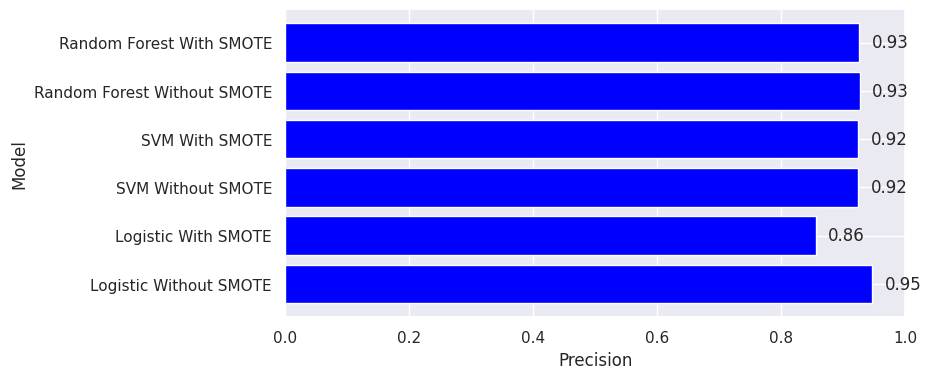

In [ ]:
# สร้างรายงานความแม่นยำสำหรับแต่ละโมเดล
precision_report = {
    'Logistic Without SMOTE': precision_logistic_regression,
    'Logistic With SMOTE': precision_logistic_regression_sm,
    'SVM Without SMOTE': precision_svm,
    'SVM With SMOTE': precision_svm_sm,
    'Random Forest Without SMOTE': precision_random_forest,
    'Random Forest With SMOTE': precision_random_forest_sm,
}

# ดึงชื่อโมเดลและค่า Precision
models = list(precision_report.keys())
precision_values = list(precision_report.values())

# สร้างกราฟแท่งแนวนอน
plt.figure(figsize=(8, 4))
plt.barh(models, precision_values, color=['blue'])
plt.xlim(0, 1)  # ตั้งช่วงแกน x ระหว่าง 0 ถึง 1
plt.xlabel('Precision')
plt.ylabel('Model')

# แสดงค่า Precision ที่แสดงทศนิยม 2 ตำแหน่ง
for i, v in enumerate(precision_values):
    plt.text(v + 0.02, i, f'{v:.2f}', va='center')

plt.show()


In [ ]:
# คำนวณความ recall บนชุดข้อมูลการทดสอบ
from sklearn.metrics import recall_score
recall_random_forest = recall_score(y_test, rfc_test_pred)

recall_random_forest_sm = recall_score(y_test, rfc_sm_test_pred)

recall_svm = recall_score(y_test, svm_test_pred)

recall_svm_sm = recall_score(y_test, svm_sm_test_pred)

recall_logistic_regression = recall_score(y_test, lgr_test_pred)

recall_logistic_regression_sm = recall_score(y_test, lgr_sm_test_pred)


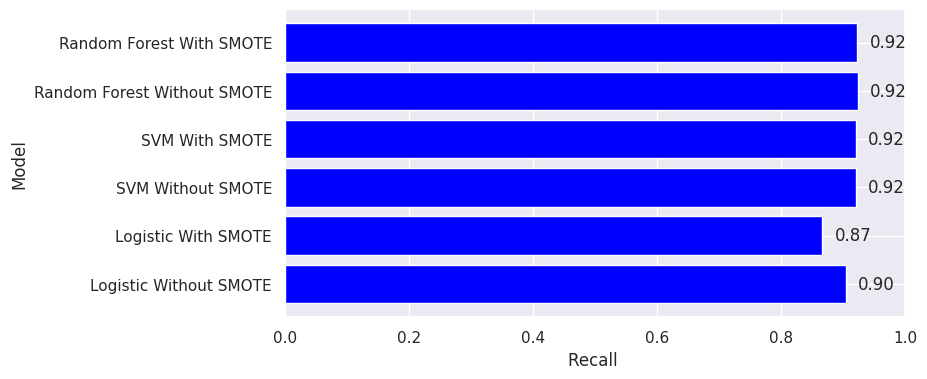

In [ ]:
# สร้างรายงานความแม่นยำสำหรับแต่ละโมเดล
recall_report  = {
    'Logistic Without SMOTE': recall_random_forest,
    'Logistic With SMOTE': recall_random_forest_sm,
    'SVM Without SMOTE': recall_svm,
    'SVM With SMOTE': recall_svm_sm,
    'Random Forest Without SMOTE': accuracy_random_forest,
    'Random Forest With SMOTE': accuracy_random_forest_sm,
}

# ดึงชื่อโมเดลและค่าความแม่นยำ
models = list(accuracy_report.keys())
accuracy_values = list(accuracy_report.values())

# สร้างกราฟแท่งแนวนอน
plt.figure(figsize=(8, 4))
plt.barh(models, accuracy_values, color=['blue'])
plt.xlim(0, 1)  # ตั้งช่วงแกน x ระหว่าง 0 ถึง 1
plt.xlabel('Recall ')
plt.ylabel('Model')


# แสดงค่าความแม่นยำที่แสดงทศนิยม 2 ตำแหน่ง
for i, v in enumerate(accuracy_values):
    plt.text(v + 0.02, i, f'{v:.2f}', va='center')

plt.show()

In [ ]:
from sklearn.metrics import f1_score
f1_score_random_forest = f1_score(y_test, rfc_test_pred)

f1_score_random_forest_sm = f1_score(y_test, rfc_sm_test_pred)

f1_score_svm = f1_score(y_test, svm_test_pred)

f1_score_svm_sm = f1_score(y_test, svm_sm_test_pred)

f1_score_logistic_regression = f1_score(y_test, lgr_test_pred)

f1_score_logistic_regression_sm = f1_score(y_test, lgr_sm_test_pred)


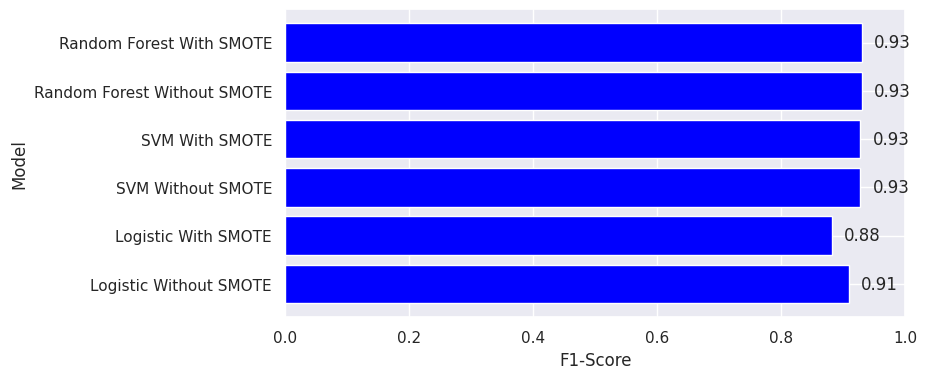

In [ ]:
# สร้างรายงานความแม่นยำสำหรับแต่ละโมเดล
f1_score_report = {
    'Logistic Without SMOTE': f1_score_logistic_regression,
    'Logistic With SMOTE': f1_score_logistic_regression_sm,
    'SVM Without SMOTE': f1_score_svm,
    'SVM With SMOTE': f1_score_svm_sm,
    'Random Forest Without SMOTE': f1_score_random_forest,
    'Random Forest With SMOTE': f1_score_random_forest_sm,
}

# ดึงชื่อโมเดลและค่า F1-Score
models = list(f1_score_report.keys())
f1_score_values = list(f1_score_report.values())

# สร้างกราฟแท่งแนวนอน
plt.figure(figsize=(8, 4))
plt.barh(models, f1_score_values, color=['blue'])
plt.xlim(0, 1)  # ตั้งช่วงแกน x ระหว่าง 0 ถึง 1
plt.xlabel('F1-Score')
plt.ylabel('Model')

# แสดงค่า F1-Score ที่แสดงทศนิยม 2 ตำแหน่ง
for i, v in enumerate(f1_score_values):
    plt.text(v + 0.02, i, f'{v:.2f}', va='center')

plt.show()


#Interpret

In [ ]:
churn_risk_score_125 = test_df['churn_risk_score'].iloc[124]
print(churn_risk_score_125)

#0คืออยู่  1คือออก

1


In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=4d02f161c3fb660770d422c0dec2bec5f0935eebdbed7fe5debfc86405a51190
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer_1 = lime.lime_tabular.LimeTabularExplainer(X_train_selected.values,   mode='classification',
                                                   class_names=['Exist', 'Churn'],
                                                   feature_names=X_train_selected.columns)


In [ ]:
i=124

In [ ]:

exp_lgr124 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, lgr_model.predict_proba, labels=[0])
exp_lgr124.show_in_notebook(show_table=True)

In [ ]:

exp_lgr_sm124= explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, lgr_sm_model.predict_proba, labels=[0])
exp_lgr_sm124.show_in_notebook(show_table=True)

In [ ]:

exp_svm124 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, svm_model.predict_proba, labels=[0])
exp_svm124.show_in_notebook(show_table=True)

#astype(int).values

In [ ]:

exp_svm_sm124 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, svm_sm_model.predict_proba, labels=[0])
exp_svm_sm124.show_in_notebook(show_table=True)

การใช้ LIME เพื่ออธิบายผลลัพธ์ของโมเดล SVM ถูกต้อง แต่อาจจะมีความยากลำบากในการใช้ SVM แบบ kernel rbf ด้วย LIME เนื่องจาก SVM แบบ kernel rbf ไม่รองรับ predict_proba และ LIME มักใช้ predict_proba เพื่อทำความเข้าใจโมเดลมากขึ้น ถ้าคุณต้องการใช้ SVM แบบ kernel rbf และต้องการอธิบายผลลัพธ์ คุณอาจต้องคำนึงถึงวิธีการอื่น ๆ ที่ใช้ในการอธิบายผลลัพธ์ หรือควรพิจารณาใช้โมเดลอื่นที่รองรับ predict_proba ตามที่คุณได้ลองใช้กับ RF และ logistic regression และพบว่ามีปัญหาน้อยลง.

SVM (Support Vector Machine) แบบ kernel 'rbf' (Radial Basis Function) เป็นอัลกอริทึมสำหรับการเรียนรู้เชิงปฏิบัติ (practical machine learning) ที่ใช้ในการจำแนกข้อมูล โดยมีการใช้ Kernel Function ประเภท 'rbf' เป็นการปรับแต่งหรือแปลงข้อมูลให้อยู่ในรูปแบบใหม่เพื่อให้ง่ายต่อการจำแนกข้อมูลในมิติที่สูงขึ้นโดยไม่ต้องเปลี่ยนแปลงข้อมูลจริงๆ และ SVM ก็ใช้ Support Vectors ในการคัดเลือกข้อมูลสำคัญเพื่อตัดสินใจในการจำแนก.

การ Interpret โมเดล SVM แบบ kernel 'rbf' นั้นไม่ได้ง่ายเท่ากับโมเดลอื่นที่มีค่าความสำคัญของคุณสมบัติเหมือนกัน เนื่องจากการทำนายของ SVM 'rbf' ไม่สามารถเรียก predict_proba ได้ง่าย นอกจากนี้ เมื่อใช้ kernel 'rbf' มีการแปลงข้อมูลเป็นมิติสูง ๆ ทำให้ยากต่อการอธิบายและแสดงผลลัพธ์ในรูปแบบที่เข้าใจได้ง่าย.

หากคุณต้องการ Interpret โมเดล SVM แบบ kernel 'rbf' คุณอาจต้องพิจารณาใช้เทคนิคที่ซับซ้อนขึ้น เช่น SHAP (SHapley Additive exPlanations) ซึ่งเป็นเครื่องมือที่ช่วยในการอธิบายผลลัพธ์ของโมเดล แต่ต้องการความปฏิบัติสูงในการใช้งาน. นี่คือตัวอย่าง code ที่ใช้ SHAP ในการ Interpret โมเดล SVM แบบ kernel 'rbf' ที่ถูกสร้างขึ้น:

python

import shap
shap.initjs()

# สร้างโมเดล SVM แบบ kernel 'rbf'
best_params_svm = {'C': 1, 'gamma': 0.1, 'kernel': 'rbf', 'random_state': 0}
best_model_svm = SVC(**best_params_svm)
svm_model = best_model_svm.fit(X_train_selected, y_train)

# สร้าง Explainer
explainer = shap.Explainer(svm_model, X_train_selected)

# Interpret ผลลัพธ์ของข้อมูลที่ต้องการ
i = 124  # เลือกตัวอย่างข้อมูล
shap_values = explainer(X_test_selected.iloc[i,:])
shap.plots.waterfall(shap_values[0])

โดย SHAP จะช่วยในการคำนวณค่า SHAP values ที่แสดงว่าแต่ละคุณสมบัติมีอิทธิพลต่อการตัดสินใจของโมเดลอย่างไร และ shap.plots.waterfall จะแสดงผล SHAP values ในรูปแบบของ waterfall plot เพื่อให้คุณสามารถอธิบายการตัดสินใจของโมเดลได้อย่างชัดเจนมากขึ้น. แต่ต้องทำความเข้าใจว่าการ Interpret โมเดล SVM แบบ kernel 'rbf' อาจจะยากและซับซ้อนเมื่อเทียบกับโมเดลอื่นๆ ที่ใช้ kernel แบบอื่น และการใช้ SHAP อาจต้องการคว


In [ ]:

exp_rfc124 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_model.predict_proba, labels=[0])
exp_rfc124.show_in_notebook(show_table=True)

In [ ]:

exp_rfc_sm124= explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_sm_model.predict_proba, labels=[0])
exp_rfc_sm124.show_in_notebook(show_table=True)

In [ ]:
churn_risk_score_4555 = test_df['churn_risk_score'].iloc[4554]
print(churn_risk_score_4555)

0


lgr_model


lgr_sm_model

svm_model

svm_sm_model

rfc_model

rfc_sm_model

In [ ]:
i=4554

In [ ]:
exp_lgr4554 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, lgr_model.predict_proba, labels=[0])
exp_lgr4554.show_in_notebook(show_table=True)

In [ ]:
exp_lgr_sm4554= explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, lgr_sm_model.predict_proba, labels=[0])
exp_lgr_sm4554.show_in_notebook(show_table=True)

In [ ]:
exp_svm4554 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, svm_model.predict_proba, labels=[0])
exp_svm4554.show_in_notebook(show_table=True)

In [ ]:
exp_svm_sm4554 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, svm_sm_model.predict_proba, labels=[0])
exp_svm_sm4554.show_in_notebook(show_table=True)

In [ ]:
exp_rfc4554 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_model.predict_proba, labels=[0])
exp_rfc4554.show_in_notebook(show_table=True)


In [ ]:

exp_rfc_sm4554 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_sm_model.predict_proba, labels=[0])
exp_rfc_sm4554.show_in_notebook(show_table=True)

ตีความผลลัพธ์ของโมเดล Machine Learning โดยเฉพาะอย่างยิ่งสำหรับโมเดลที่มีการตัดสินใจแบบ Black Box หรือไม่ง่ายต่อการอธิบาย

เลือกโมเดลที่คิดว่าดีที่สุด เลือก Rf มา เพราะงานวิจัย ที่เกี่ยวข้อง บอกว่าดีสุด

In [ ]:
churn_risk_score_246 = test_df['churn_risk_score'].iloc[245]
print(churn_risk_score_246)

1


In [ ]:
i=245

In [ ]:
exp_rfc_245 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_model.predict_proba, labels=[0])
exp_rfc_245.show_in_notebook(show_table=True)

In [ ]:
churn_risk_score_879 = test_df['churn_risk_score'].iloc[878]
print(churn_risk_score_879)

0


In [ ]:
i=878

In [ ]:
exp_rfc_878 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_model.predict_proba, labels=[0])
exp_rfc_878.show_in_notebook(show_table=True)

In [ ]:
churn_risk_score_1784 = test_df['churn_risk_score'].iloc[1783]
print(churn_risk_score_1784)

1


In [ ]:
i=1783

In [ ]:
exp_rfc_1783 = explainer_1.explain_instance(X_test_selected.iloc[i,:].astype(int).values, rfc_model.predict_proba, labels=[0])
exp_rfc_1783.show_in_notebook(show_table=True)

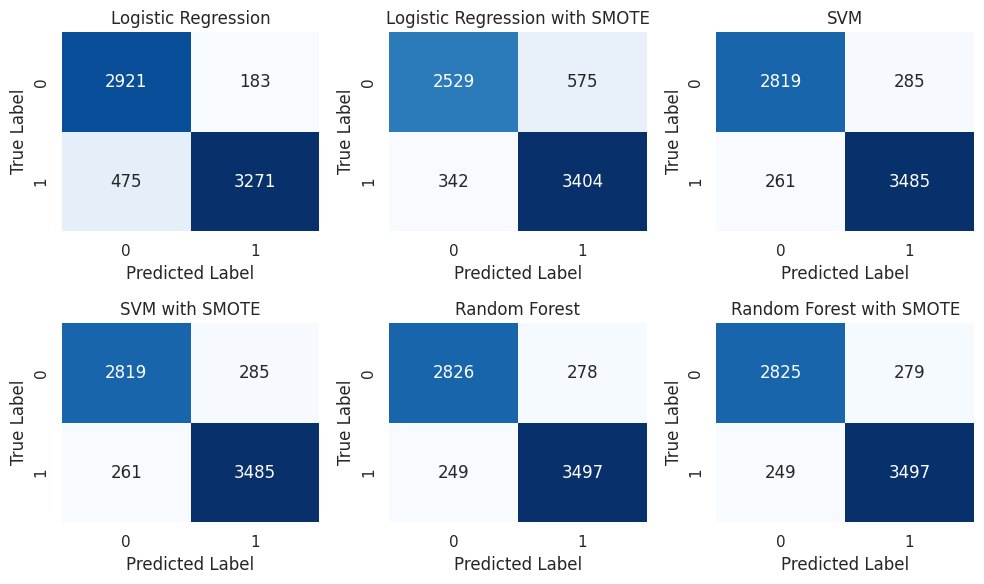

In [ ]:
from sklearn.metrics import confusion_matrix
import numpy as np

# สร้างโมเดลและทดสอบโมเดลที่คุณสนใจ
models = [lgr_model,lgr_sm_model,svm_model,svm_sm_model,rfc_model,rfc_sm_model]  # เปลี่ยนโมเดลตามที่คุณมี
model_names = ["Logistic Regression", "Logistic Regression with SMOTE", "SVM", "SVM with SMOTE", "Random Forest", "Random Forest with SMOTE"]  # ตั้งชื่อโมเดล

# สร้าง Confusion Matrix สำหรับแต่ละโมเดล
confusion_matrices = []
for model in models:
    y_pred = model.predict(X_test_selected)  # X_test เปลี่ยนเป็นชุดข้อมูลทดสอบของคุณ
    cm = confusion_matrix(y_test, y_pred)  # y_test เปลี่ยนเป็นเป้าหมายจริงของคุณ
    confusion_matrices.append(cm)

# แสดง Confusion Matrix ของแต่ละโมเดลในรูปแบบแนวนอน 3x2
fig, axes = plt.subplots(2, 3, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    sns.heatmap(confusion_matrices[i], annot=True, fmt="d", cmap="Blues", cbar=False, ax=ax)
    ax.set_xlabel("Predicted Label")
    ax.set_ylabel("True Label")
    ax.set_title(f"{model_names[i]}")

# ปรับระยะห่างระหว่างกราฟ
plt.tight_layout()
plt.show()

In [ ]:
#file_path1 = '/content/drive/MyDrive/rating/LIME/exp_lgr124.png'  # เลือกชื่อไฟล์ที่คุณต้องการให้มันมี
#exp_lgr124.save_to_file(file_path1)

In [ ]:
#import matplotlib.pyplot as plt

In [ ]:
# สร้างกราฟรูปภาพ
#g_exp_lgr124 = exp_lgr124.as_pyplot_figure()

# บันทึกรูปลงในเครื่อง
#exp_lgr124.save_to_file('/content/drive/MyDrive/rating/LIME/exp_lgr124.png')

In [ ]:
#exp_lgr_sm124.save_to_file('/content/drive/MyDrive/rating/LIME/exp_lgr_sm124.png')

In [ ]:
#exp_svm124.save_to_file('/content/drive/MyDrive/rating/LIME/exp_svm124.png')

In [ ]:
#exp_svm_sm124.save_to_file('/content/drive/MyDrive/rating/LIME/exp_svm_sm124.png')

In [ ]:
#exp_rfc124.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc124.png')

In [ ]:
#exp_rfc_sm124.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc_sm124.png')

In [ ]:
#exp_lgr4554.save_to_file('/content/drive/MyDrive/rating/LIME/exp_lgr4554.png')

In [ ]:
#exp_lgr_sm4554.save_to_file('/content/drive/MyDrive/rating/LIME/exp_lgr_sm4554.png')

In [ ]:
#exp_svm4554.save_to_file('/content/drive/MyDrive/rating/LIME/exp_svm4554.png')

In [ ]:
#exp_svm_sm4554.save_to_file('/content/drive/MyDrive/rating/LIME/exp_svm_sm4554.png')

In [ ]:
#exp_rfc4554.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc4554.png')

In [ ]:
#exp_rfc_sm4554.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc_sm4554.png')

In [ ]:
#exp_rfc_245.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc_245.png')

In [ ]:
#exp_rfc_878.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc_878.png')

In [ ]:
#exp_rfc_1783.save_to_file('/content/drive/MyDrive/rating/LIME/exp_rfc_1783.png')

In [ ]:
# หา Feature Importance
feature_importance_svm = pd.DataFrame(svm_sm_model.feature_importances_,
                                  index=X_train_selected.columns,
                                  columns=["Importance"]).sort_values("Importance", ascending=False)
feature_importance_svm


AttributeError: ignored

In [ ]:
#end